<a href="https://colab.research.google.com/github/Kwaku-code/MSLesSeg/blob/master/MSLSEG.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install tensorflow==2.10.0

In [ ]:
!pip install keras==2.10.0

In [ ]:
!pip install segmentation-models

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
import os
import numpy as np
import nibabel as nib
from sklearn.model_selection import train_test_split
import tensorflow as tf
from tensorflow.keras.utils import to_categorical, Sequence
import matplotlib.pyplot as plt
import random

from tensorflow.keras.losses import binary_crossentropy
from tensorflow.keras.metrics import MeanMetricWrapper
from tensorflow.keras.backend import epsilon

from segmentation_models import Unet
from PIL import Image
from segmentation_models import get_preprocessing

from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.layers import Dropout, Input
from tensorflow.keras.callbacks import ModelCheckpoint, EarlyStopping


from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import img_to_array, array_to_img
from skimage.transform import resize

Segmentation Models: using `keras` framework.


In [ ]:
# Define paths
save_dir = './axial_train'
train_inputs_path = os.path.join(save_dir, 'train_inputs.npy')
train_masks_path = os.path.join(save_dir, 'train_masks.npy')
val_inputs_path = os.path.join(save_dir, 'val_inputs.npy')
val_masks_path = os.path.join(save_dir, 'val_masks.npy')

# Load normalized data
if os.path.exists(train_inputs_path) and os.path.exists(train_masks_path) and os.path.exists(val_inputs_path) and os.path.exists(val_masks_path):
    print("Loading normalized data from saved files...")
    train_inputs = np.load(train_inputs_path)
    train_masks = np.load(train_masks_path)
    val_inputs = np.load(val_inputs_path)
    val_masks = np.load(val_masks_path)
else:
    print("Normalized data not found, processing from slices...")
    # Load and process data here if not already saved
    pass

Loading normalized data from saved files...


Determine class weights

In [ ]:
# Flatten masks for count of pixels
flat_train_masks = train_masks.flatten()

# Count of number of pixels in each class
class_counts = np.bincount(flat_train_masks.astype(int))

# Class frequencies
total_pixels = len(flat_train_masks)
class_frequencies = class_counts / total_pixels

# Class weights as inverse of class frequencies
num_classes = len(class_counts)
class_weights = total_pixels / (num_classes * class_counts)

print(f"Class counts: {class_counts}")
print(f"Class frequencies: {class_frequencies}")
print(f"Class weights: {class_weights}")

Class counts: [81589720   330280]
Class frequencies: [0.99596826 0.00403174]
Class weights: [  0.50202403 124.01598644]


In [ ]:
def dice_coefficient(y_true, y_pred):
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + 1)

def weighted_binary_crossentropy(weights):
    def loss(y_true, y_pred):
        y_true = tf.cast(y_true, tf.float32)
        y_pred = tf.cast(y_pred, tf.float32)
        weights_v = y_true * weights[1] + (1 - y_true) * weights[0]
        binary_crossentropy = tf.keras.backend.binary_crossentropy(y_true, y_pred)
        weighted_loss = weights_v * binary_crossentropy
        return tf.keras.backend.mean(weighted_loss)
    return loss

#class_weights = [0.5, 10.0]

In [ ]:
BACKBONE = 'efficientnetb0'
model = Unet(BACKBONE, input_shape=(128, 128, 2), encoder_weights=None, encoder_freeze=False, classes=1, activation='sigmoid')
# Add dropout layer
dropout = Dropout(0.5)(model.output)
# Compile the model
model.compile('Adam', loss=weighted_binary_crossentropy(class_weights), metrics=[dice_coefficient])

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=False, dpi=64)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.35006 to fit



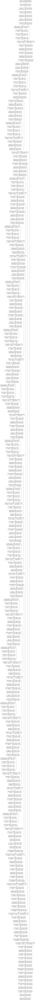

In [ ]:
tf.keras.utils.plot_model(model, to_file='model_plot.png', show_shapes=True, expand_nested=True, dpi=300)

In [ ]:
with Image.open('model_plot.png') as img:
    # Rotate image
    img = img.rotate(90, expand=True)
    # Save image
    img.save('model_plot.png')

**CLASS WEIGHTS [0.50202403, 124.01598644]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb0/2D3Dunet_checkpoint.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.3488 - dice_coefficient: 0.0369
Epoch 1: val_loss improved from inf to 0.58851, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb0/2D3Dunet_checkpoint.h5
312/312 [==============================] - 186s 566ms/step - loss: 0.3488 - dice_coefficient: 0.0369 - val_loss: 0.5885 - val_dice_coefficient: 0.0237
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.2288 - dice_coefficient: 0.0825
Epoch 2: val_loss improved from 0.58851 to 0.26234, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb0/2D3Dunet_checkpoint.h5
312/312 [==============================] - 175s 561ms/step - loss: 0.2288 - dice_coefficient: 0.0825 - val_loss: 0.2623 - val_dice_coefficient: 0.0530
Epoch 3/100
312/312 [==============================] - ETA: 0

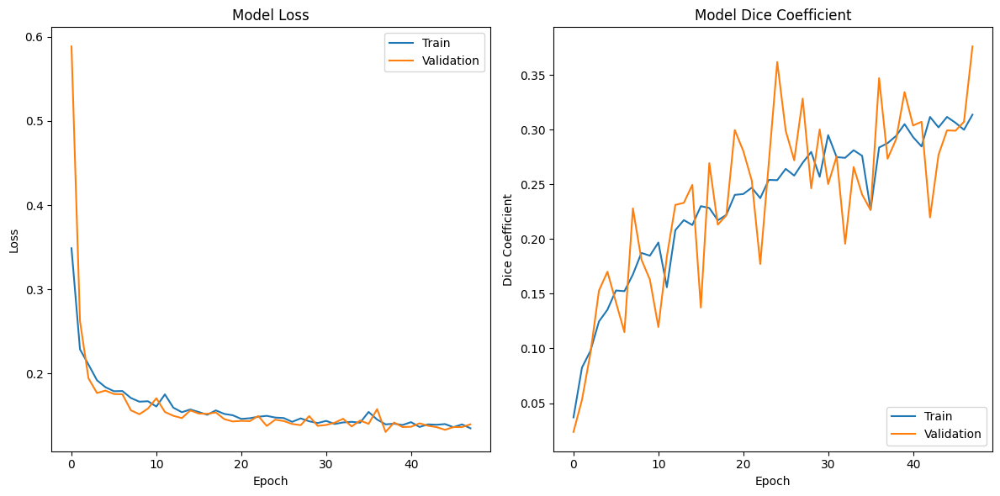

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

Determine the threshold for the sigmoid function

In [ ]:
# Preprocess input and predict functions
def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        combined_image.fill(0)
    return combined_image

def predict_slice(t2_slice, flair_slice, threshold):
    combined_slice = preprocess_input(t2_slice, flair_slice)
    combined_slice = np.expand_dims(combined_slice, axis=0)
    pred_slice = model.predict(combined_slice)
    pred_slice = (pred_slice > threshold).astype(np.float32)
    return pred_slice.squeeze()

# Define the Dice coefficient to ensure the same type for inputs
def dice_coefficient(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + 1)

# Find the best threshold
best_threshold = 0.5
best_dice = 0.0
thresholds = np.arange(0.1, 0.9, 0.1)

for threshold in thresholds:
    dice_scores = []
    for i in range(val_inputs.shape[0]):
        t2_image = val_inputs[i, :, :, 0]
        flair_image = val_inputs[i, :, :, 1]
        ground_truth = val_masks[i, :, :, 0]

        prediction = predict_slice(t2_image, flair_image, threshold)
        dice_score = dice_coefficient(ground_truth, prediction)
        dice_scores.append(dice_score)

    mean_dice = np.mean(dice_scores)
    if mean_dice > best_dice:
        best_dice = mean_dice
        best_threshold = threshold

print(f'Best threshold: {best_threshold} with mean Dice score: {best_dice}')

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 65ms/step
Best threshold: 0.8 with mean Dice score: 0.5265536904335022


**TESTING**

1/1 [==============================] - 0s 64ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnetb0/P69_PRED.nii.gz


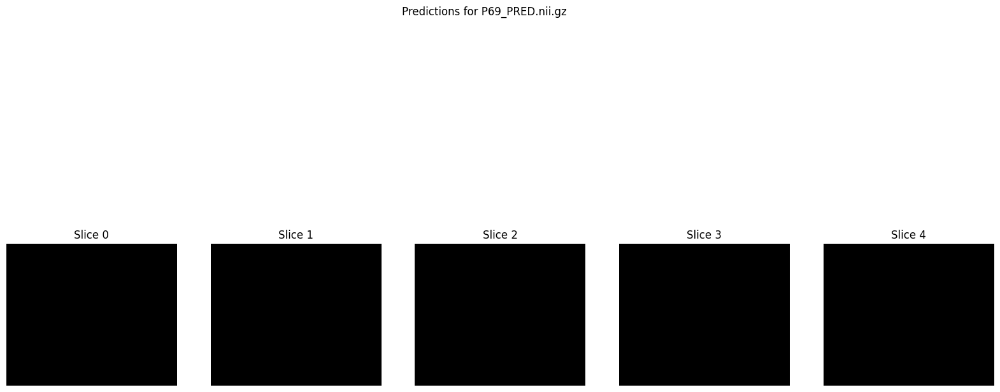

1/1 [==============================] - 0s 70ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnetb0/P54_PRED.nii.gz


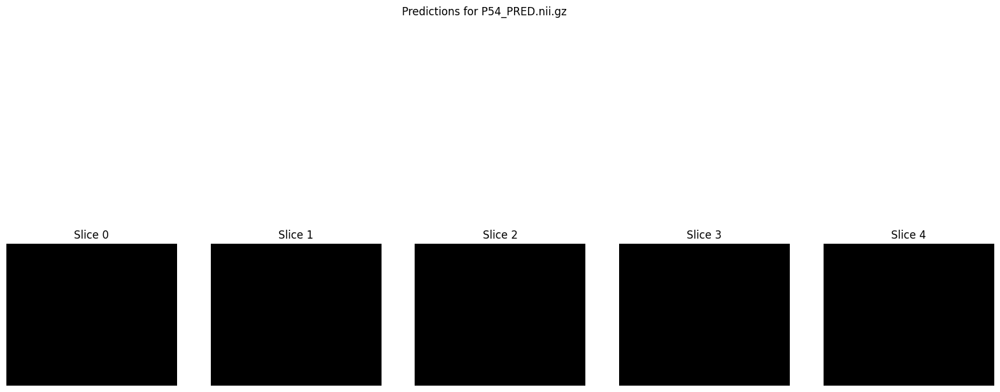

1/1 [==============================] - 0s 67ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnetb0/P55_PRED.nii.gz


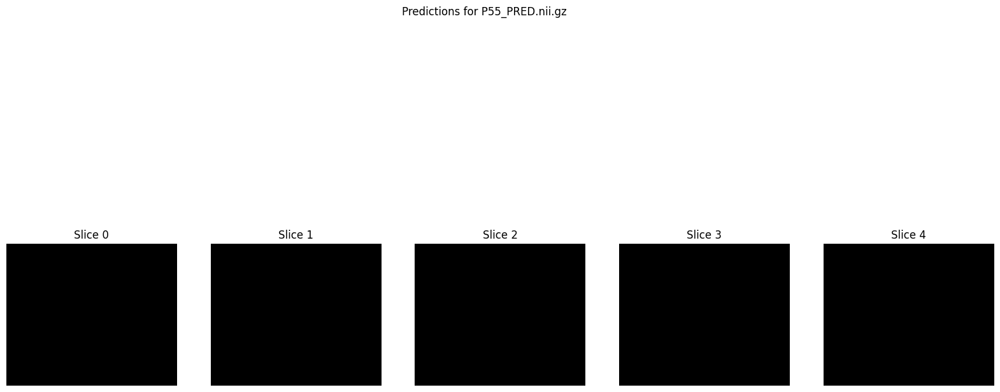

1/1 [==============================] - 0s 71ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnetb0/P56_PRED.nii.gz


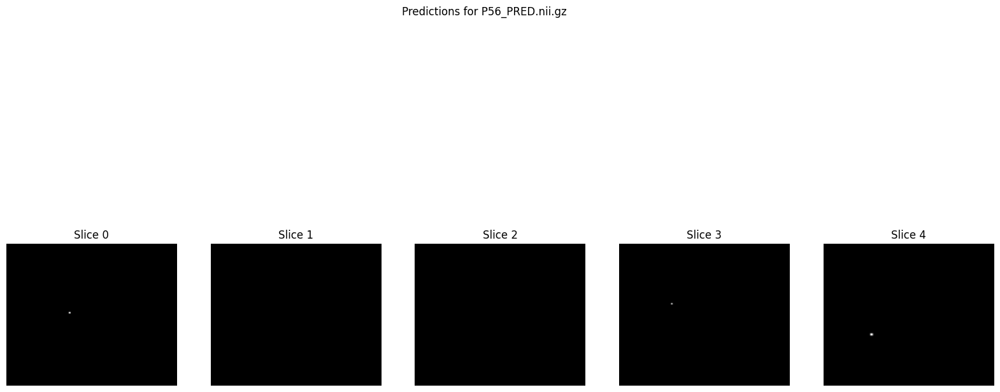

1/1 [==============================] - 0s 63ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnetb0/P57_PRED.nii.gz


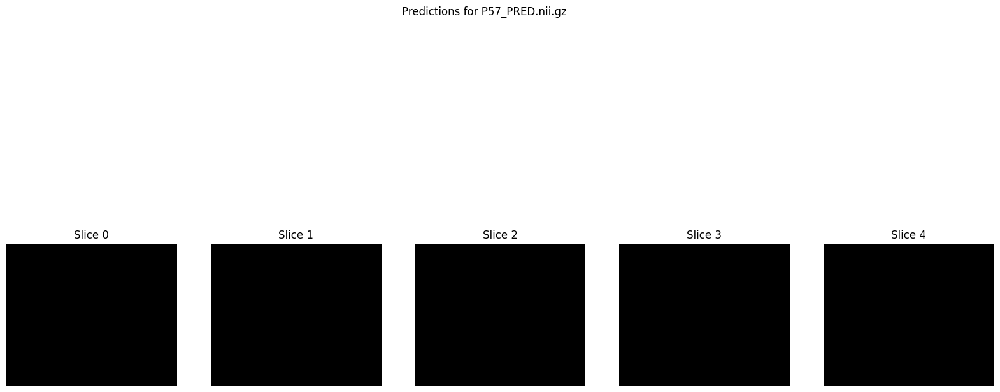

1/1 [==============================] - 0s 63ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnetb0/P58_PRED.nii.gz


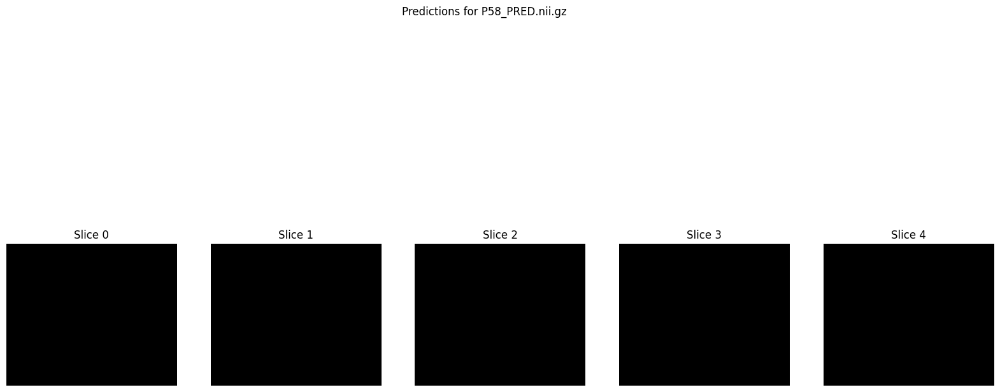

1/1 [==============================] - 0s 67ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnetb0/P59_PRED.nii.gz


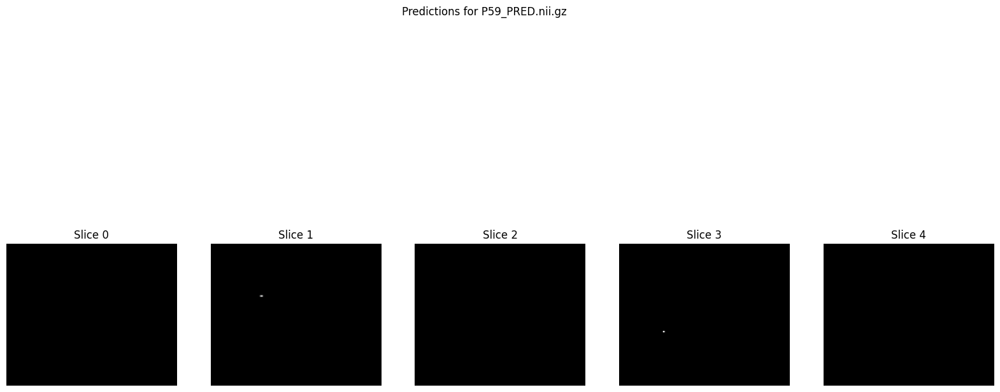

1/1 [==============================] - 0s 69ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSEfficientnetb0/P60_PRED.nii.gz


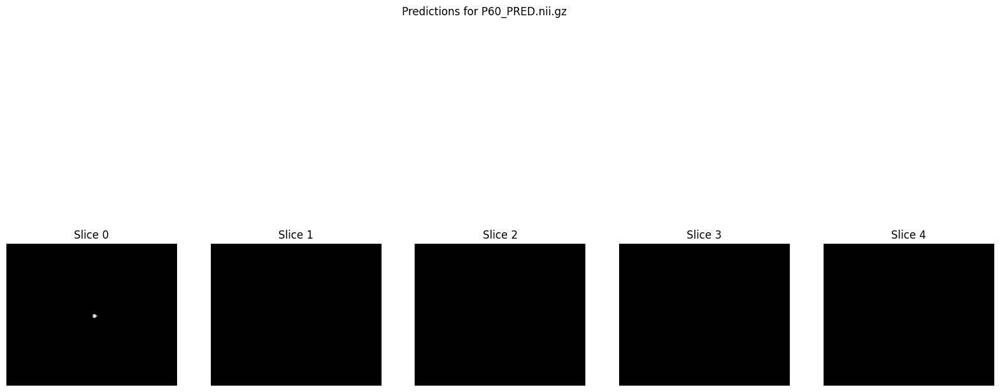

1/1 [==============================] - 0s 67ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSEfficientnetb0/P61_PRED.nii.gz


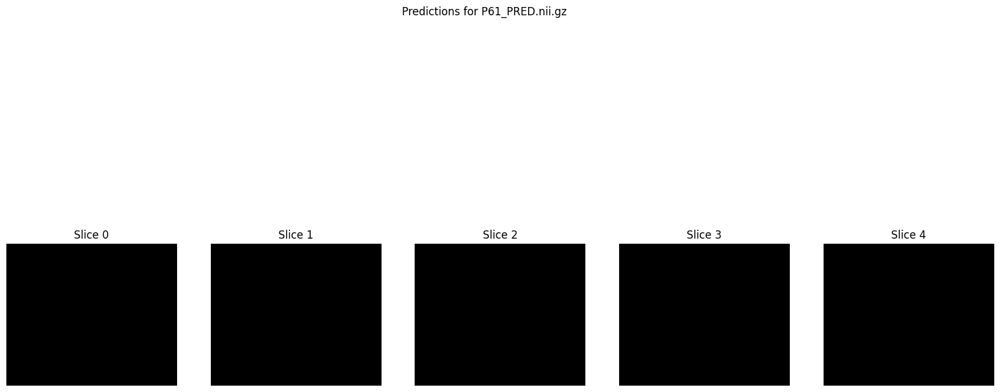

1/1 [==============================] - 0s 69ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSEfficientnetb0/P62_PRED.nii.gz


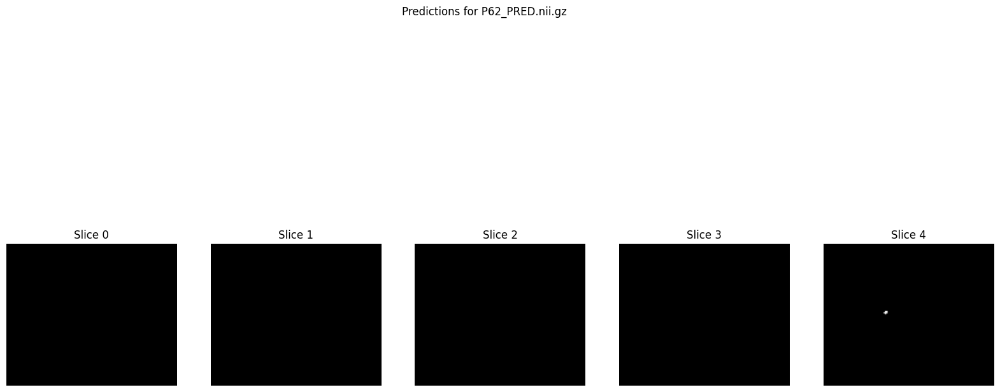

1/1 [==============================] - 0s 64ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSEfficientnetb0/P63_PRED.nii.gz


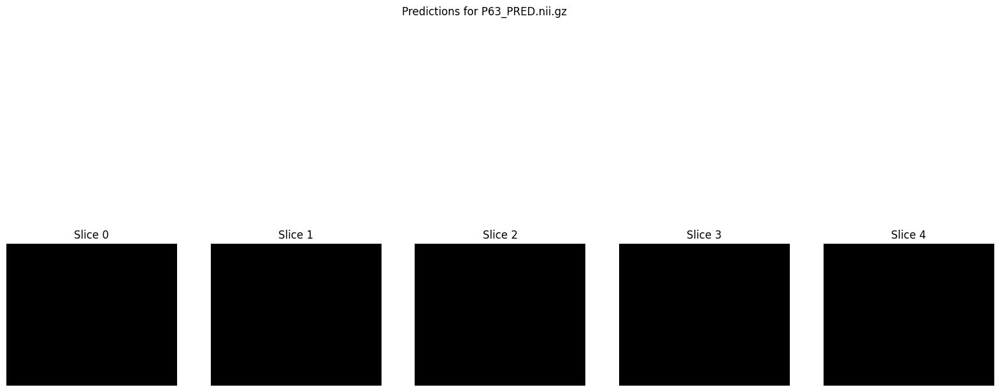

1/1 [==============================] - 0s 64ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSEfficientnetb0/P64_PRED.nii.gz


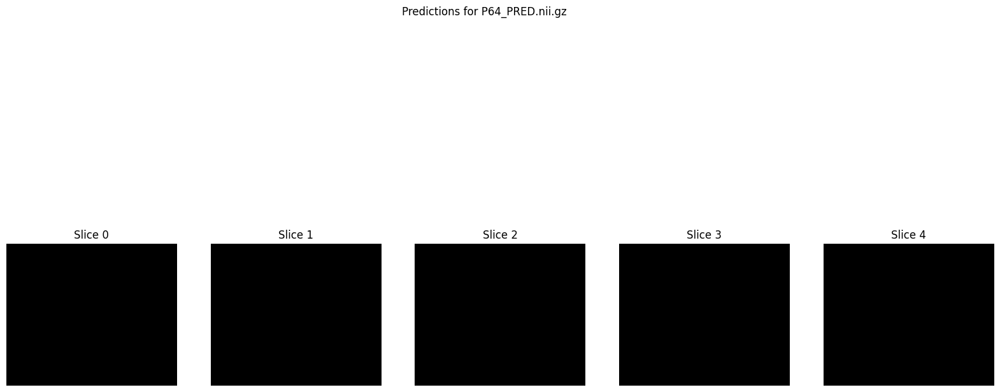

1/1 [==============================] - 0s 65ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSEfficientnetb0/P65_PRED.nii.gz


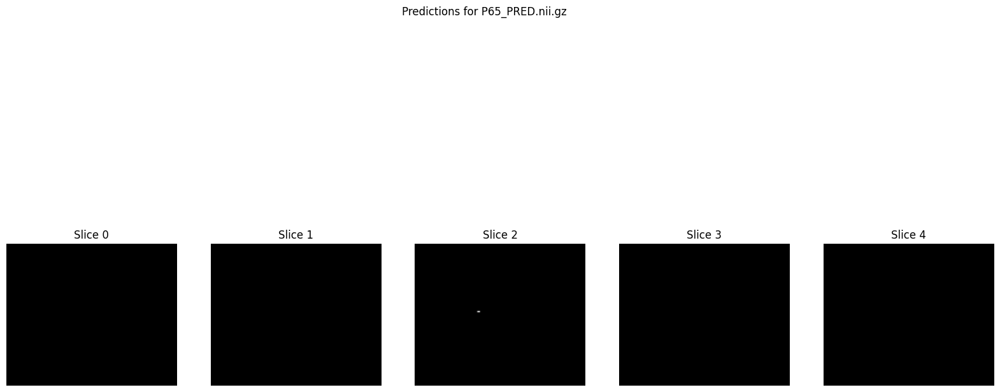

1/1 [==============================] - 0s 66ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSEfficientnetb0/P66_PRED.nii.gz


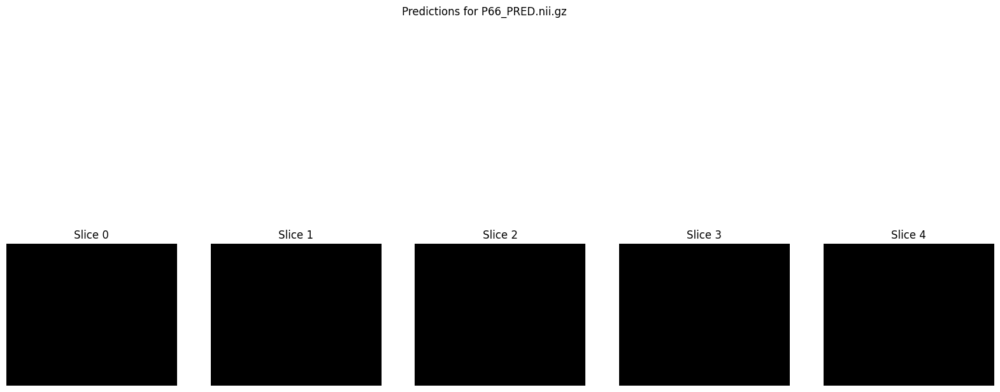

1/1 [==============================] - 0s 67ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSEfficientnetb0/P67_PRED.nii.gz


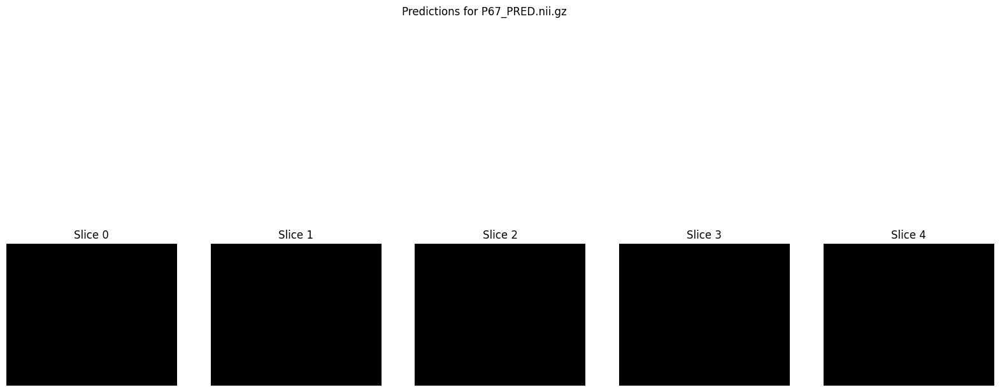

1/1 [==============================] - 0s 67ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSEfficientnetb0/P68_PRED.nii.gz


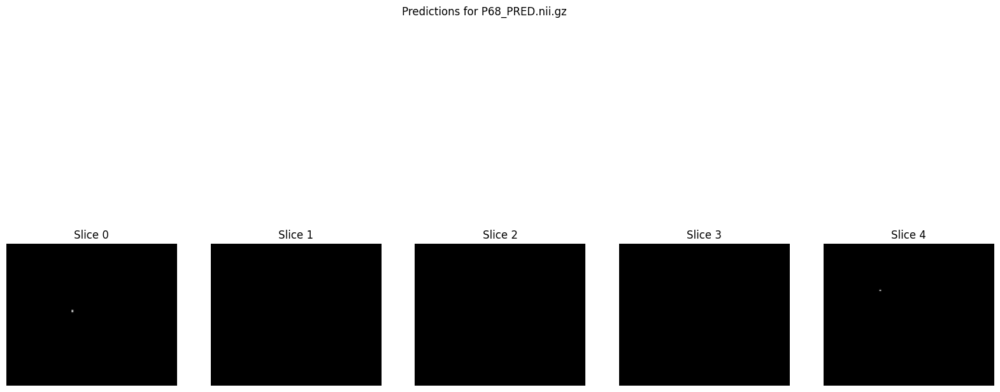

1/1 [==============================] - 0s 65ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSEfficientnetb0/P70_PRED.nii.gz


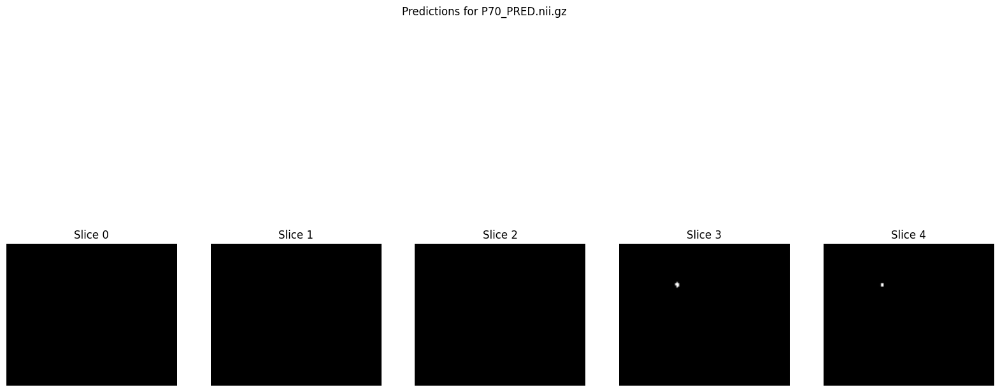

1/1 [==============================] - 0s 66ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSEfficientnetb0/P71_PRED.nii.gz


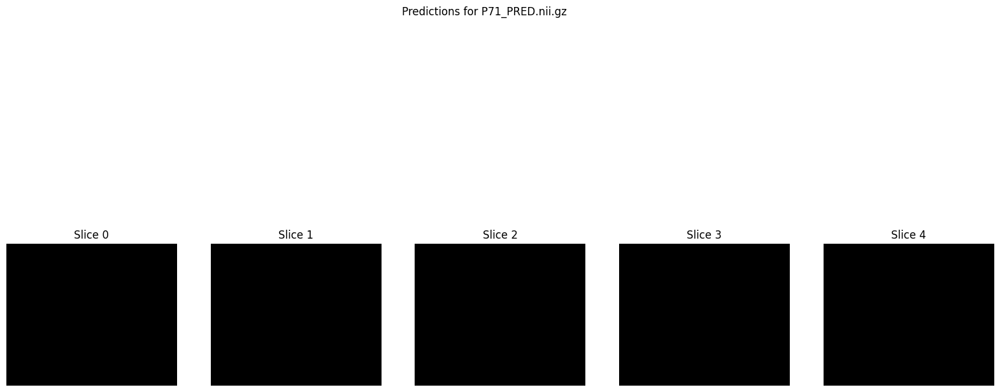

1/1 [==============================] - 0s 68ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSEfficientnetb0/P72_PRED.nii.gz


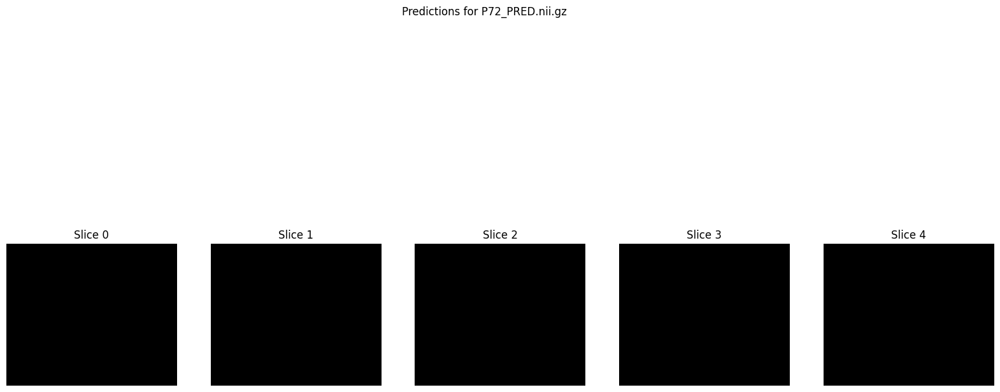

1/1 [==============================] - 0s 67ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSEfficientnetb0/P73_PRED.nii.gz


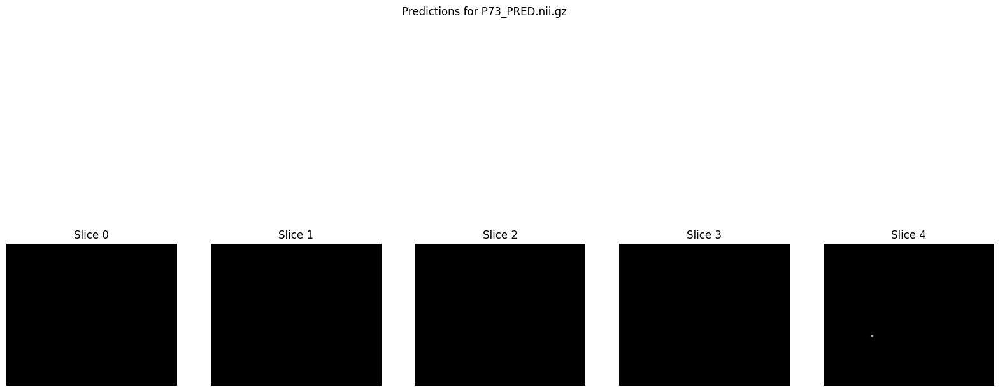

1/1 [==============================] - 0s 71ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSEfficientnetb0/P74_PRED.nii.gz


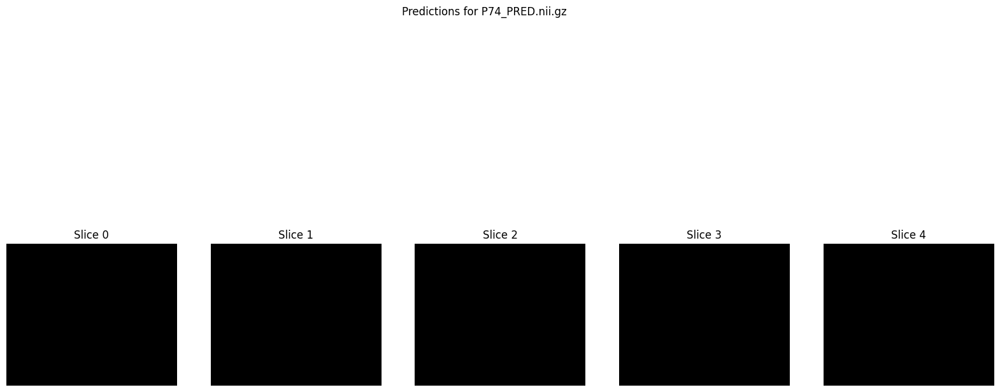

1/1 [==============================] - 0s 63ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSEfficientnetb0/P75_PRED.nii.gz


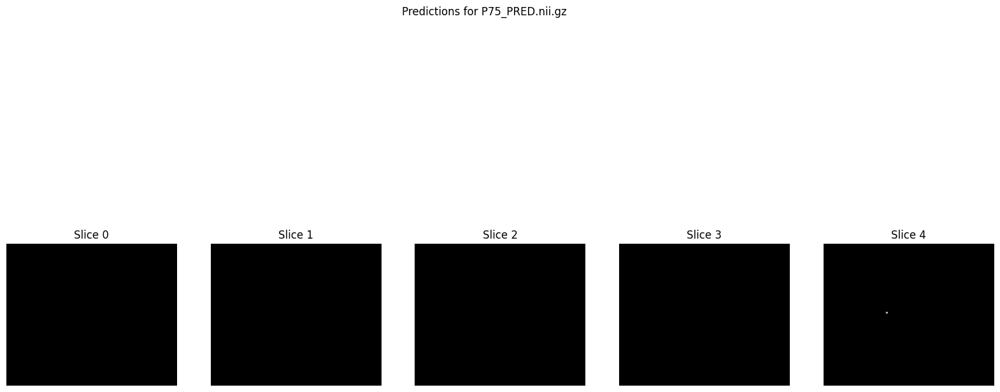

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.50202403, 124.01598644])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnetb0'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 67ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnetb00/P69_PRED.nii.gz


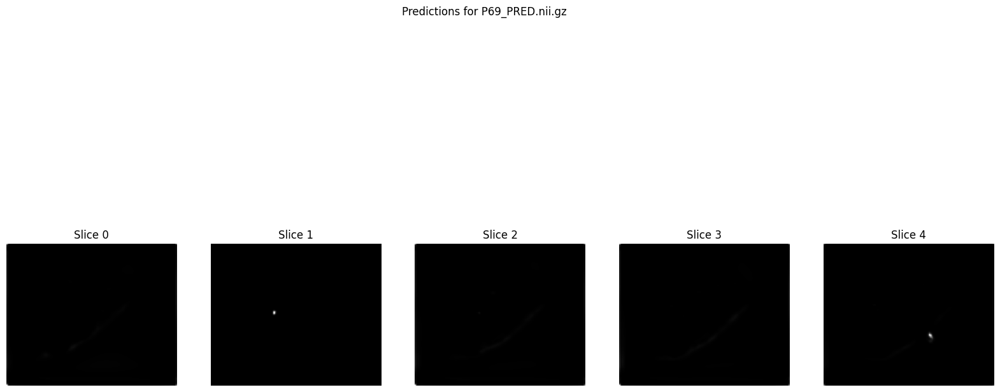

1/1 [==============================] - 0s 66ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnetb00/P54_PRED.nii.gz


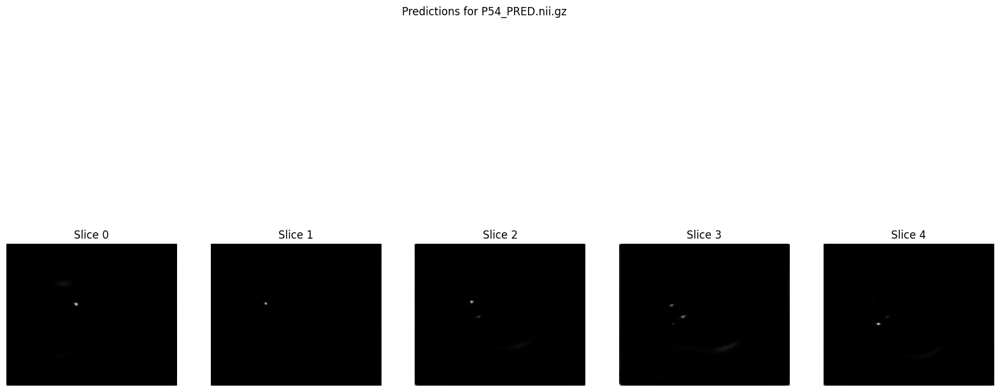

1/1 [==============================] - 0s 68ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnetb00/P55_PRED.nii.gz


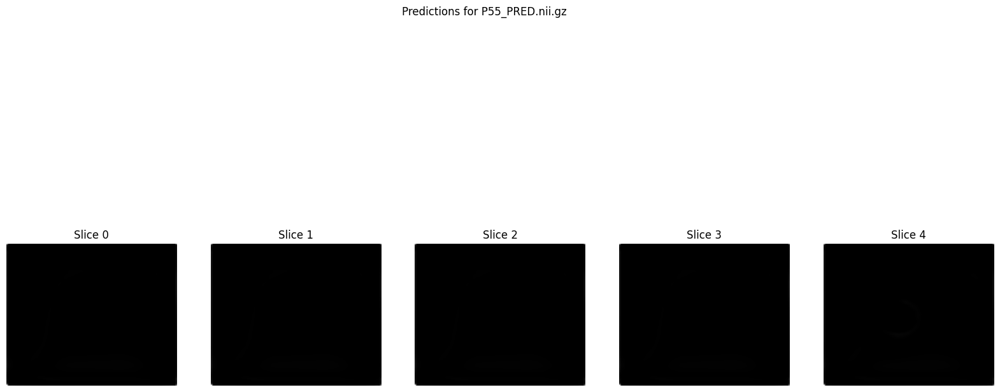

1/1 [==============================] - 0s 66ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnetb00/P56_PRED.nii.gz


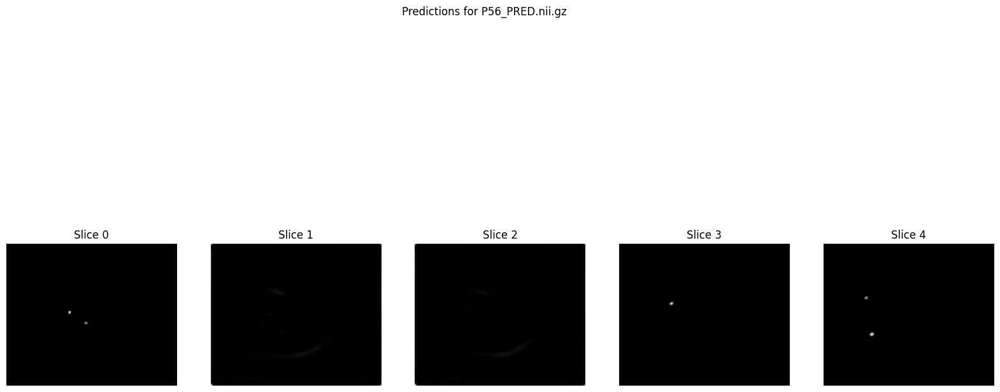

1/1 [==============================] - 0s 64ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnetb00/P57_PRED.nii.gz


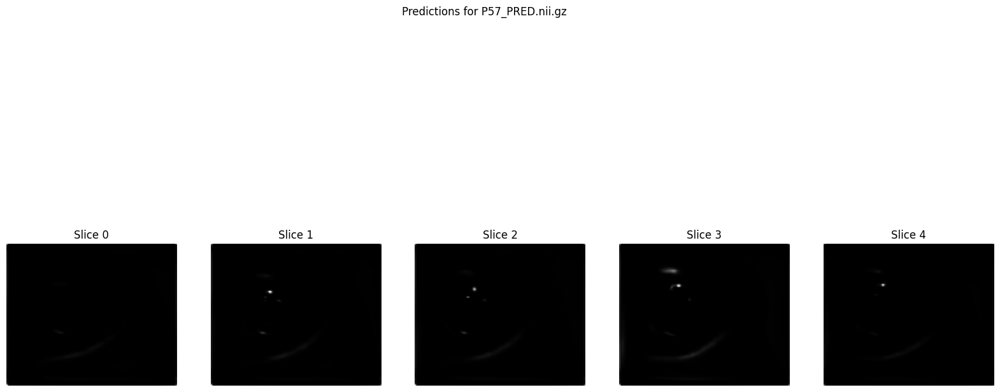

1/1 [==============================] - 0s 65ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnetb00/P58_PRED.nii.gz


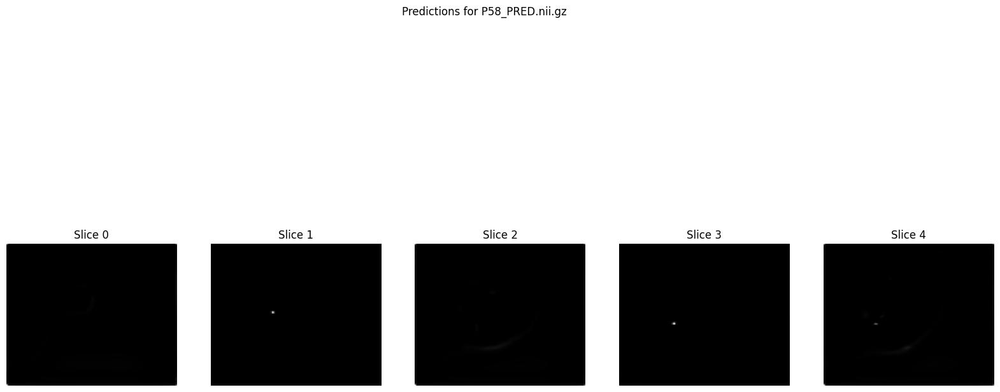

1/1 [==============================] - 0s 66ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnetb00/P59_PRED.nii.gz


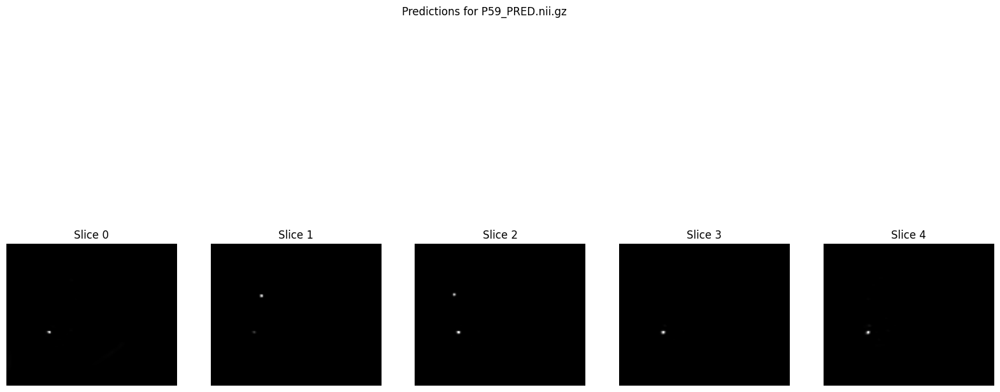

1/1 [==============================] - 0s 67ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSEfficientnetb00/P60_PRED.nii.gz


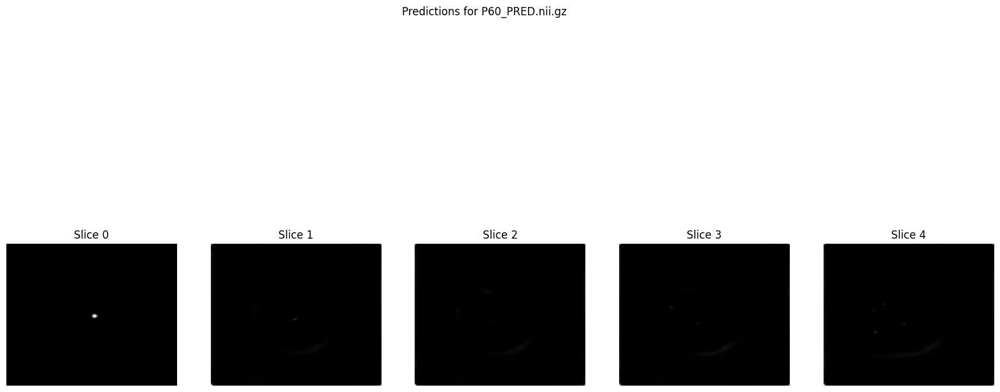

1/1 [==============================] - 0s 65ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSEfficientnetb00/P61_PRED.nii.gz


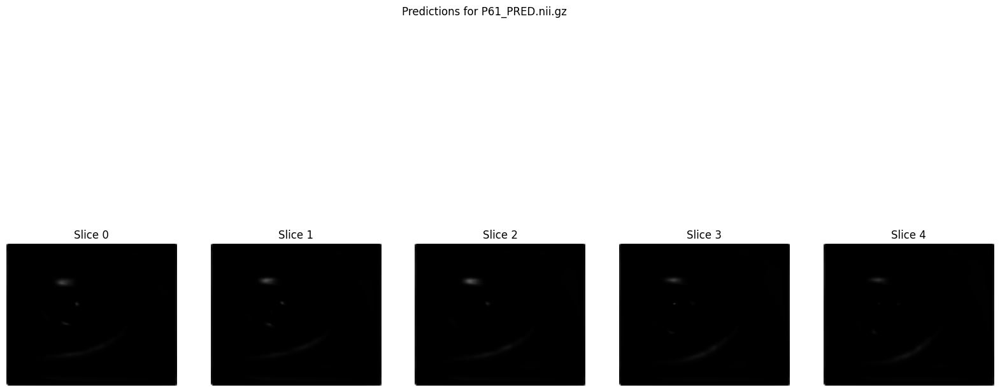

1/1 [==============================] - 0s 63ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSEfficientnetb00/P62_PRED.nii.gz


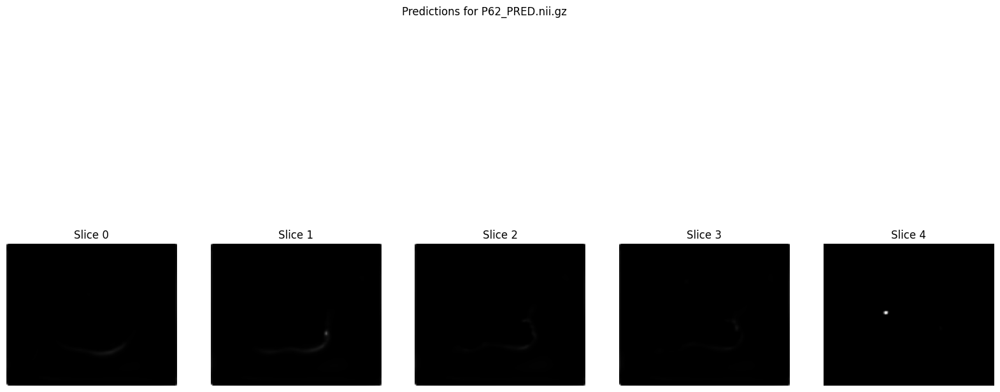

1/1 [==============================] - 0s 63ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSEfficientnetb00/P63_PRED.nii.gz


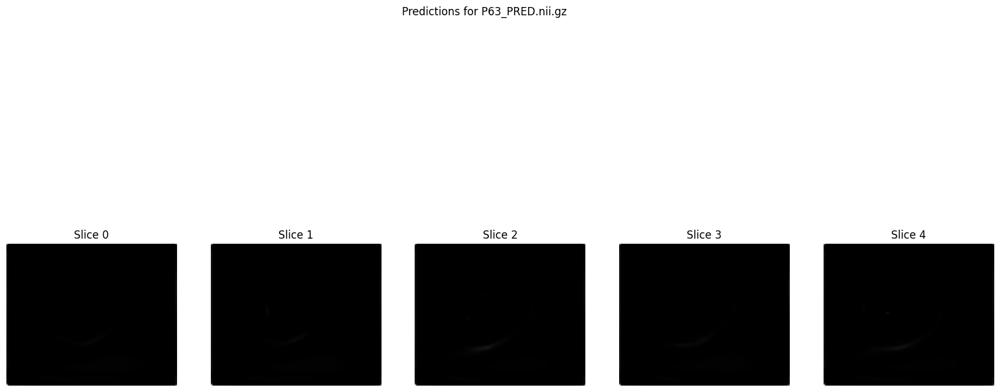

1/1 [==============================] - 0s 67ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSEfficientnetb00/P64_PRED.nii.gz


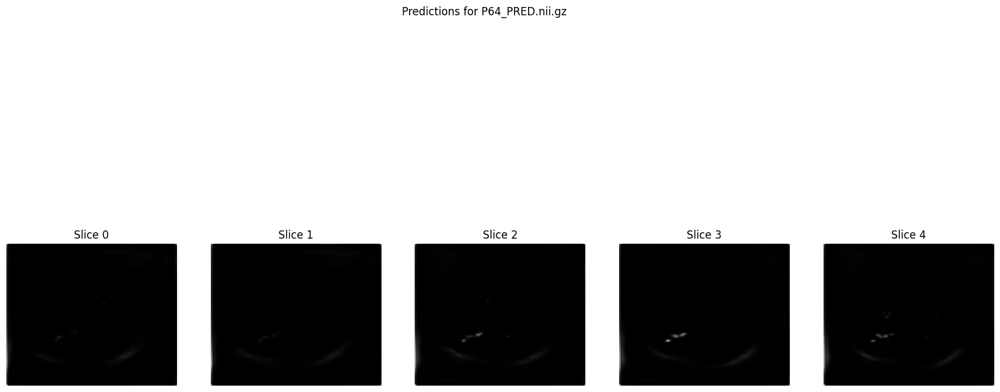

1/1 [==============================] - 0s 65ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSEfficientnetb00/P65_PRED.nii.gz


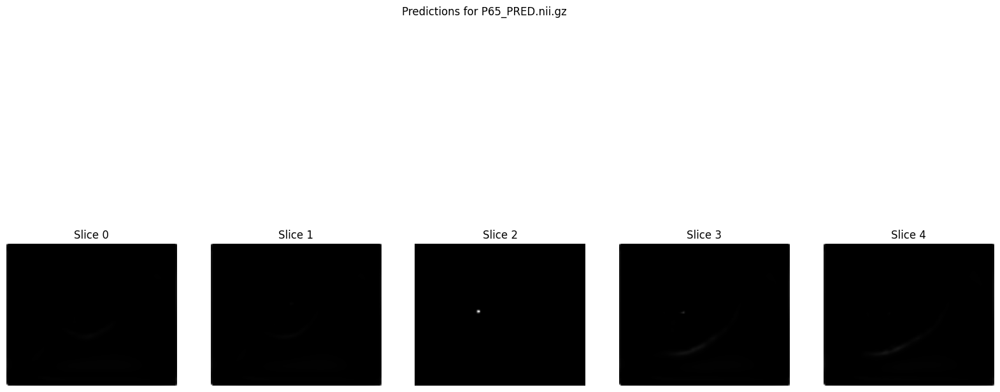

1/1 [==============================] - 0s 65ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSEfficientnetb00/P66_PRED.nii.gz


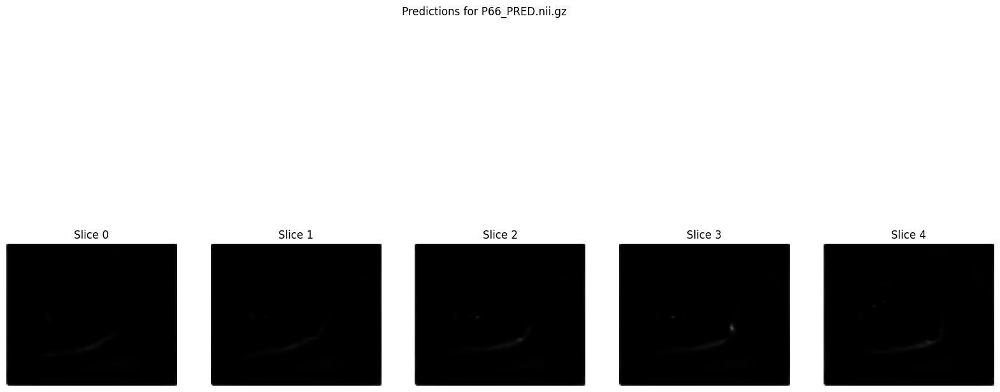

1/1 [==============================] - 0s 61ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSEfficientnetb00/P67_PRED.nii.gz


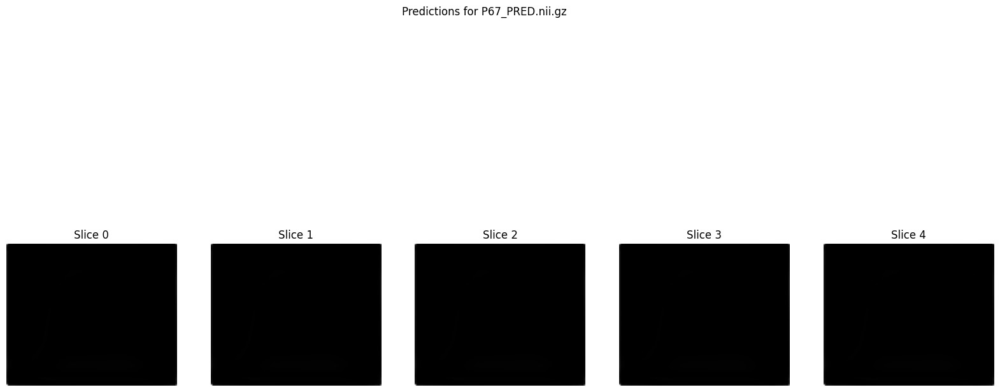

1/1 [==============================] - 0s 71ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSEfficientnetb00/P68_PRED.nii.gz


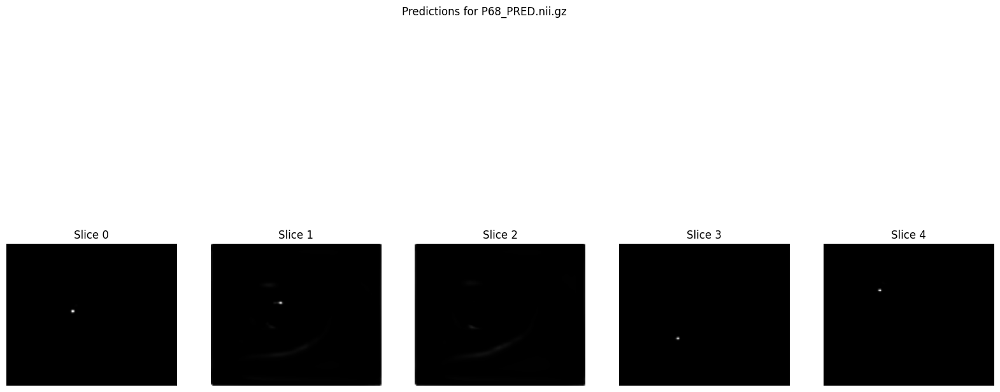

1/1 [==============================] - 0s 67ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSEfficientnetb00/P70_PRED.nii.gz


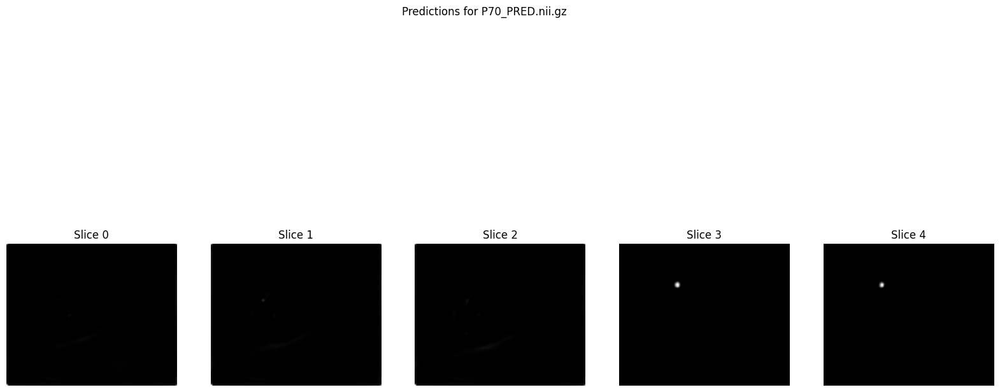

1/1 [==============================] - 0s 64ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSEfficientnetb00/P71_PRED.nii.gz


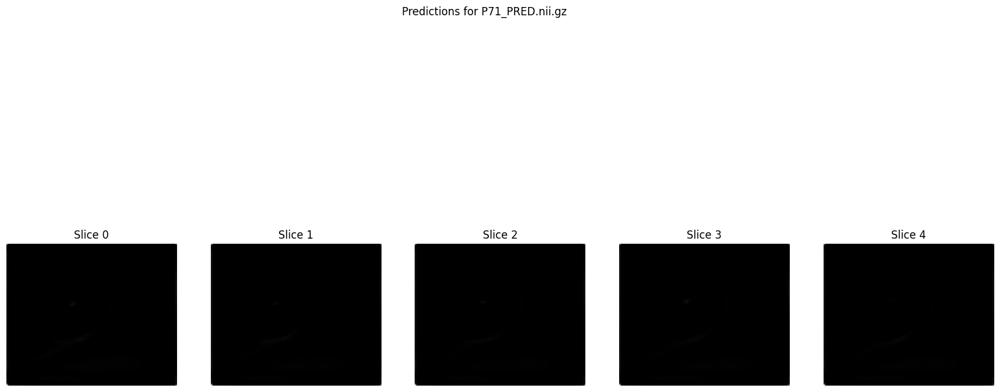

1/1 [==============================] - 0s 68ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSEfficientnetb00/P72_PRED.nii.gz


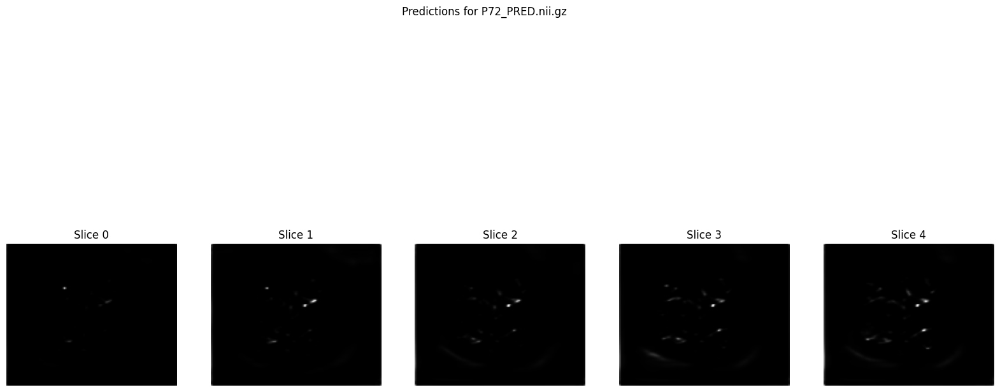

1/1 [==============================] - 0s 66ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSEfficientnetb00/P73_PRED.nii.gz


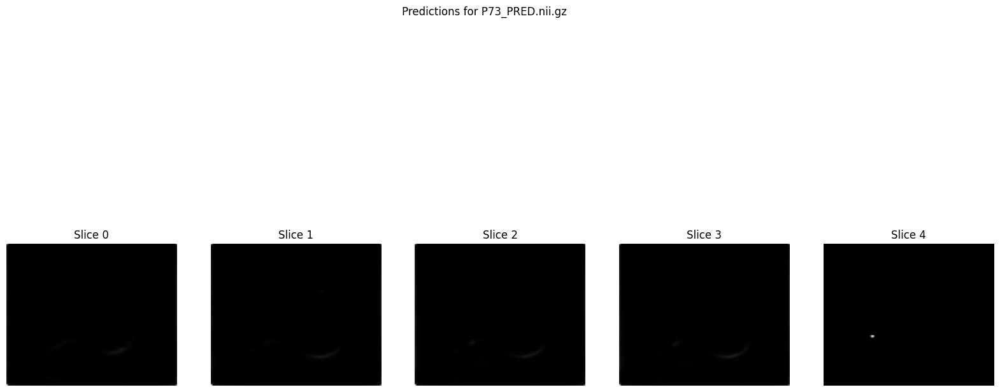

1/1 [==============================] - 0s 66ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSEfficientnetb00/P74_PRED.nii.gz


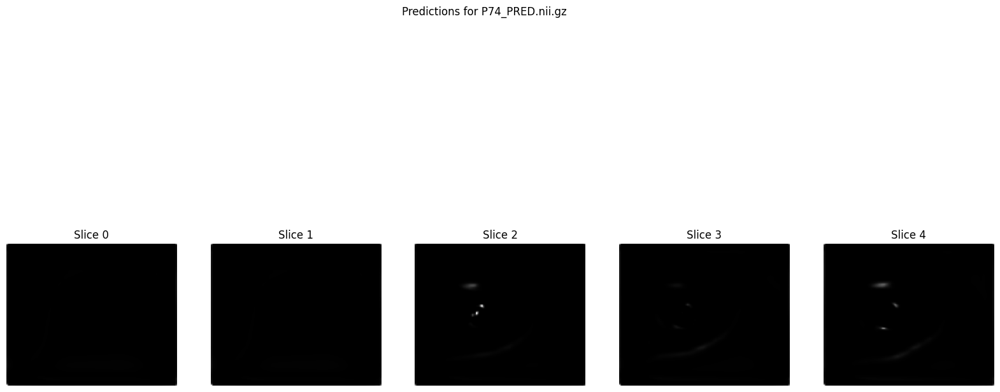

1/1 [==============================] - 0s 68ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSEfficientnetb00/P75_PRED.nii.gz


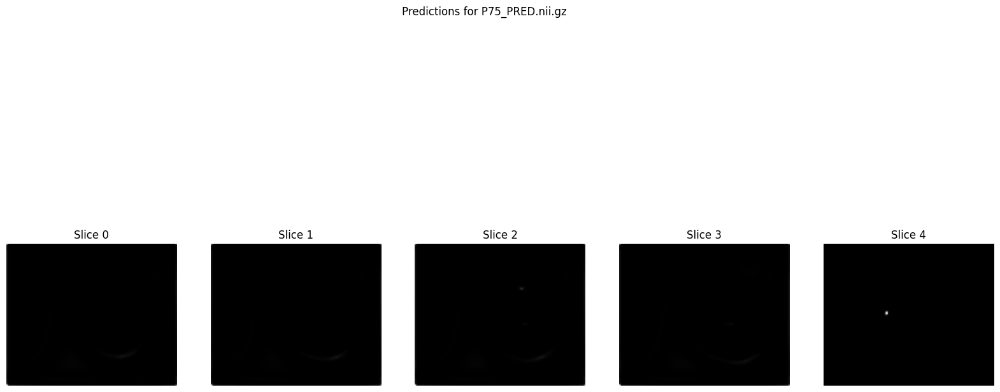

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.50202403, 124.01598644])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnetb00'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

def predict_and_save(patient_id, t2_path, flair_path, output_dir, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict for each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save the prediction as a NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data paths and output directory
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir)

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**CLASS_WEIGHT [0.5,10]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb01/2D3Dunet_checkpoint.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.0817 - dice_coefficient: 0.0787
Epoch 1: val_loss improved from inf to 0.12566, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb01/2D3Dunet_checkpoint.h5
312/312 [==============================] - 188s 573ms/step - loss: 0.0817 - dice_coefficient: 0.0787 - val_loss: 0.1257 - val_dice_coefficient: 0.0374
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0368 - dice_coefficient: 0.2132
Epoch 2: val_loss improved from 0.12566 to 0.04368, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb01/2D3Dunet_checkpoint.h5
312/312 [==============================] - 179s 574ms/step - loss: 0.0368 - dice_coefficient: 0.2132 - val_loss: 0.0437 - val_dice_coefficient: 0.2063
Epoch 3/100
312/312 [==============================] - ETA

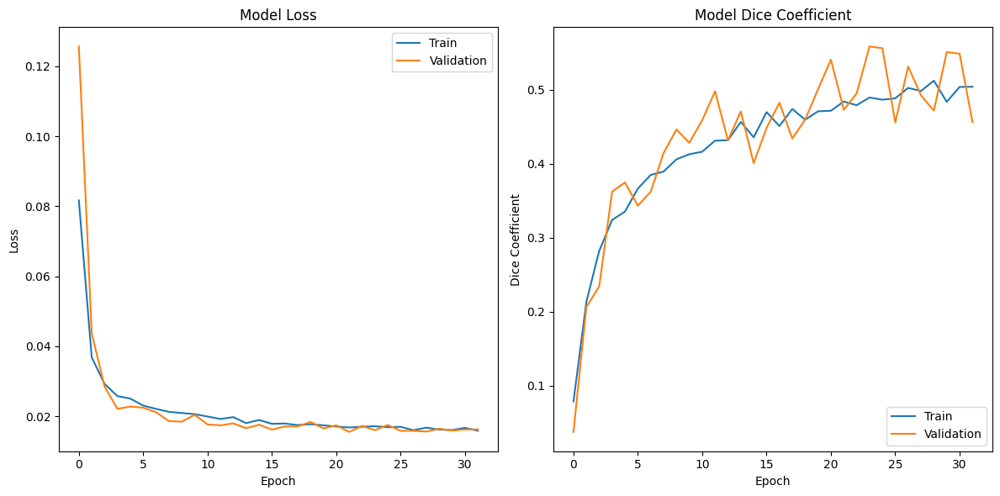

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

Determine the threshold for the sigmoid function

In [ ]:
# Preprocess input and predict functions
def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        combined_image.fill(0)
    return combined_image

def predict_slice(t2_slice, flair_slice, threshold):
    combined_slice = preprocess_input(t2_slice, flair_slice)
    combined_slice = np.expand_dims(combined_slice, axis=0)
    pred_slice = model.predict(combined_slice)
    pred_slice = (pred_slice > threshold).astype(np.float32)
    return pred_slice.squeeze()

# Define the Dice coefficient to ensure the same type for inputs
def dice_coefficient(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + 1)

# Find the best threshold
best_threshold = 0.5
best_dice = 0.0
thresholds = np.arange(0.1, 0.9, 0.1)

for threshold in thresholds:
    dice_scores = []
    for i in range(val_inputs.shape[0]):
        t2_image = val_inputs[i, :, :, 0]
        flair_image = val_inputs[i, :, :, 1]
        ground_truth = val_masks[i, :, :, 0]

        prediction = predict_slice(t2_image, flair_image, threshold)
        dice_score = dice_coefficient(ground_truth, prediction)
        dice_scores.append(dice_score)

    mean_dice = np.mean(dice_scores)
    if mean_dice > best_dice:
        best_dice = mean_dice
        best_threshold = threshold

print(f'Best threshold: {best_threshold} with mean Dice score: {best_dice}')

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 64ms/step
Best threshold: 0.8 with mean Dice score: 0.7403154373168945


**TESTING**

1/1 [==============================] - 0s 67ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnet_0510/P69_PRED.nii.gz


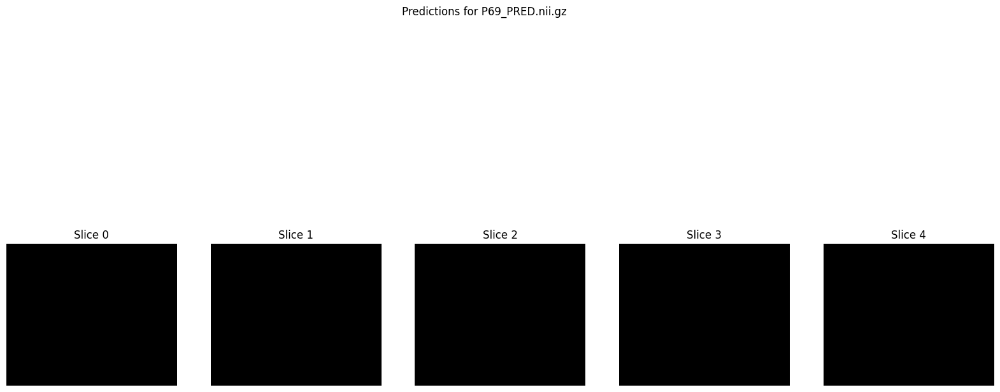

1/1 [==============================] - 0s 66ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnet_0510/P54_PRED.nii.gz


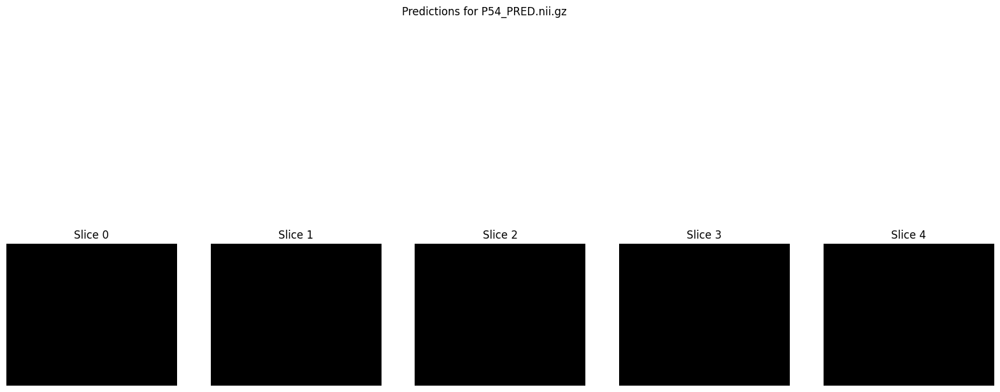

1/1 [==============================] - 0s 69ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnet_0510/P55_PRED.nii.gz


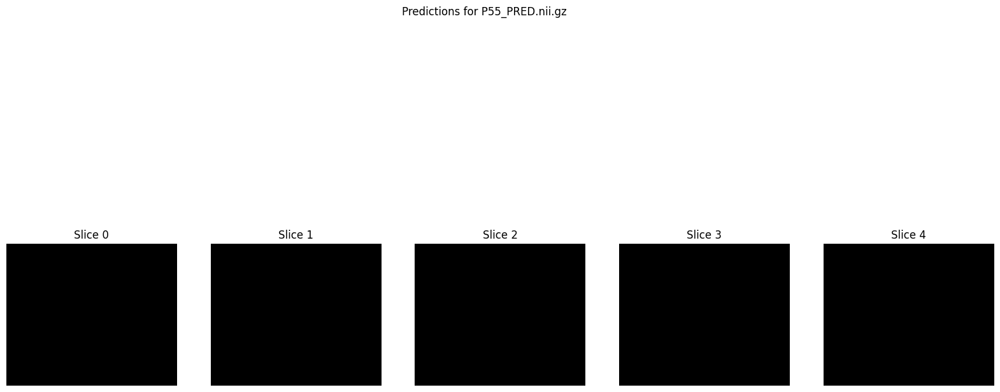

1/1 [==============================] - 0s 66ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnet_0510/P56_PRED.nii.gz


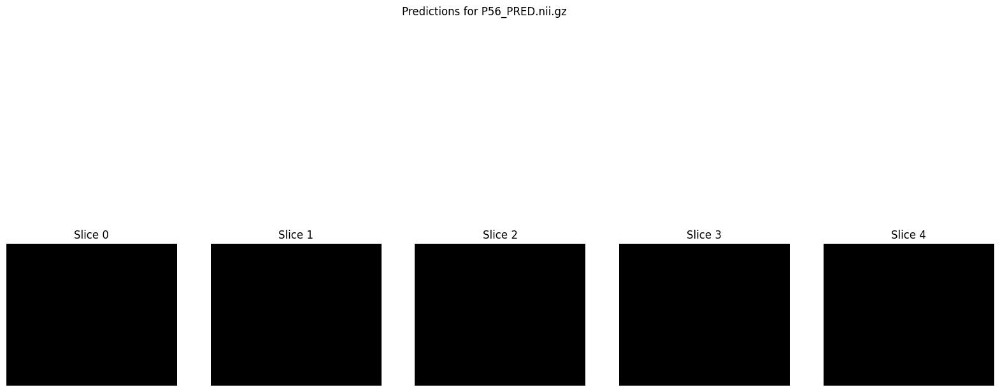

1/1 [==============================] - 0s 65ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnet_0510/P57_PRED.nii.gz


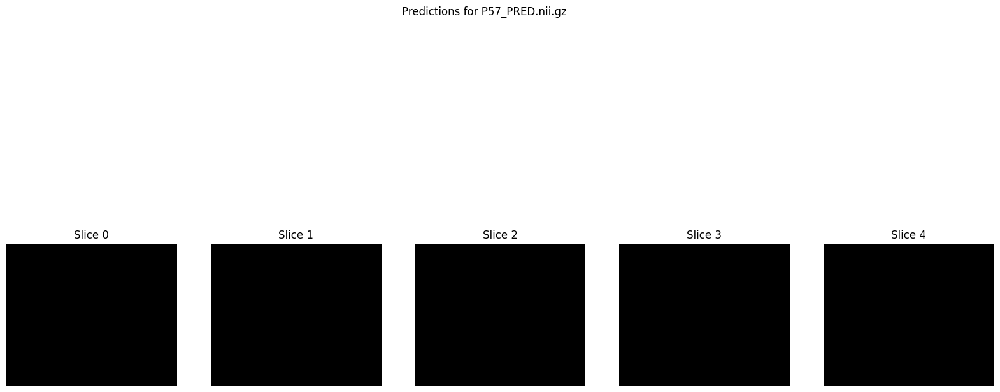

1/1 [==============================] - 0s 67ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnet_0510/P58_PRED.nii.gz


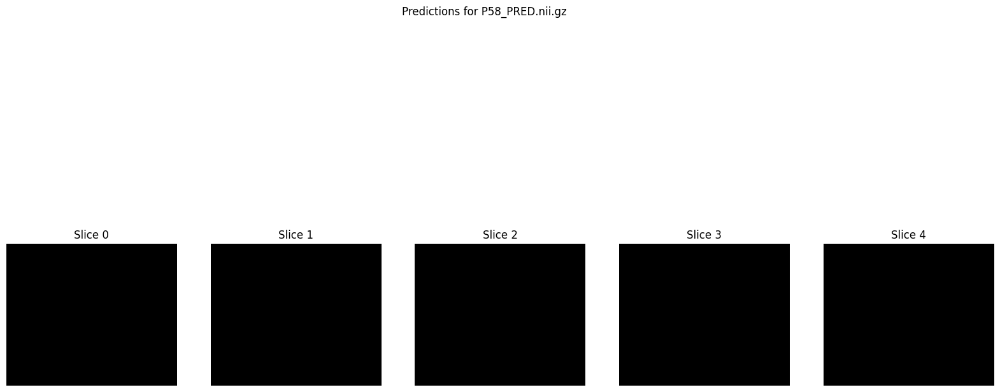

1/1 [==============================] - 0s 70ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnet_0510/P59_PRED.nii.gz


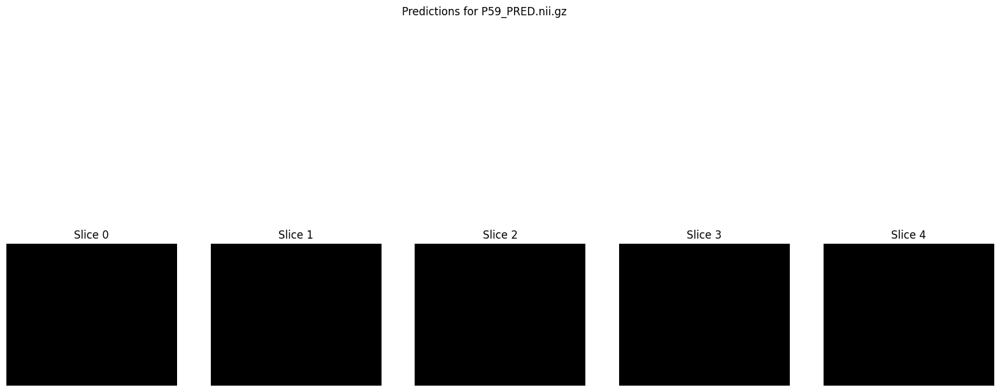

1/1 [==============================] - 0s 62ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSEfficientnet_0510/P60_PRED.nii.gz


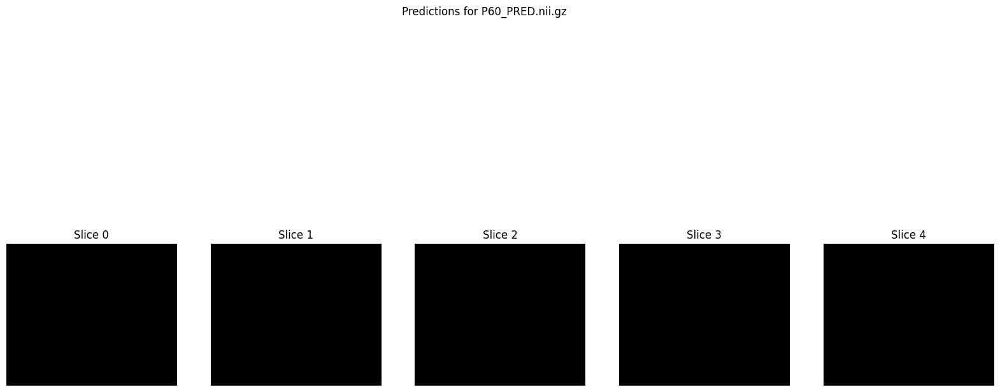

1/1 [==============================] - 0s 63ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSEfficientnet_0510/P61_PRED.nii.gz


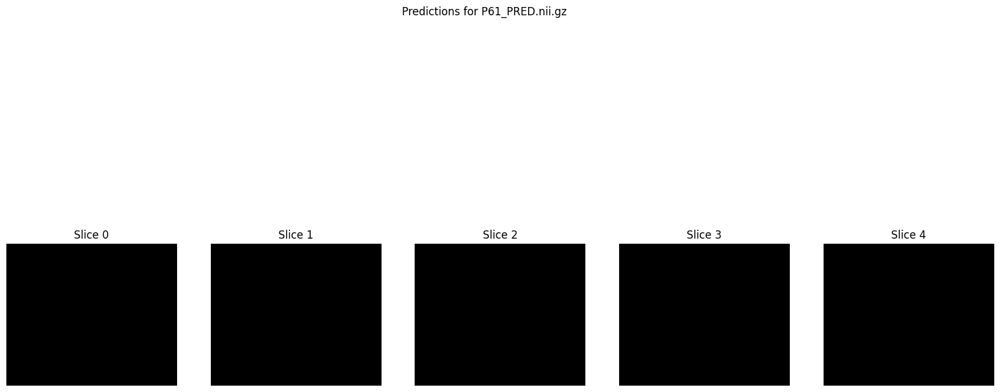

1/1 [==============================] - 0s 66ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSEfficientnet_0510/P62_PRED.nii.gz


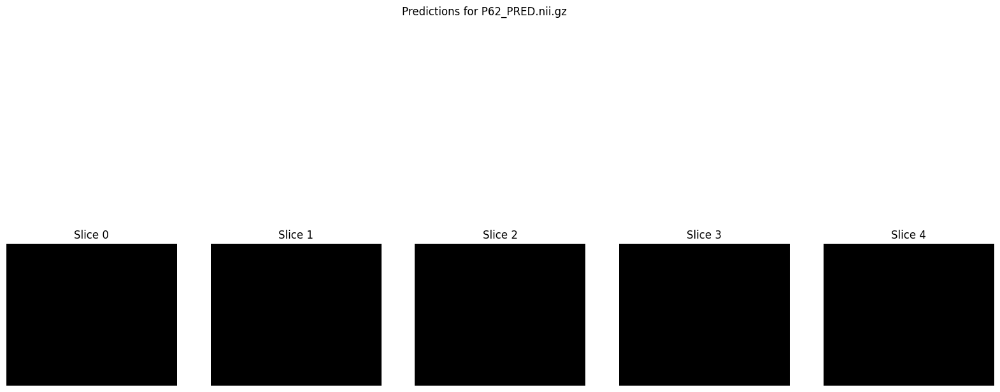

1/1 [==============================] - 0s 68ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSEfficientnet_0510/P63_PRED.nii.gz


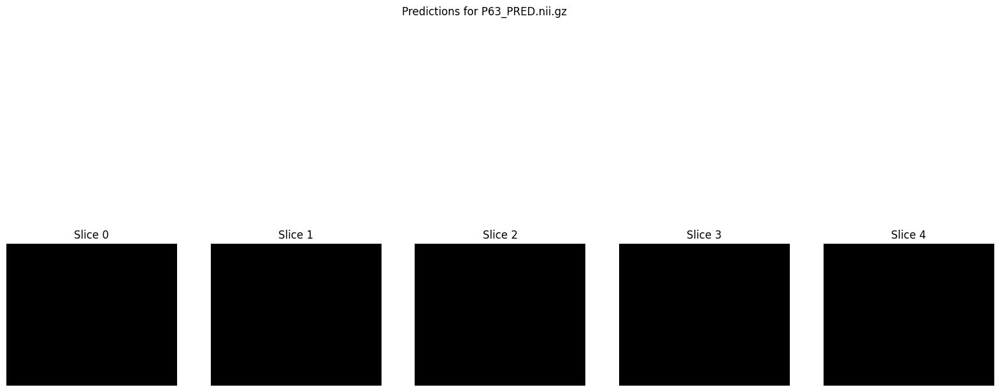

1/1 [==============================] - 0s 62ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSEfficientnet_0510/P64_PRED.nii.gz


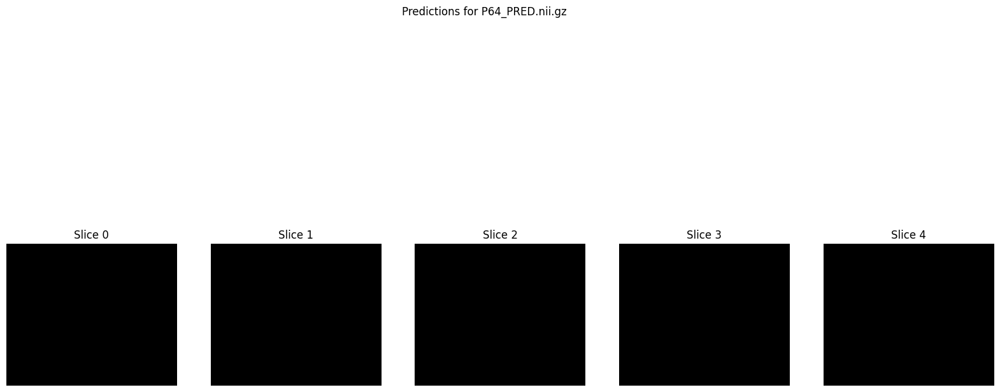

1/1 [==============================] - 0s 63ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSEfficientnet_0510/P65_PRED.nii.gz


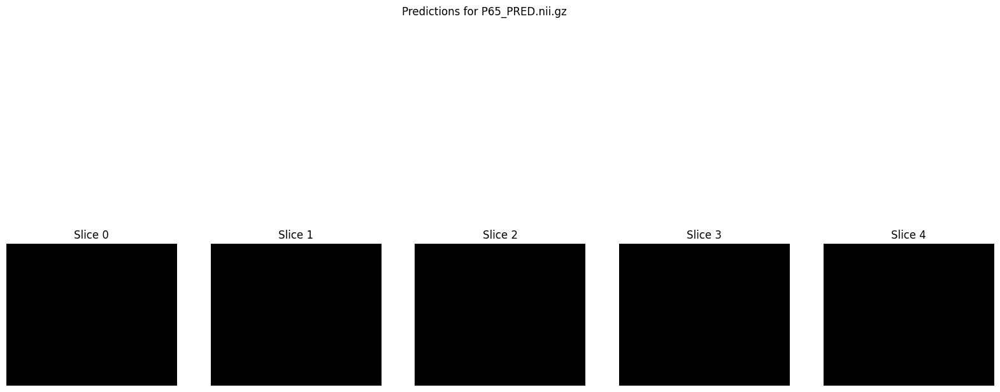

1/1 [==============================] - 0s 67ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSEfficientnet_0510/P66_PRED.nii.gz


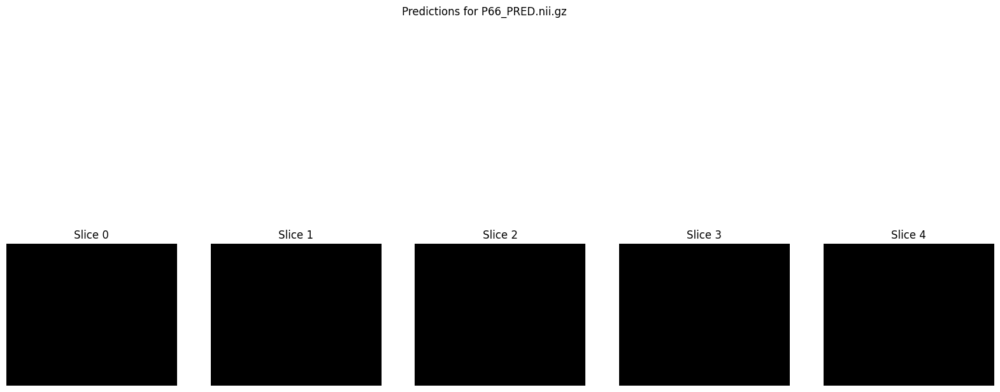

1/1 [==============================] - 0s 68ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSEfficientnet_0510/P67_PRED.nii.gz


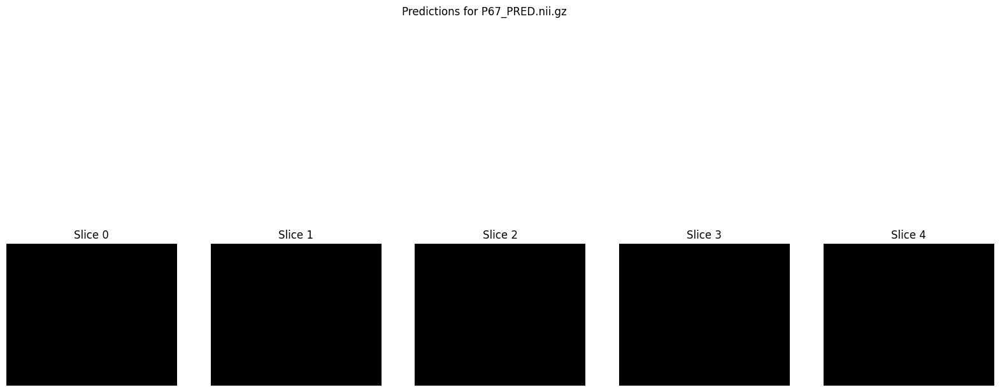

1/1 [==============================] - 0s 72ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSEfficientnet_0510/P68_PRED.nii.gz


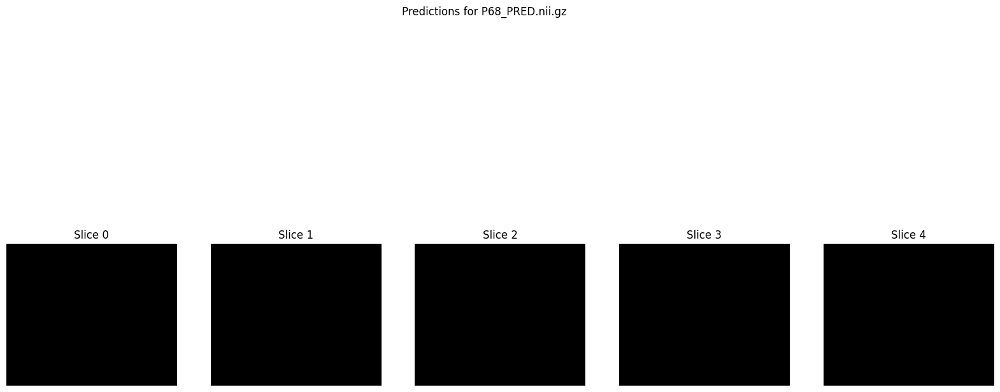

1/1 [==============================] - 0s 67ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSEfficientnet_0510/P70_PRED.nii.gz


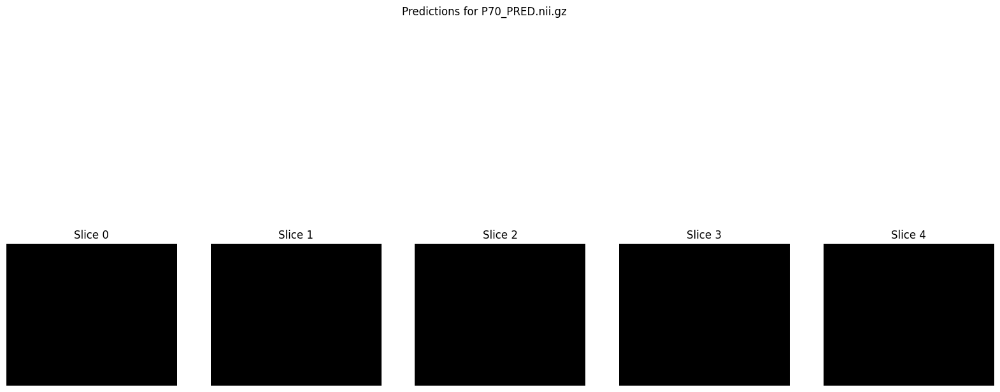

1/1 [==============================] - 0s 67ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSEfficientnet_0510/P71_PRED.nii.gz


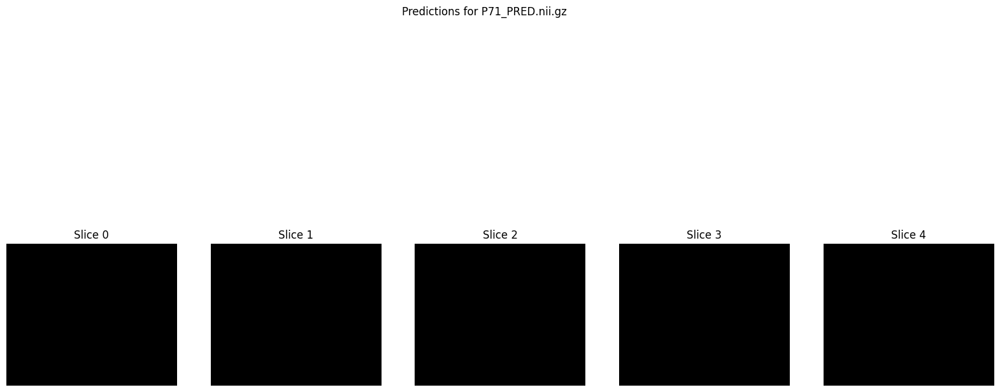

1/1 [==============================] - 0s 66ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSEfficientnet_0510/P72_PRED.nii.gz


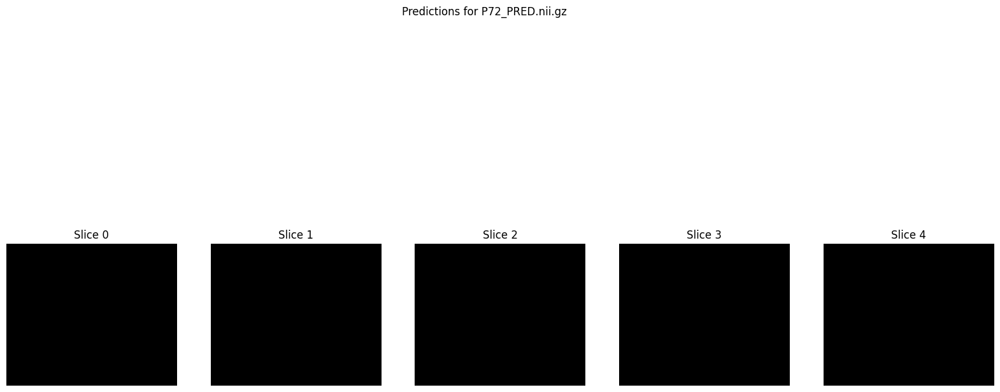

1/1 [==============================] - 0s 64ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSEfficientnet_0510/P73_PRED.nii.gz


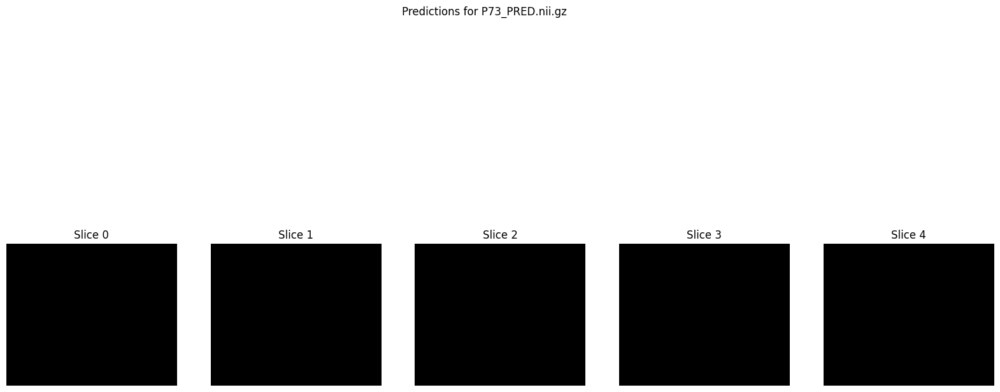

1/1 [==============================] - 0s 64ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSEfficientnet_0510/P74_PRED.nii.gz


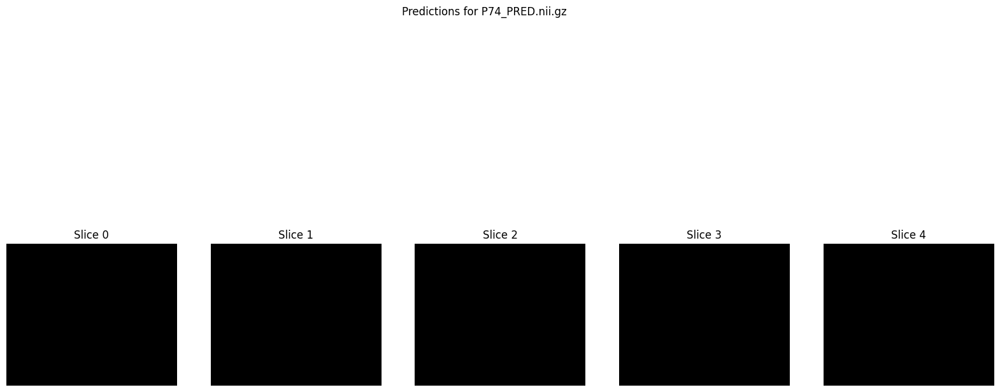

1/1 [==============================] - 0s 66ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSEfficientnet_0510/P75_PRED.nii.gz


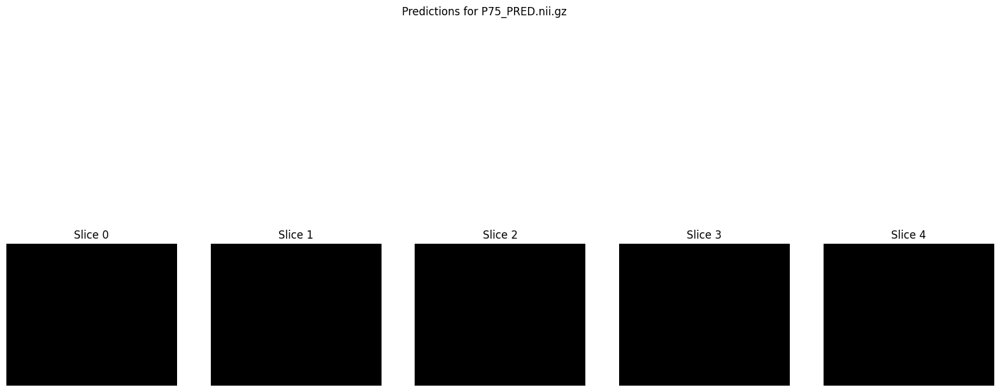

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.5, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnet_0510'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 68ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P69_PRED.nii.gz


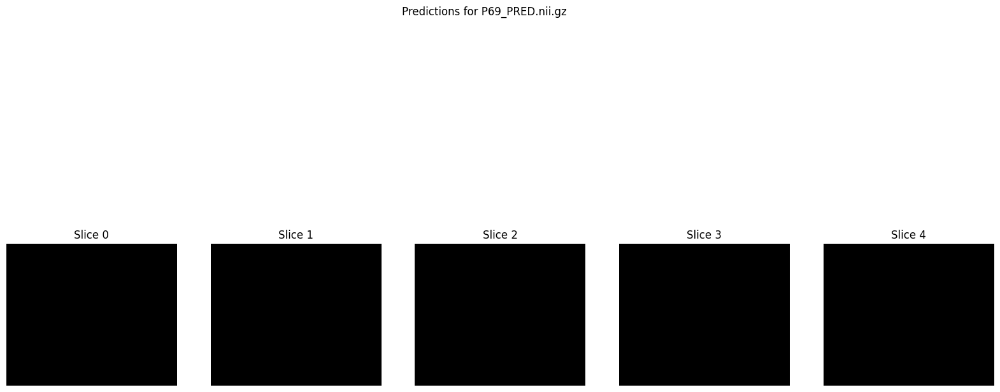

1/1 [==============================] - 0s 70ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P54_PRED.nii.gz


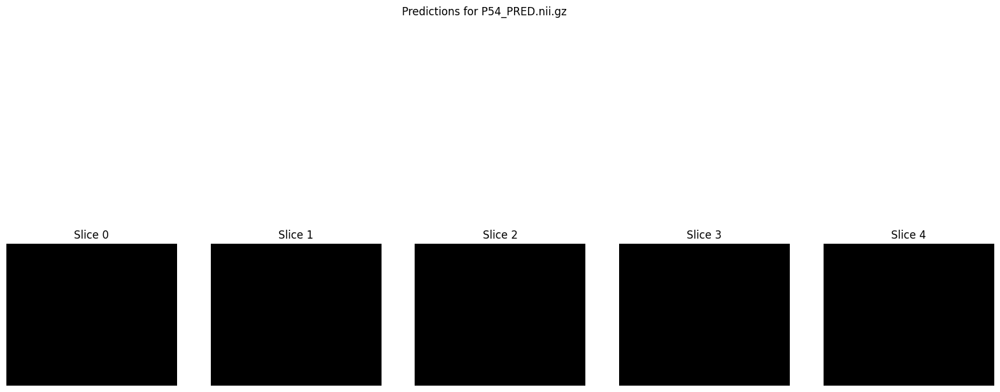

1/1 [==============================] - 0s 70ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P55_PRED.nii.gz


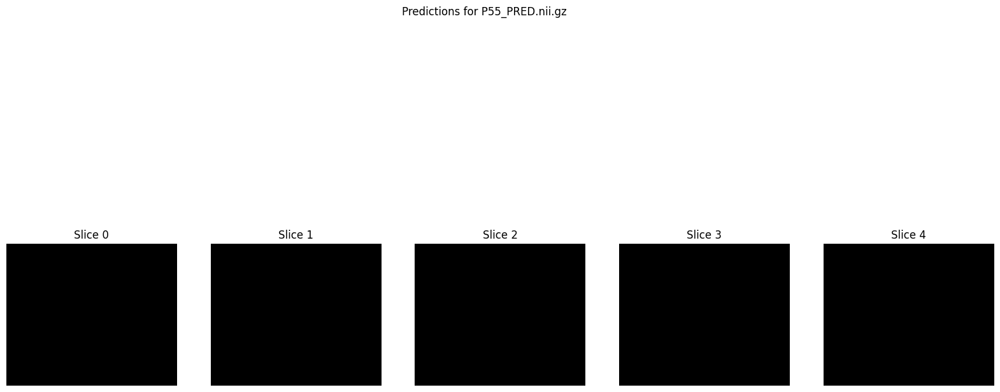

1/1 [==============================] - 0s 72ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P56_PRED.nii.gz


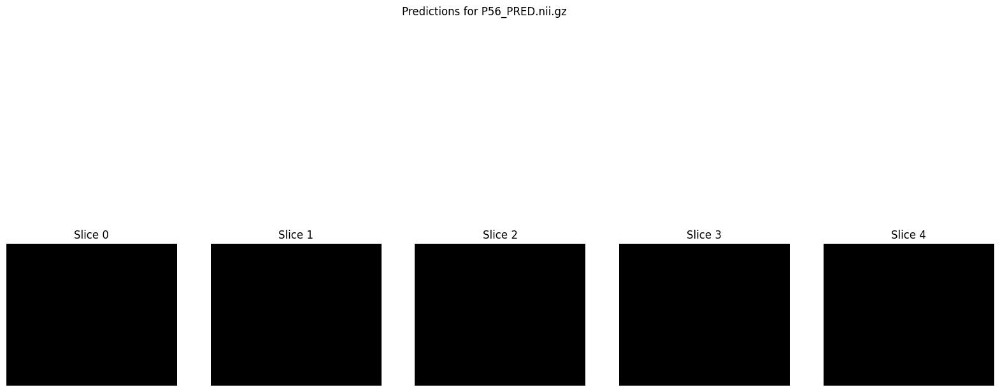

1/1 [==============================] - 0s 69ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P57_PRED.nii.gz


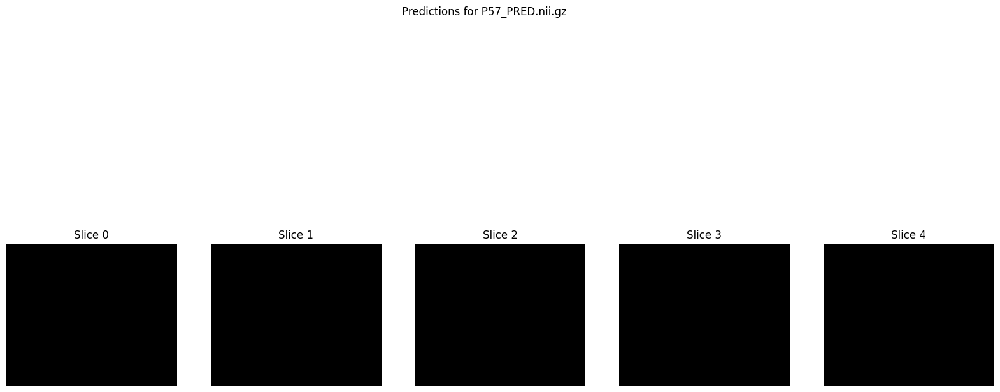

1/1 [==============================] - 0s 68ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P58_PRED.nii.gz


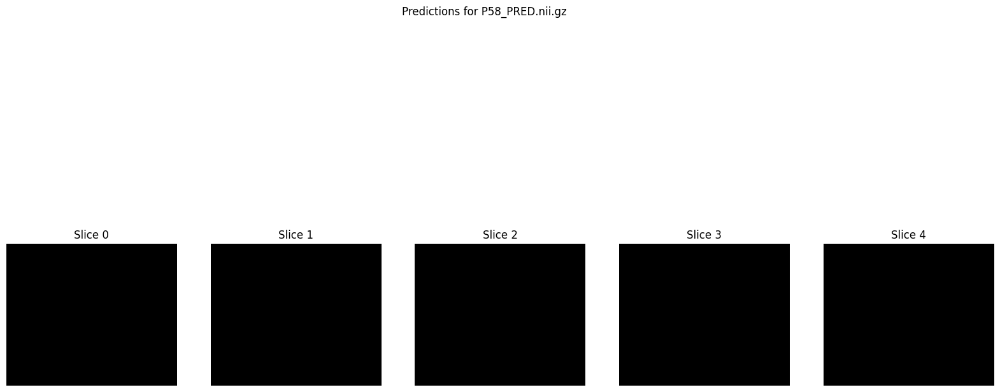

1/1 [==============================] - 0s 64ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P59_PRED.nii.gz


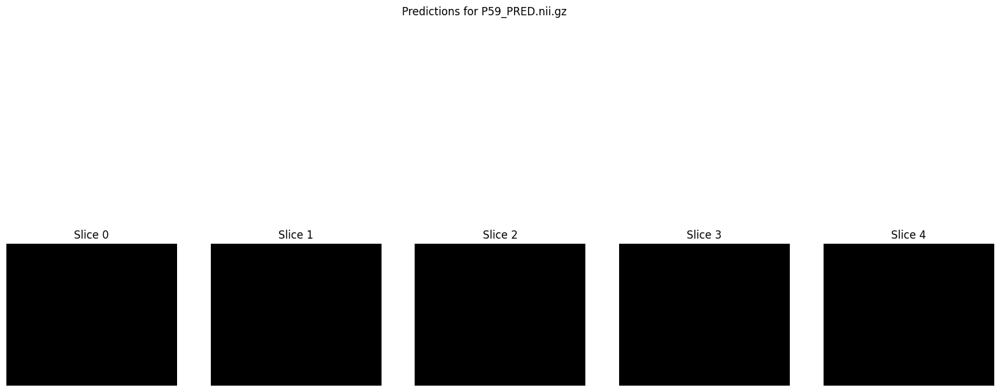

1/1 [==============================] - 0s 71ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P60_PRED.nii.gz


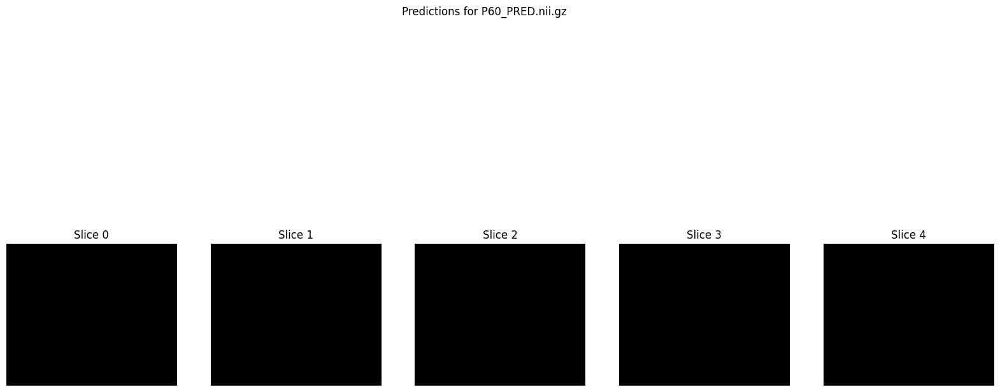

1/1 [==============================] - 0s 66ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P61_PRED.nii.gz


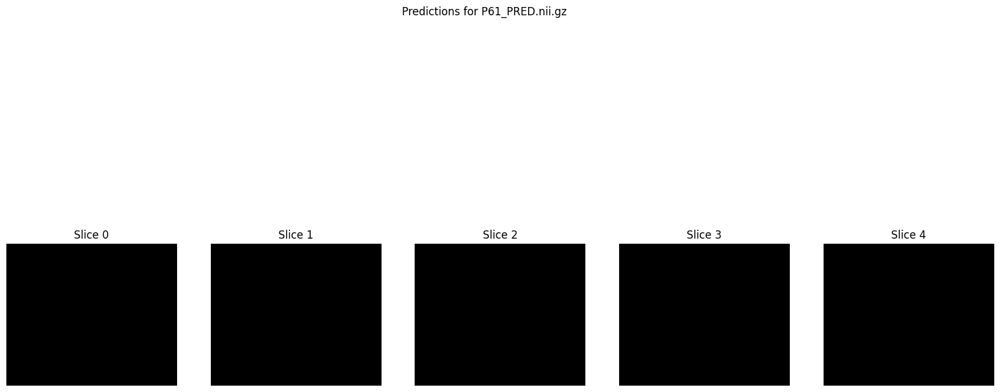

1/1 [==============================] - 0s 72ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P62_PRED.nii.gz


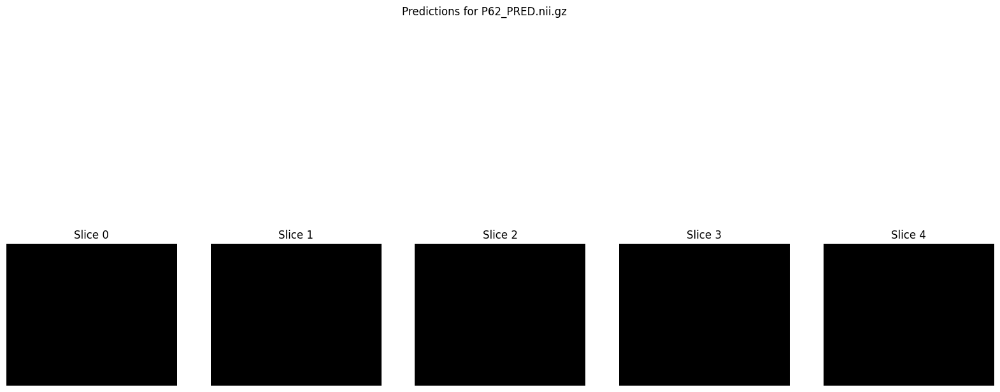

1/1 [==============================] - 0s 68ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P63_PRED.nii.gz


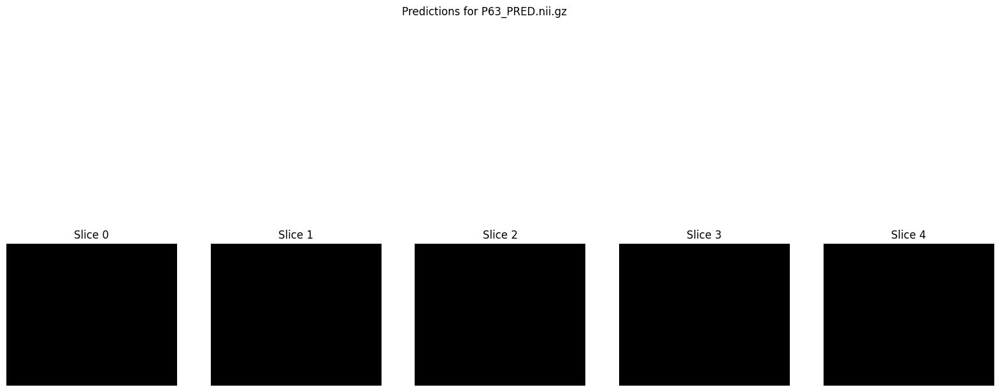

1/1 [==============================] - 0s 73ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P64_PRED.nii.gz


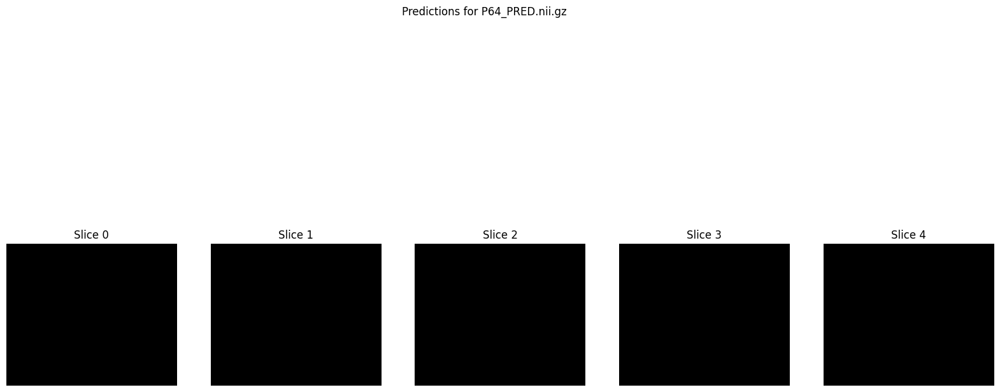

1/1 [==============================] - 0s 75ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P65_PRED.nii.gz


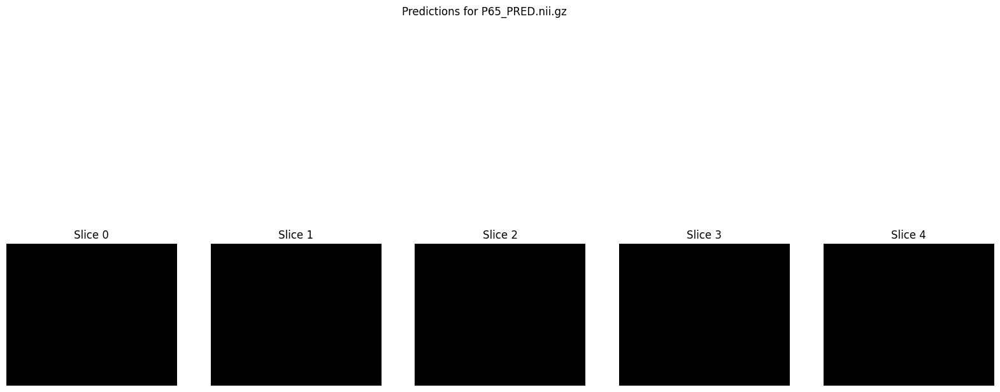

1/1 [==============================] - 0s 69ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P66_PRED.nii.gz


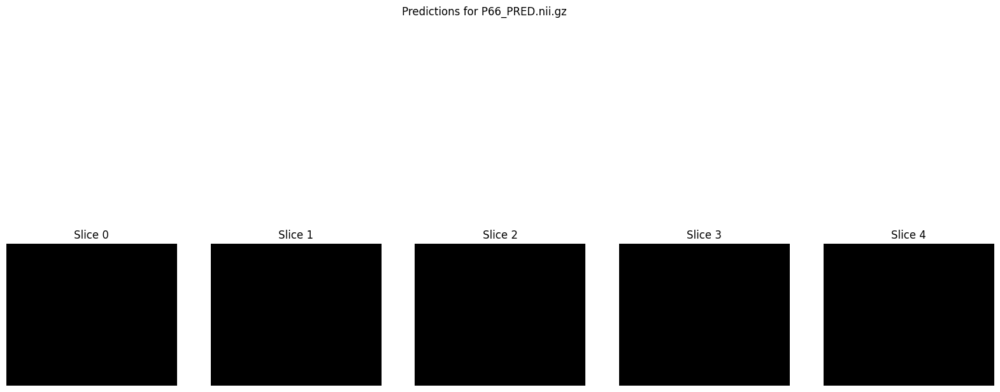

1/1 [==============================] - 0s 69ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P67_PRED.nii.gz


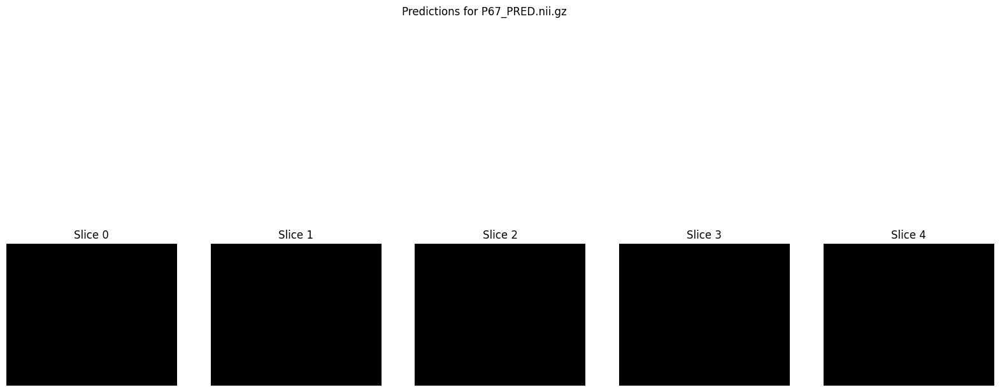

1/1 [==============================] - 0s 69ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P68_PRED.nii.gz


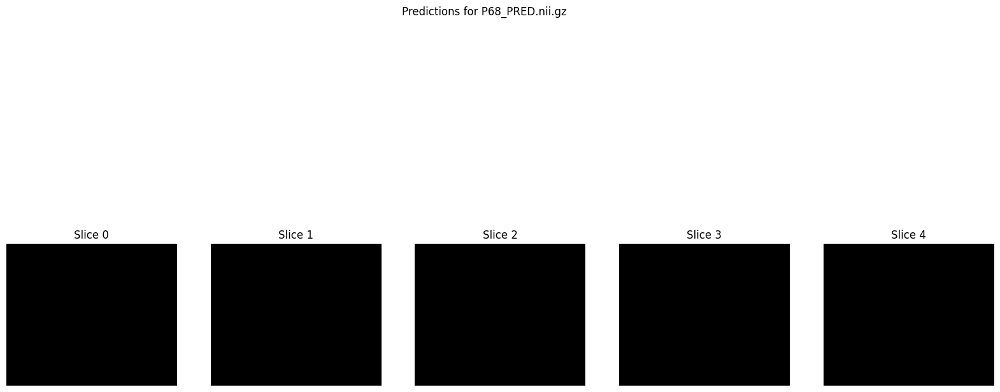

1/1 [==============================] - 0s 70ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P70_PRED.nii.gz


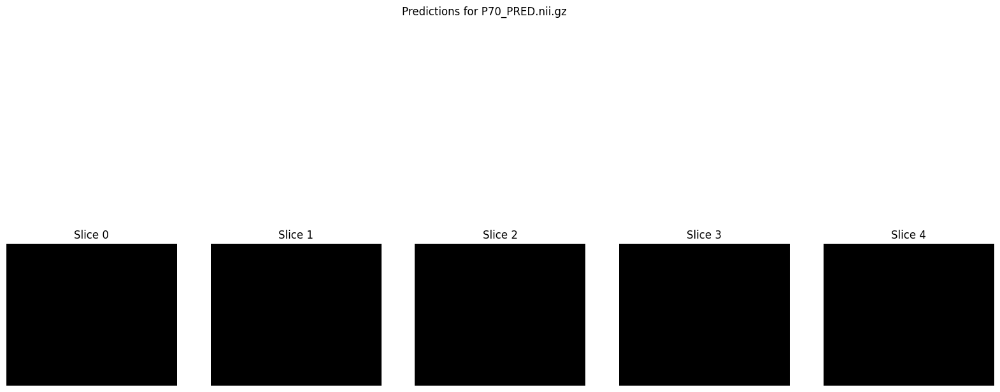

1/1 [==============================] - 0s 70ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P71_PRED.nii.gz


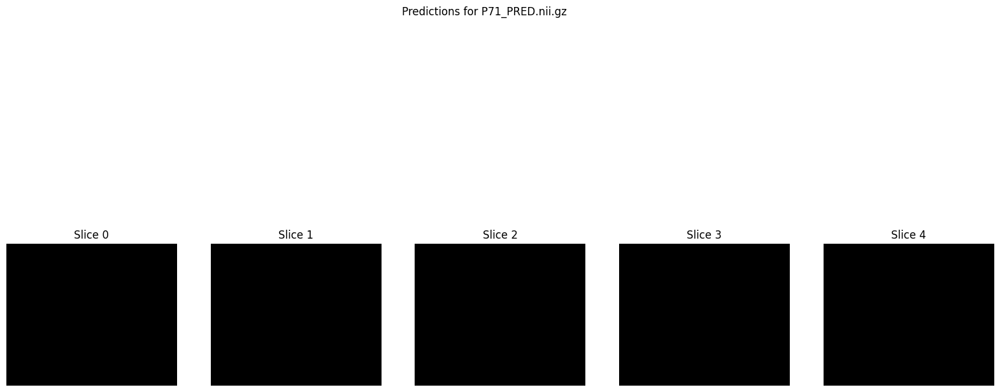

1/1 [==============================] - 0s 71ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P72_PRED.nii.gz


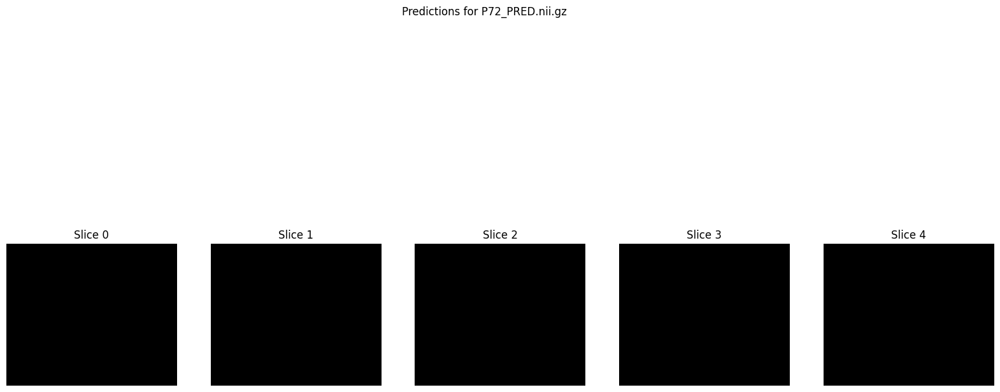

1/1 [==============================] - 0s 71ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P73_PRED.nii.gz


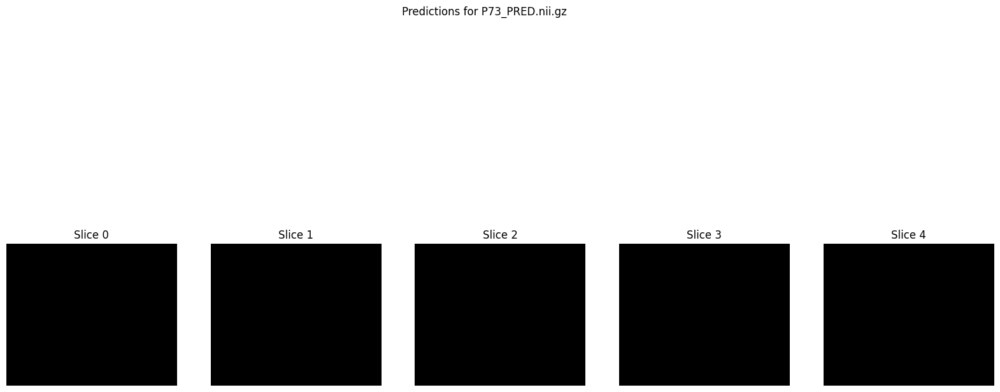

1/1 [==============================] - 0s 73ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P74_PRED.nii.gz


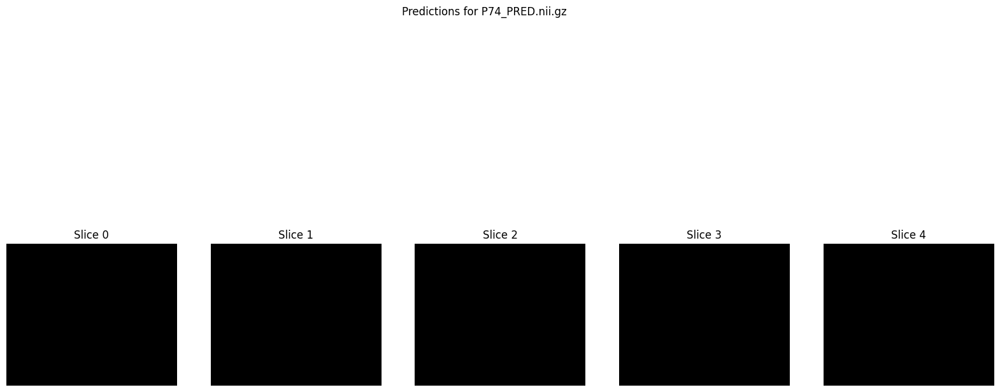

1/1 [==============================] - 0s 70ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSEfficientnet_110_05/P75_PRED.nii.gz


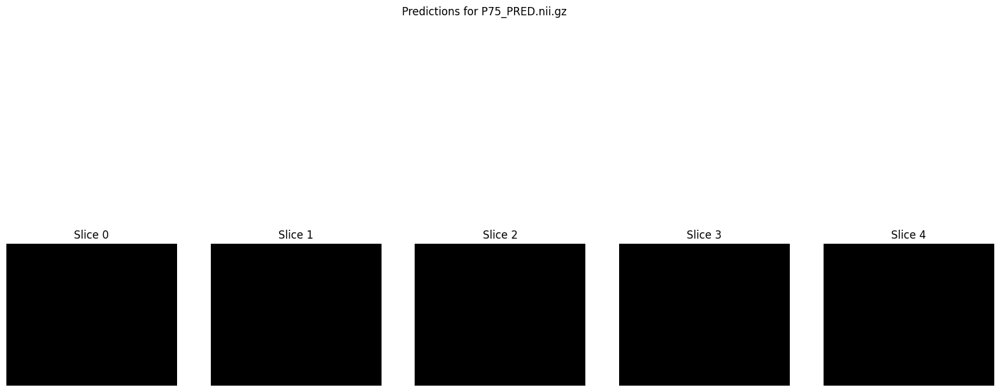

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.5, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnet_110_05'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Ensure predictions are binary
    prediction = (prediction > 0.5).astype(np.float32)  # Apply a second threshold to make sure it's binary

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', '.test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', '.test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()


**CLASS_WEIGHT [1.0, 10.0]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb02/2D3Dunet_checkpoint.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.1290 - dice_coefficient: 0.0650
Epoch 1: val_loss improved from inf to 0.12724, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb02/2D3Dunet_checkpoint.h5
312/312 [==============================] - 186s 564ms/step - loss: 0.1290 - dice_coefficient: 0.0650 - val_loss: 0.1272 - val_dice_coefficient: 0.0376
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0455 - dice_coefficient: 0.2568
Epoch 2: val_loss improved from 0.12724 to 0.04755, saving model to /content/drive/MyDrive/2D3Dunet_checkpointEfficientnetb02/2D3Dunet_checkpoint.h5
312/312 [==============================] - 172s 551ms/step - loss: 0.0455 - dice_coefficient: 0.2568 - val_loss: 0.0476 - val_dice_coefficient: 0.2341
Epoch 3/100
312/312 [==============================] - ETA

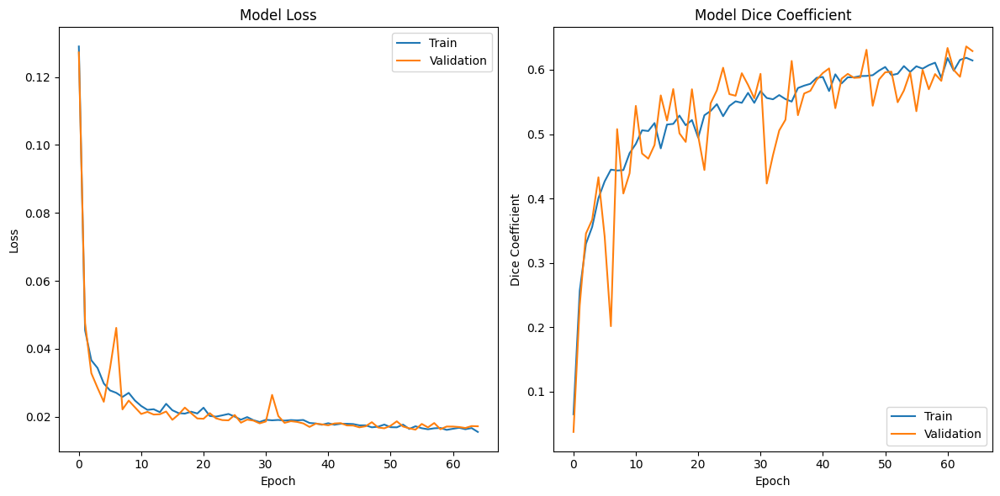

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

Determine the best threshold for sigmoid function

In [ ]:
# Preprocess input and predict functions
def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        combined_image.fill(0)
    return combined_image

def predict_slice(t2_slice, flair_slice, threshold):
    combined_slice = preprocess_input(t2_slice, flair_slice)
    combined_slice = np.expand_dims(combined_slice, axis=0)
    pred_slice = model.predict(combined_slice)
    pred_slice = (pred_slice > threshold).astype(np.float32)
    return pred_slice.squeeze()

# Define the Dice coefficient to ensure the same type for inputs
def dice_coefficient(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + 1)

# Find the best threshold
best_threshold = 0.5
best_dice = 0.0
thresholds = np.arange(0.1, 0.9, 0.1)

for threshold in thresholds:
    dice_scores = []
    for i in range(val_inputs.shape[0]):
        t2_image = val_inputs[i, :, :, 0]
        flair_image = val_inputs[i, :, :, 1]
        ground_truth = val_masks[i, :, :, 0]

        prediction = predict_slice(t2_image, flair_image, threshold)
        dice_score = dice_coefficient(ground_truth, prediction)
        dice_scores.append(dice_score)

    mean_dice = np.mean(dice_scores)
    if mean_dice > best_dice:
        best_dice = mean_dice
        best_threshold = threshold

print(f'Best threshold: {best_threshold} with mean Dice score: {best_dice}')

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 53ms/step
Best threshold: 0.8 with mean Dice score: 0.47537919878959656


**TESTING**

1/1 [==============================] - 0s 66ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnet_110/P69_PRED.nii.gz


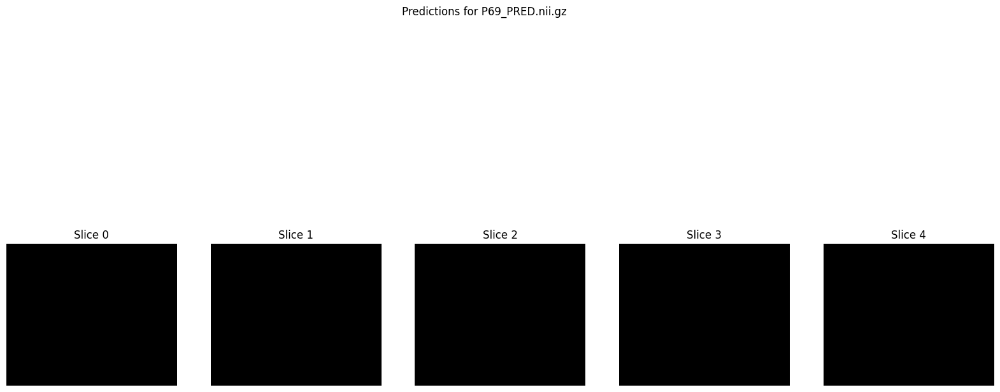

1/1 [==============================] - 0s 66ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnet_110/P54_PRED.nii.gz


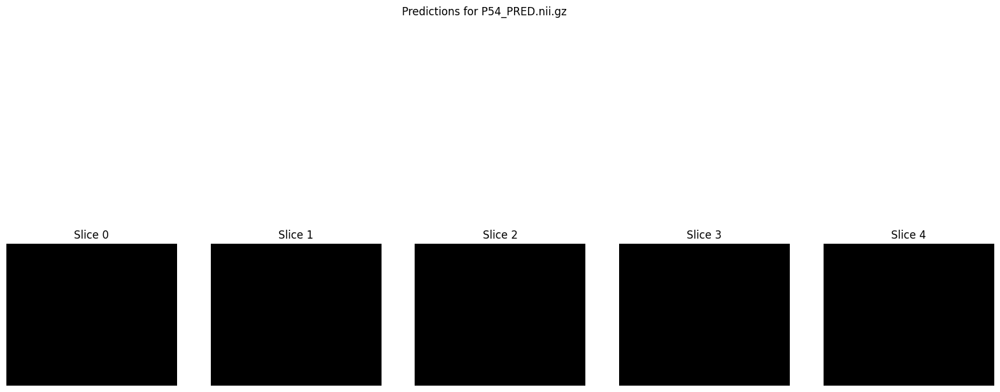

1/1 [==============================] - 0s 63ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnet_110/P55_PRED.nii.gz


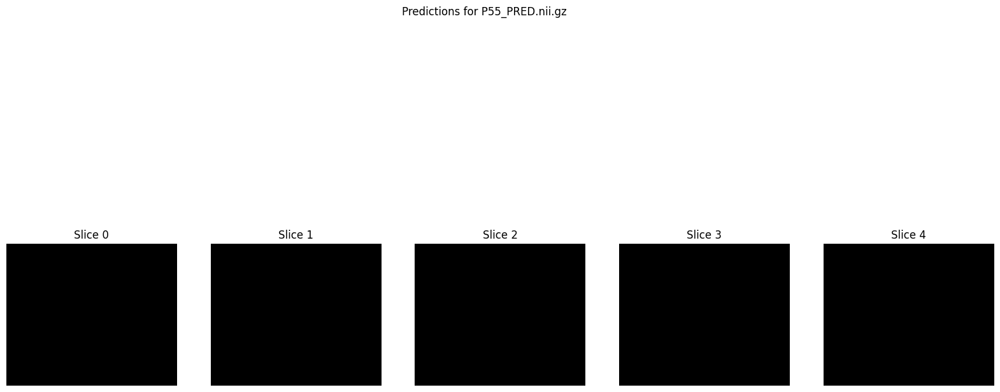

1/1 [==============================] - 0s 64ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnet_110/P56_PRED.nii.gz


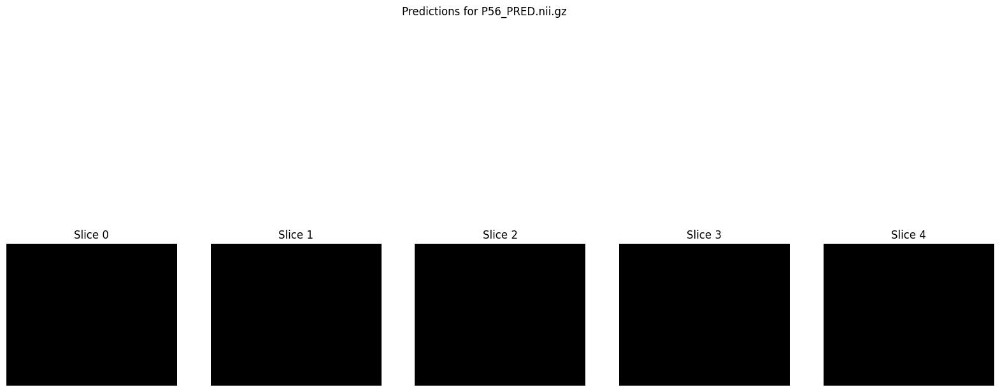

1/1 [==============================] - 0s 64ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnet_110/P57_PRED.nii.gz


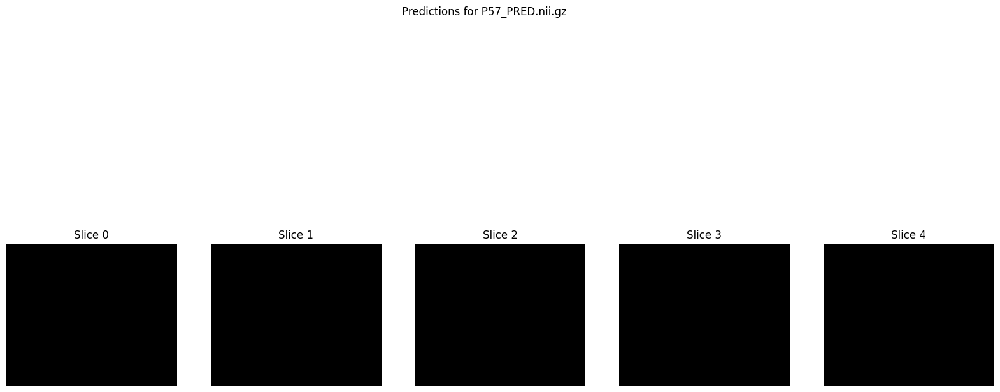

1/1 [==============================] - 0s 65ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnet_110/P58_PRED.nii.gz


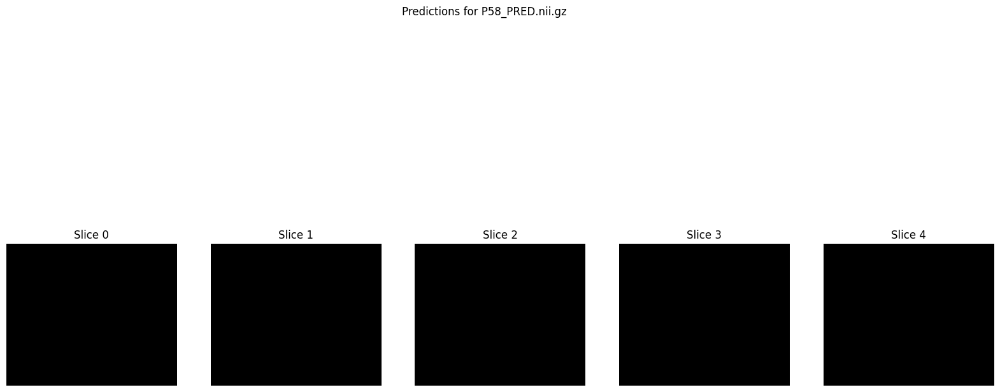

1/1 [==============================] - 0s 68ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnet_110/P59_PRED.nii.gz


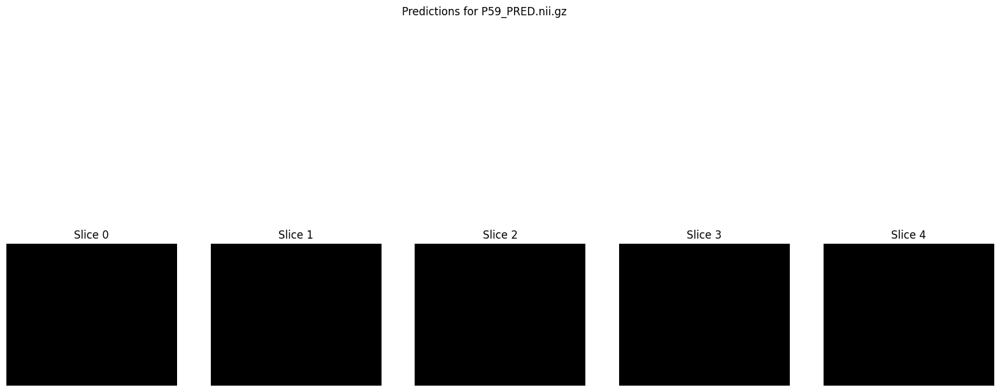

1/1 [==============================] - 0s 63ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSEfficientnet_110/P60_PRED.nii.gz


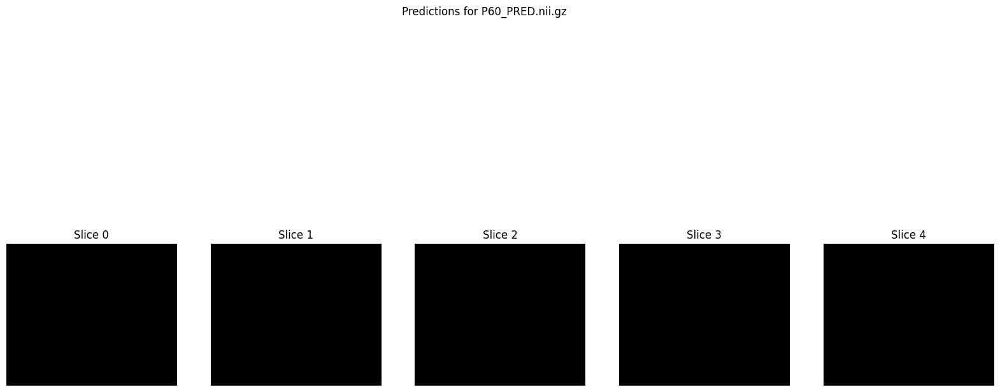

1/1 [==============================] - 0s 64ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSEfficientnet_110/P61_PRED.nii.gz


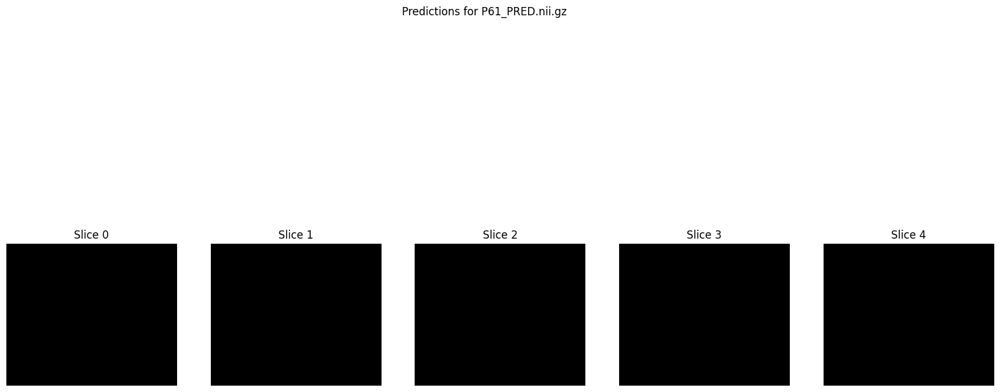

1/1 [==============================] - 0s 70ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSEfficientnet_110/P62_PRED.nii.gz


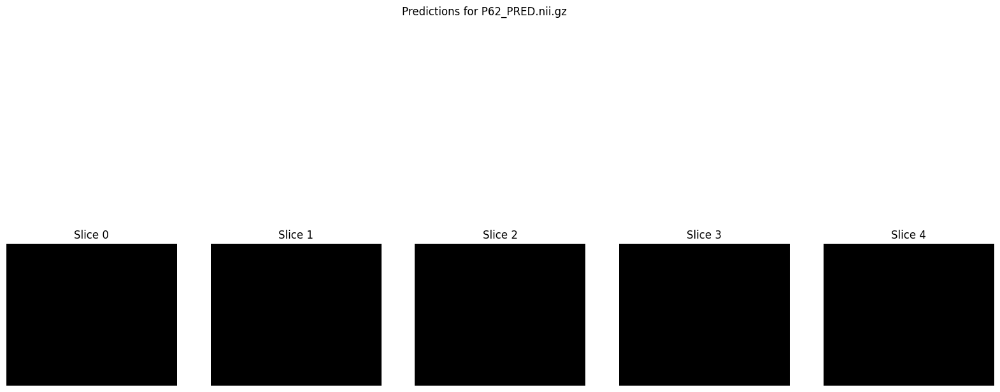

1/1 [==============================] - 0s 67ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSEfficientnet_110/P63_PRED.nii.gz


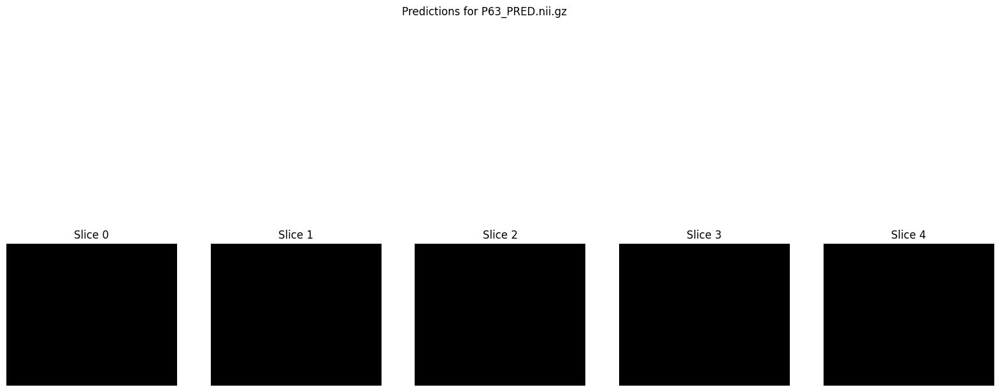

1/1 [==============================] - 0s 67ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSEfficientnet_110/P64_PRED.nii.gz


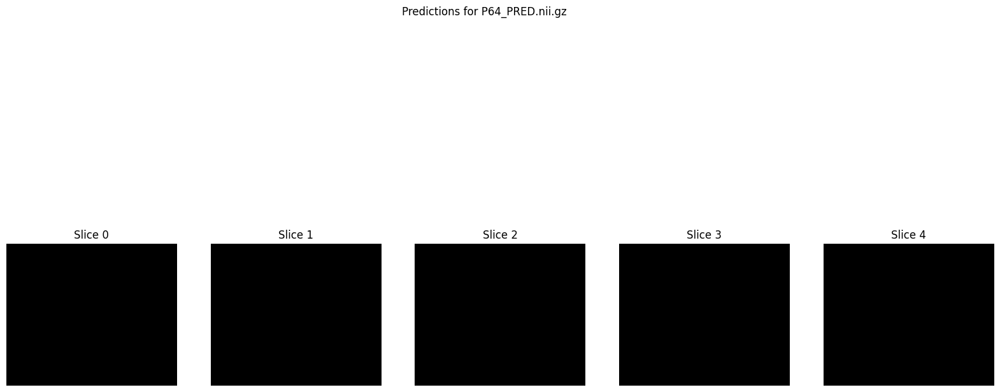

1/1 [==============================] - 0s 72ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSEfficientnet_110/P65_PRED.nii.gz


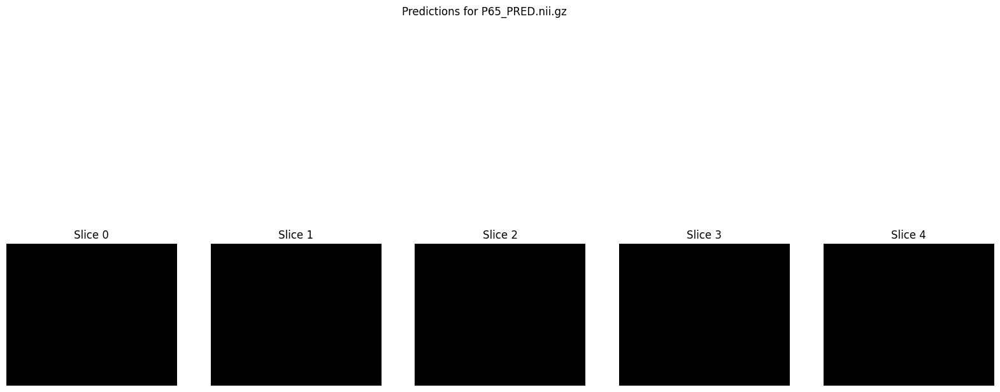

1/1 [==============================] - 0s 74ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSEfficientnet_110/P66_PRED.nii.gz


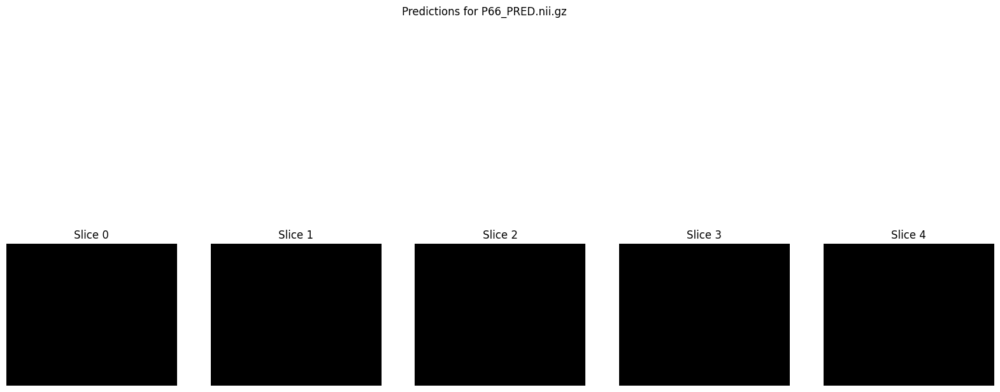

1/1 [==============================] - 0s 66ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSEfficientnet_110/P67_PRED.nii.gz


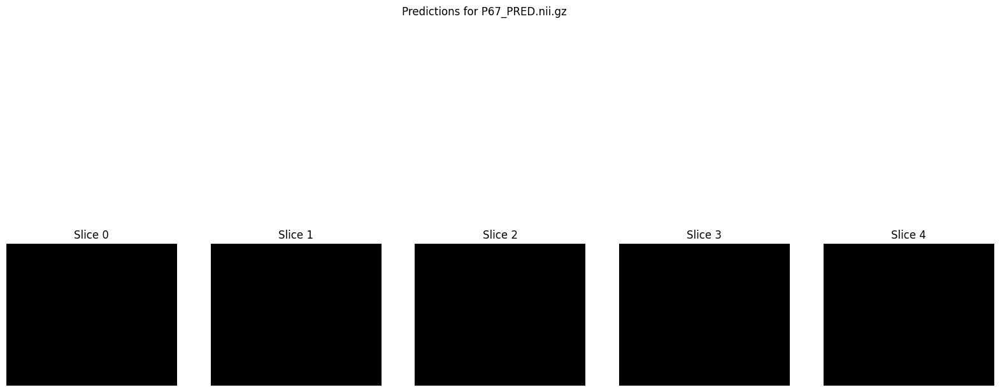

1/1 [==============================] - 0s 67ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSEfficientnet_110/P68_PRED.nii.gz


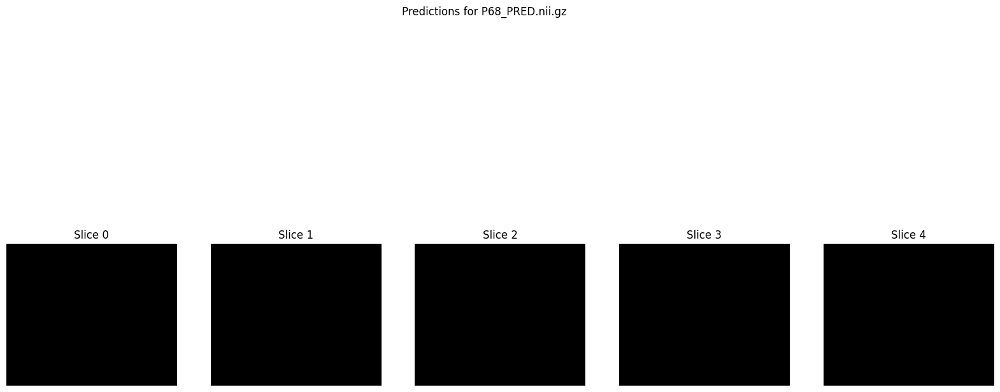

1/1 [==============================] - 0s 66ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSEfficientnet_110/P70_PRED.nii.gz


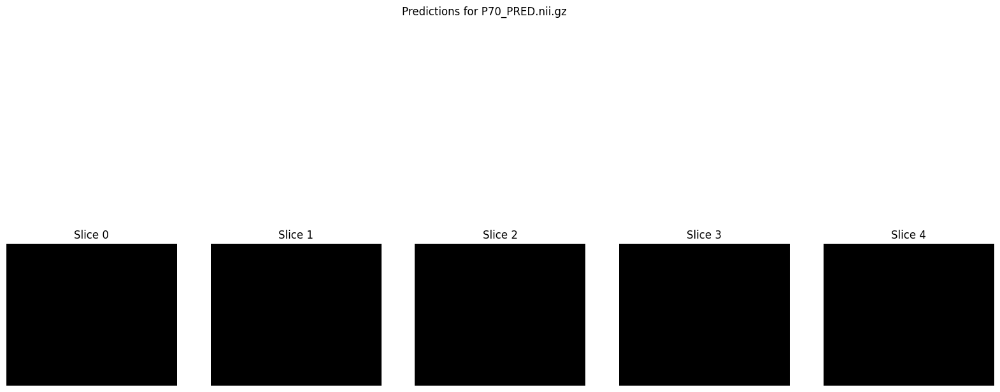

1/1 [==============================] - 0s 68ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSEfficientnet_110/P71_PRED.nii.gz


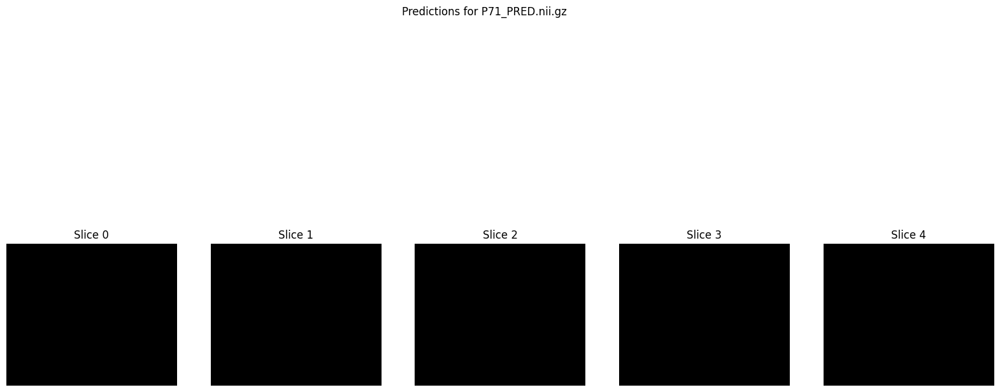

1/1 [==============================] - 0s 69ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSEfficientnet_110/P72_PRED.nii.gz


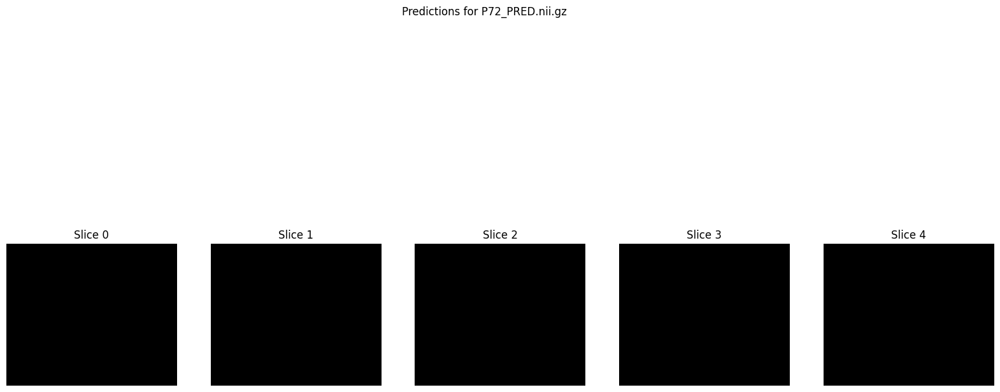

1/1 [==============================] - 0s 62ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSEfficientnet_110/P73_PRED.nii.gz


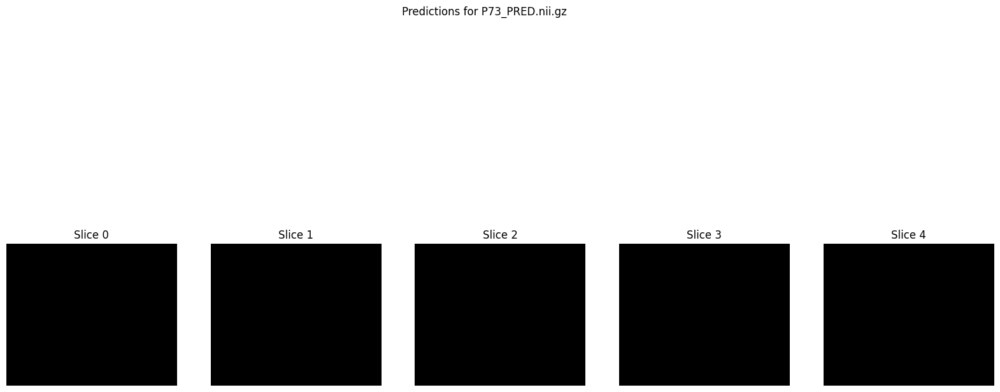

1/1 [==============================] - 0s 66ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSEfficientnet_110/P74_PRED.nii.gz


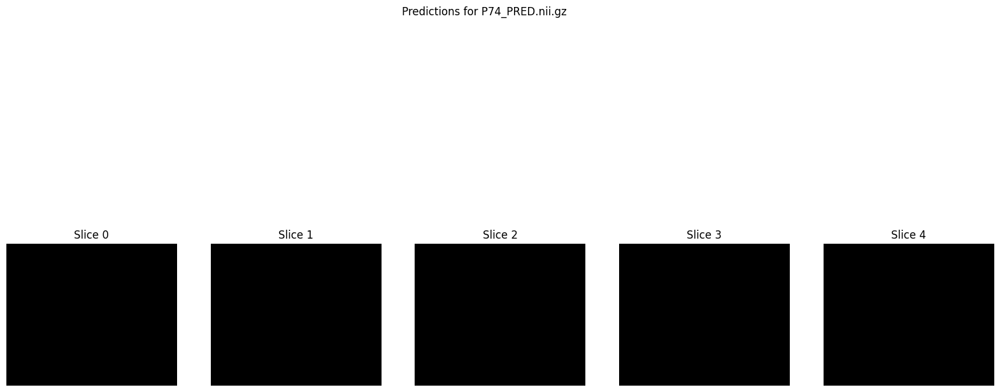

1/1 [==============================] - 0s 66ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSEfficientnet_110/P75_PRED.nii.gz


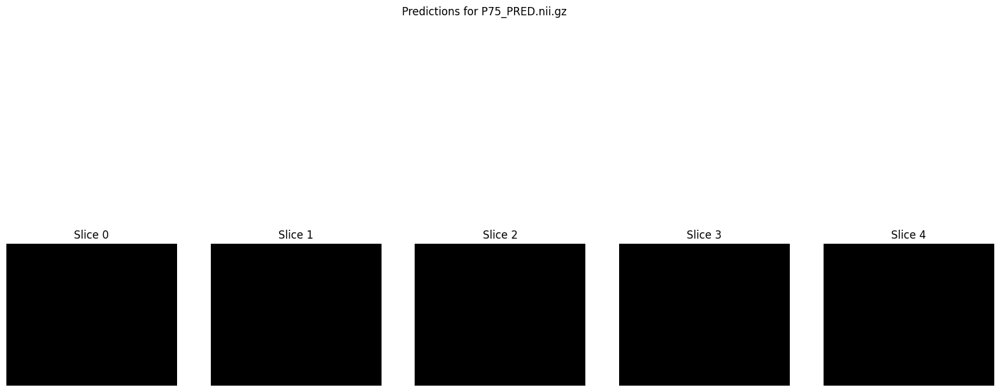

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnet_110'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.6

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 62ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSEfficientnet_0510/P69_PRED.nii.gz


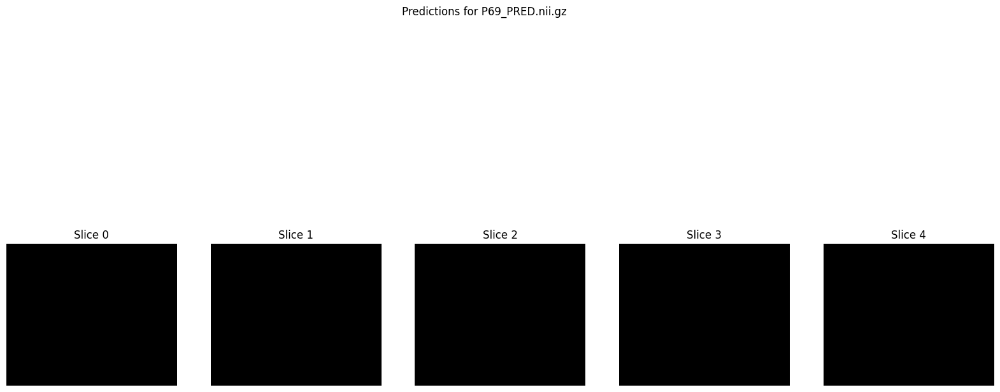

1/1 [==============================] - 0s 69ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSEfficientnet_0510/P54_PRED.nii.gz


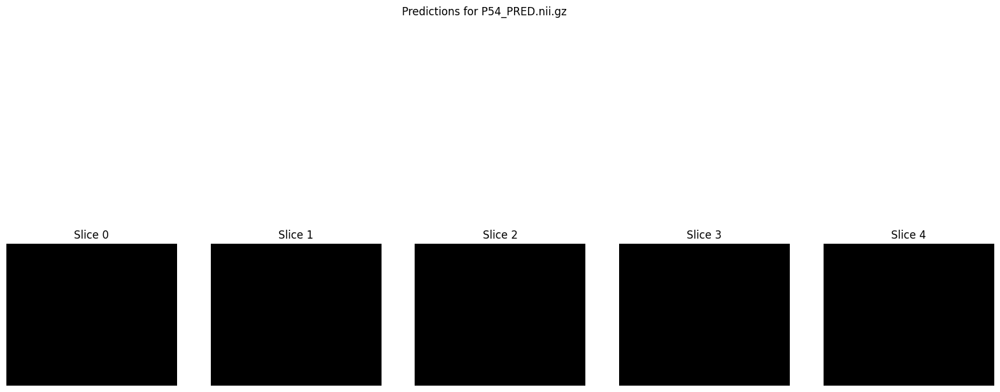

1/1 [==============================] - 0s 62ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSEfficientnet_0510/P55_PRED.nii.gz


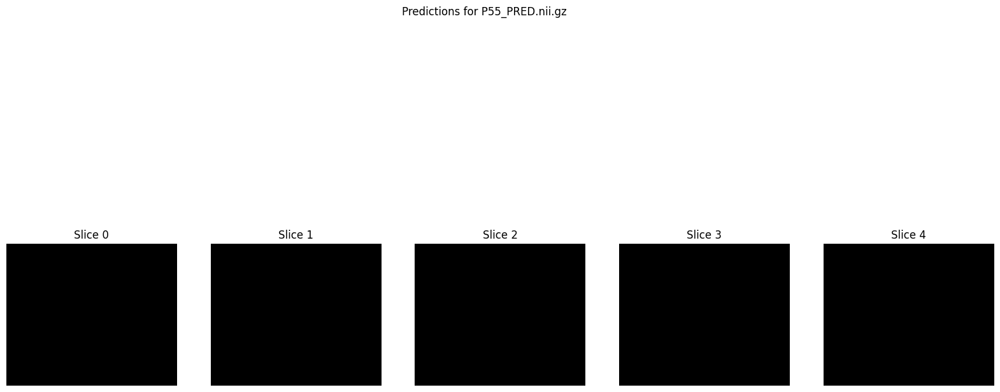

1/1 [==============================] - 0s 62ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSEfficientnet_0510/P56_PRED.nii.gz


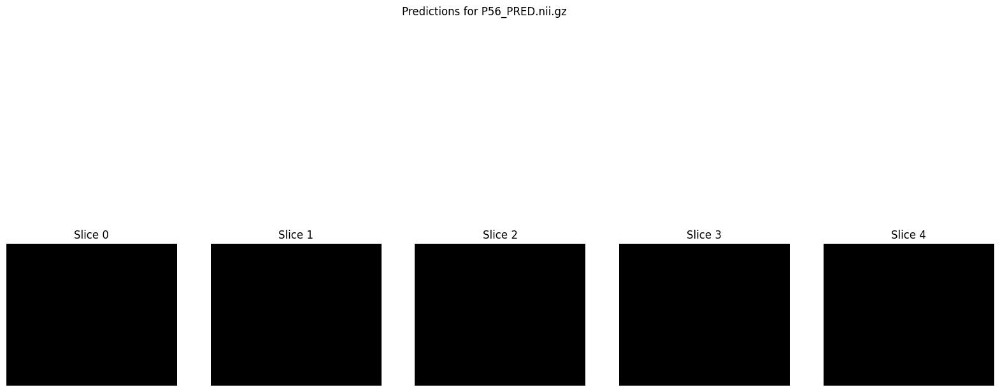

1/1 [==============================] - 0s 63ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSEfficientnet_0510/P57_PRED.nii.gz


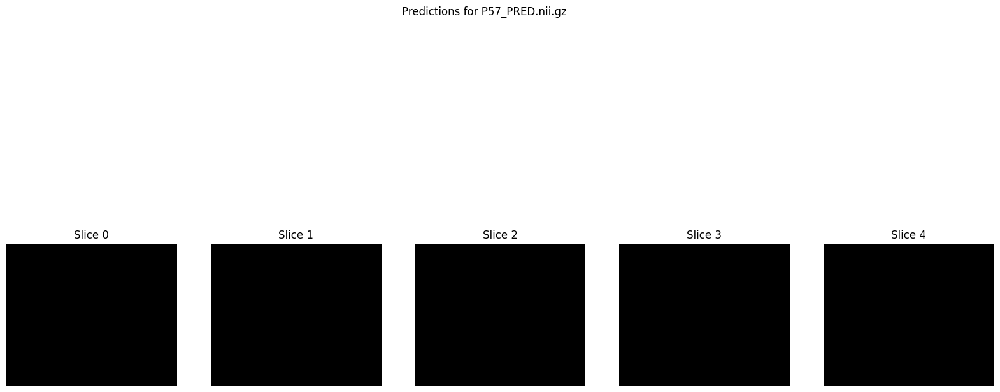

1/1 [==============================] - 0s 67ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSEfficientnet_0510/P58_PRED.nii.gz


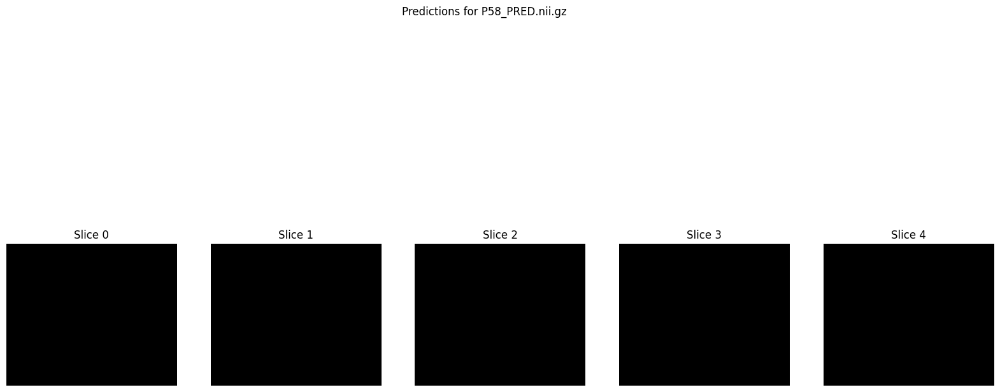

1/1 [==============================] - 0s 63ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSEfficientnet_0510/P59_PRED.nii.gz


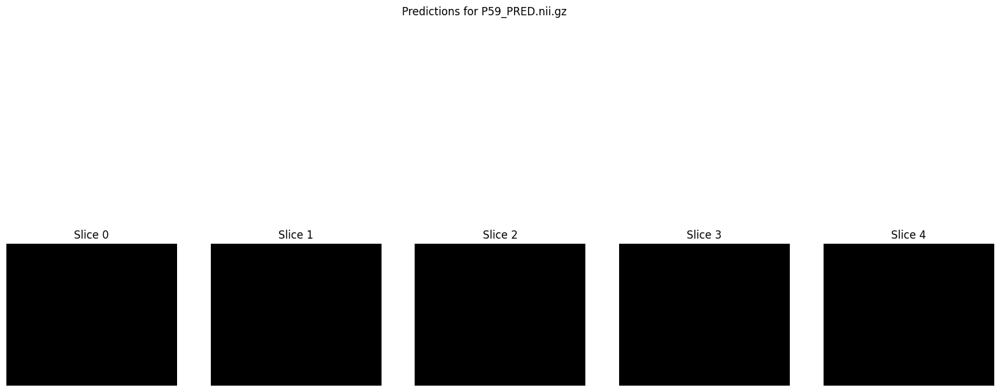

1/1 [==============================] - 0s 63ms/step


KeyboardInterrupt: 

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSEfficientnet_0510'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**DENSENET121**

In [ ]:
BACKBONE = 'densenet121'
model = Unet(BACKBONE, input_shape=(128, 128, 2), encoder_weights=None, encoder_freeze=False, classes=1, activation='sigmoid')
# Add dropout layer
dropout = Dropout(0.5)(model.output)
# Compile the model
model.compile('Adam', loss=weighted_binary_crossentropy(class_weights), metrics=[dice_coefficient])

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=False, dpi=64)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.202599 to fit



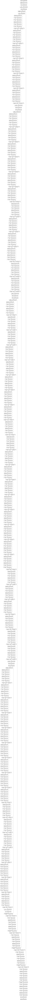

In [ ]:
tf.keras.utils.plot_model(model, to_file='model_plot.png', show_shapes=True, expand_nested=True, dpi=300)

In [ ]:
with Image.open('model_plot.png') as img:
    # Rotate image
    img = img.rotate(90, expand=True)
    # Save image
    img.save('model_plot.png')

**Class weights [0.50202403, 124.01598644]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint_true.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_true.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.4184 - dice_coefficient: 0.0242
Epoch 1: val_loss improved from inf to 0.64741, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_true.h5
312/312 [==============================] - 255s 781ms/step - loss: 0.4184 - dice_coefficient: 0.0242 - val_loss: 0.6474 - val_dice_coefficient: 0.0117
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.3099 - dice_coefficient: 0.0434
Epoch 2: val_loss improved from 0.64741 to 0.38485, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_true.h5
312/312 [==============================] - 239s 766ms/step - loss: 0.3099 - dice_coefficient: 0.0434 - val_loss: 0.3849 - val_dice_coefficient: 0.0226
Epoch 3/100
312/312 [==============================] - ETA: 0s -

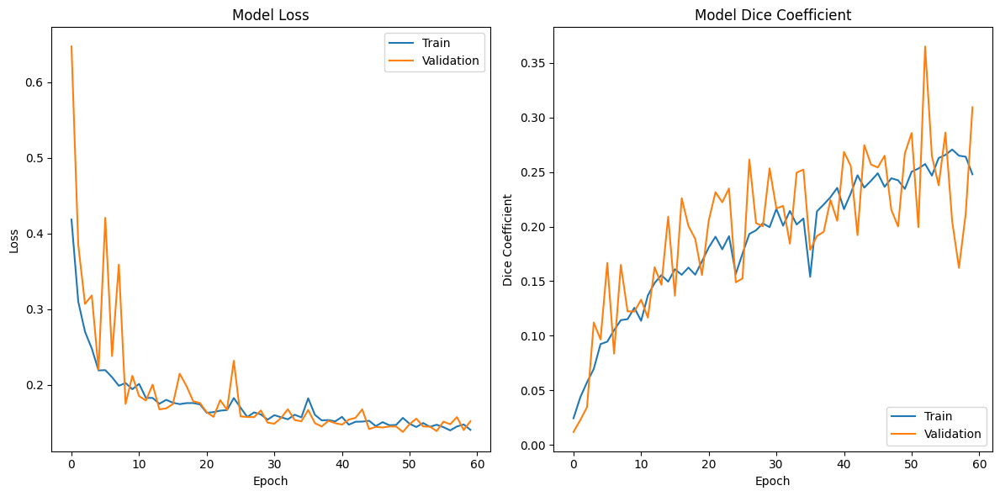

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

Determine the threshold for the sigmoid function

In [ ]:
# Preprocess input and predict functions
def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        combined_image.fill(0)
    return combined_image

def predict_slice(t2_slice, flair_slice, threshold):
    combined_slice = preprocess_input(t2_slice, flair_slice)
    combined_slice = np.expand_dims(combined_slice, axis=0)
    pred_slice = model.predict(combined_slice)
    pred_slice = (pred_slice > threshold).astype(np.float32)
    return pred_slice.squeeze()

# Define the Dice coefficient to ensure the same type for inputs
def dice_coefficient(y_true, y_pred):
    y_true = tf.cast(y_true, tf.float32)
    y_pred = tf.cast(y_pred, tf.float32)
    y_true_f = tf.keras.backend.flatten(y_true)
    y_pred_f = tf.keras.backend.flatten(y_pred)
    intersection = tf.keras.backend.sum(y_true_f * y_pred_f)
    return (2. * intersection + 1) / (tf.keras.backend.sum(y_true_f) + tf.keras.backend.sum(y_pred_f) + 1)

# Find the best threshold
best_threshold = 0.5
best_dice = 0.0
thresholds = np.arange(0.1, 0.9, 0.1)

for threshold in thresholds:
    dice_scores = []
    for i in range(val_inputs.shape[0]):
        t2_image = val_inputs[i, :, :, 0]
        flair_image = val_inputs[i, :, :, 1]
        ground_truth = val_masks[i, :, :, 0]

        prediction = predict_slice(t2_image, flair_image, threshold)
        dice_score = dice_coefficient(ground_truth, prediction)
        dice_scores.append(dice_score)

    mean_dice = np.mean(dice_scores)
    if mean_dice > best_dice:
        best_dice = mean_dice
        best_threshold = threshold

print(f'Best threshold: {best_threshold} with mean Dice score: {best_dice}')

Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 59ms/step
Best threshold: 0.8 with mean Dice score: 0.6995459198951721


**TESTING**

1/1 [==============================] - 0s 68ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSDensenet_true/P69_PRED.nii.gz


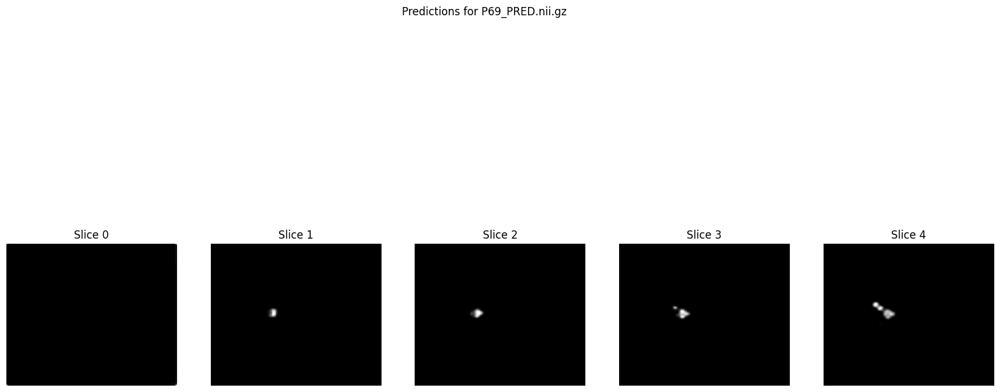

1/1 [==============================] - 0s 71ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSDensenet_true/P54_PRED.nii.gz


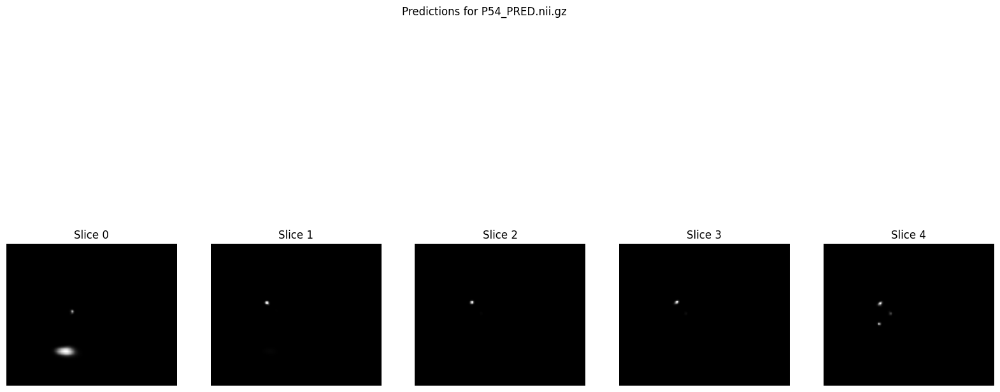

1/1 [==============================] - 0s 70ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSDensenet_true/P55_PRED.nii.gz


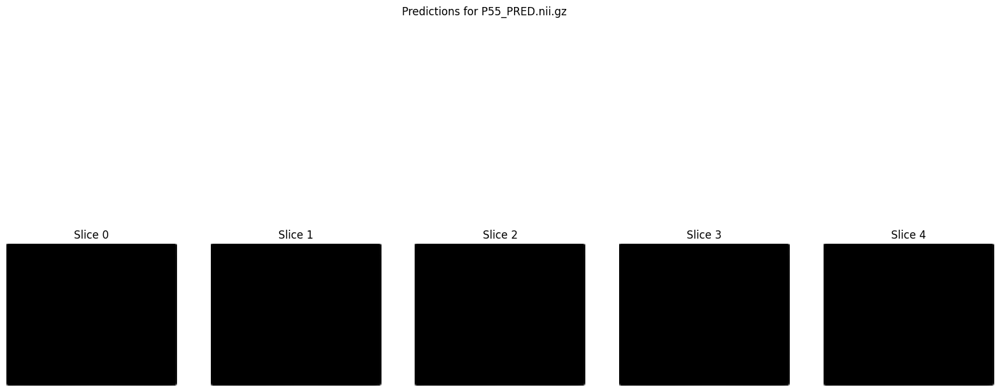

1/1 [==============================] - 0s 62ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSDensenet_true/P56_PRED.nii.gz


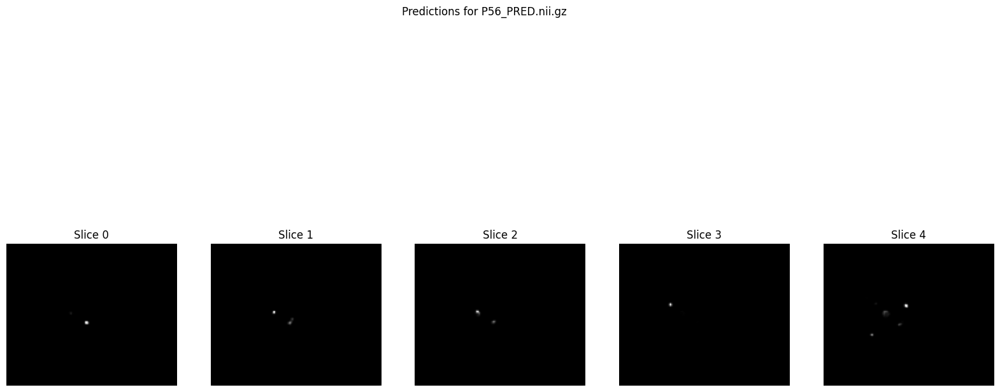

1/1 [==============================] - 0s 70ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSDensenet_true/P57_PRED.nii.gz


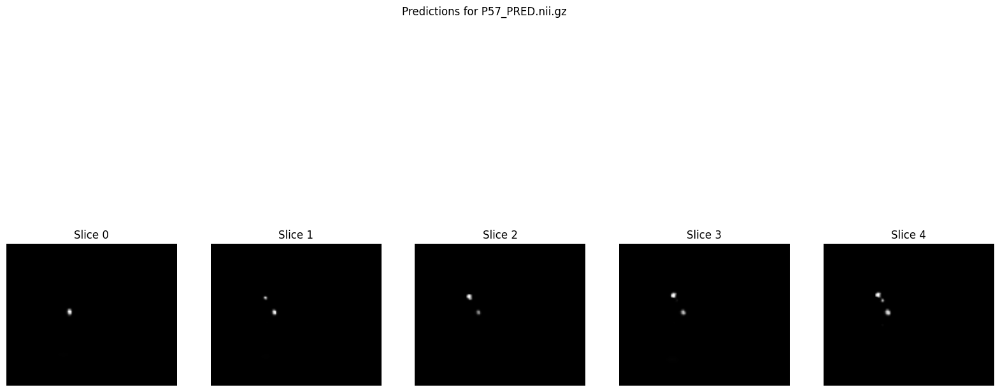

1/1 [==============================] - 0s 71ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSDensenet_true/P58_PRED.nii.gz


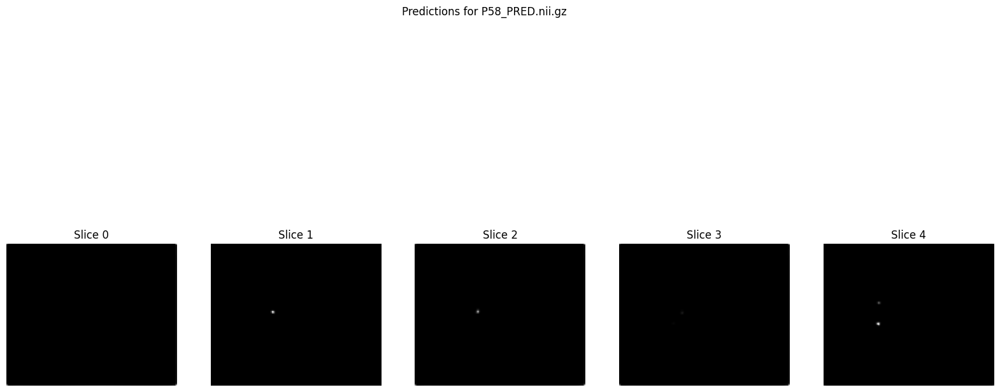

1/1 [==============================] - 0s 71ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSDensenet_true/P59_PRED.nii.gz


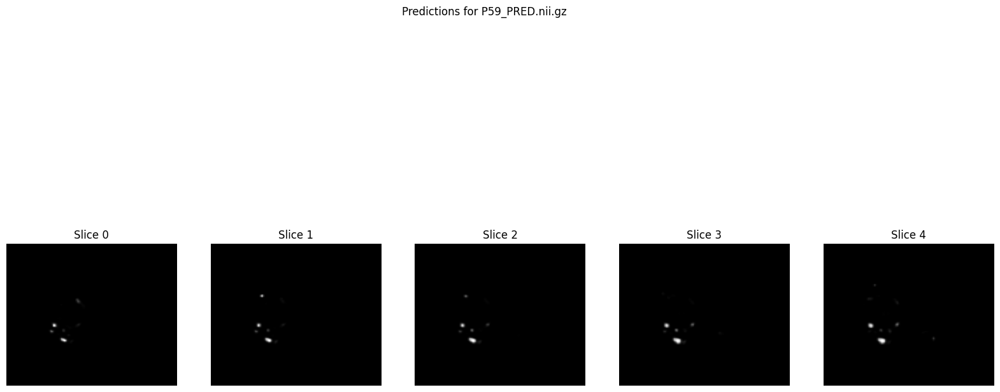

1/1 [==============================] - 0s 74ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSDensenet_true/P60_PRED.nii.gz


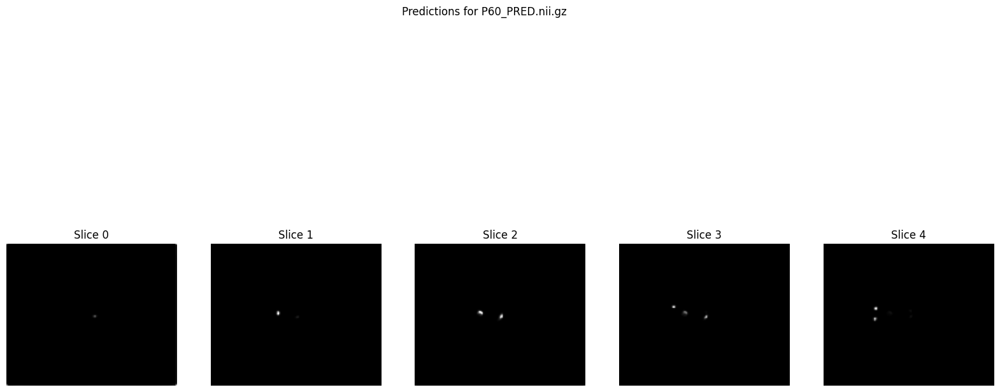

1/1 [==============================] - 0s 68ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSDensenet_true/P61_PRED.nii.gz


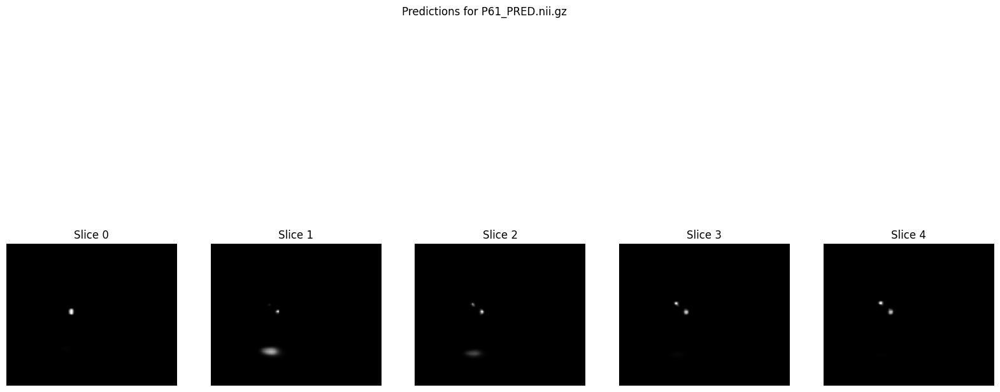

1/1 [==============================] - 0s 72ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSDensenet_true/P62_PRED.nii.gz


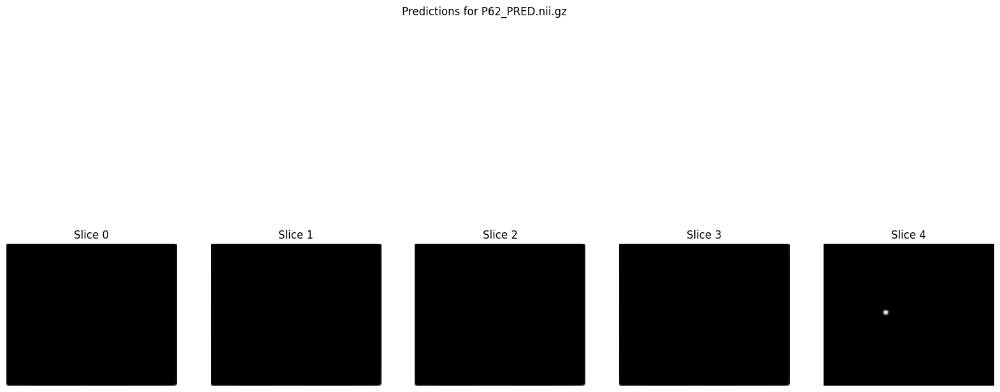

1/1 [==============================] - 0s 77ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSDensenet_true/P63_PRED.nii.gz


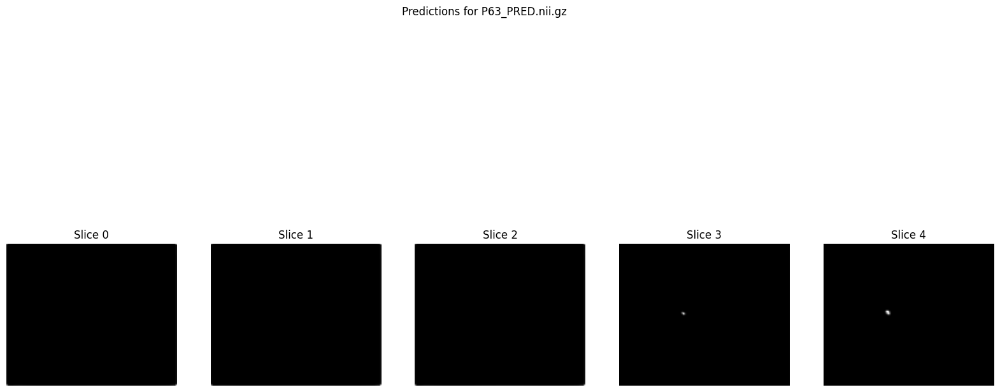

1/1 [==============================] - 0s 72ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSDensenet_true/P64_PRED.nii.gz


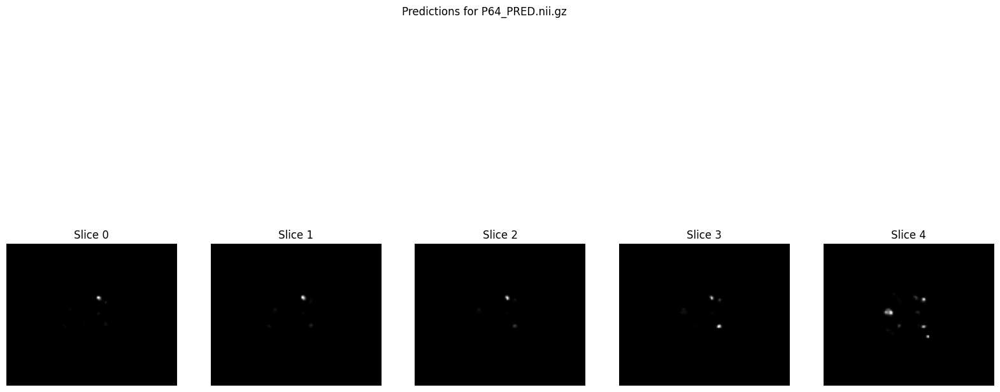

1/1 [==============================] - 0s 68ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSDensenet_true/P65_PRED.nii.gz


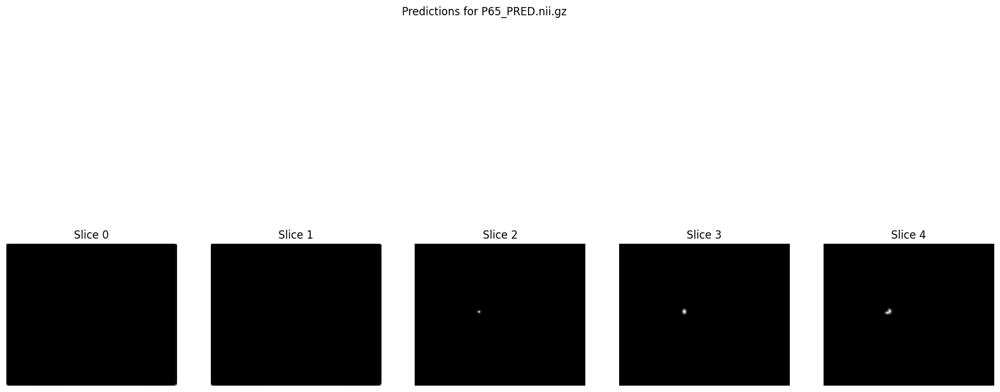

1/1 [==============================] - 0s 73ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSDensenet_true/P66_PRED.nii.gz


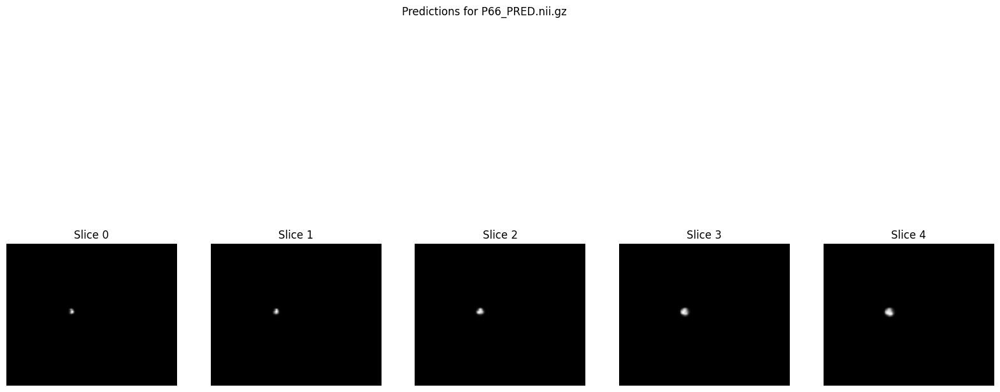

1/1 [==============================] - 0s 69ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSDensenet_true/P67_PRED.nii.gz


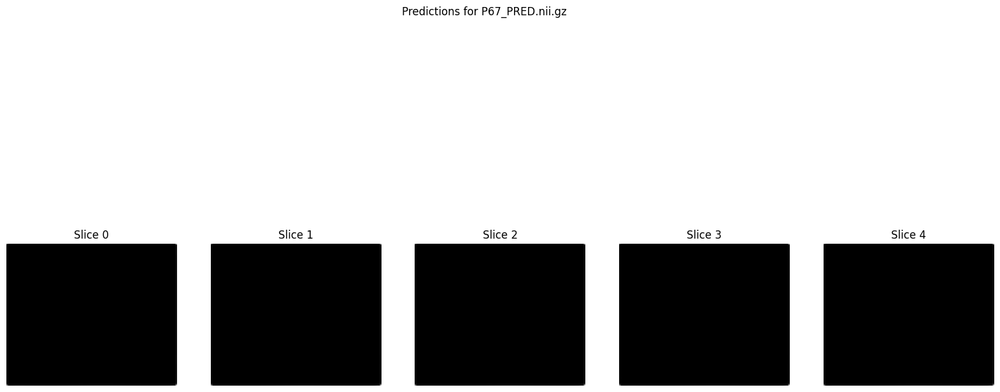

1/1 [==============================] - 0s 71ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSDensenet_true/P68_PRED.nii.gz


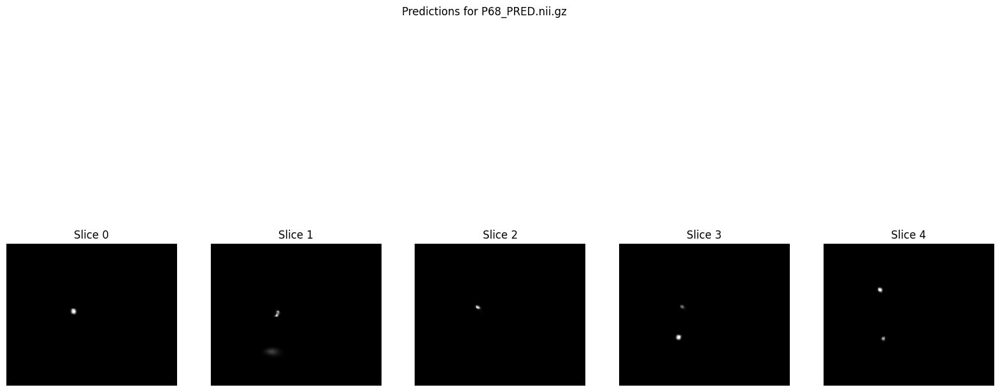

1/1 [==============================] - 0s 73ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSDensenet_true/P70_PRED.nii.gz


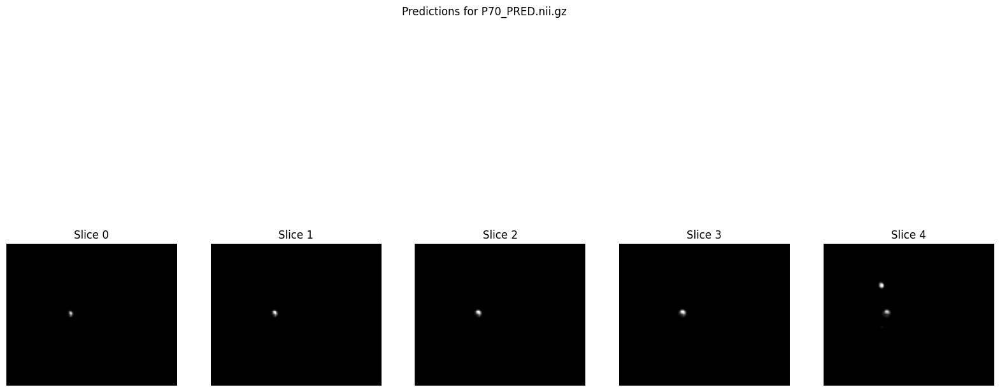

1/1 [==============================] - 0s 70ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSDensenet_true/P71_PRED.nii.gz


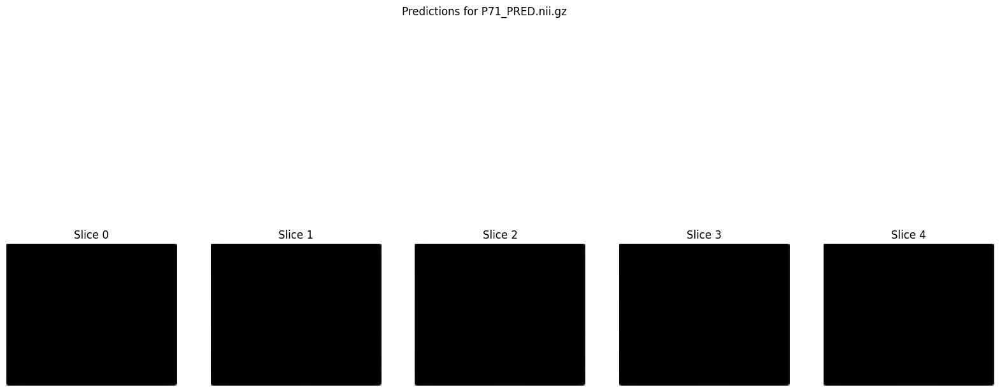

1/1 [==============================] - 0s 73ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSDensenet_true/P72_PRED.nii.gz


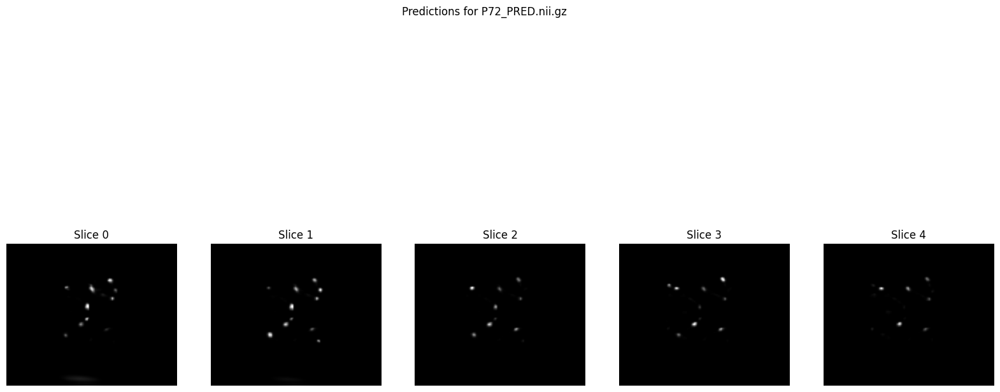

1/1 [==============================] - 0s 73ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSDensenet_true/P73_PRED.nii.gz


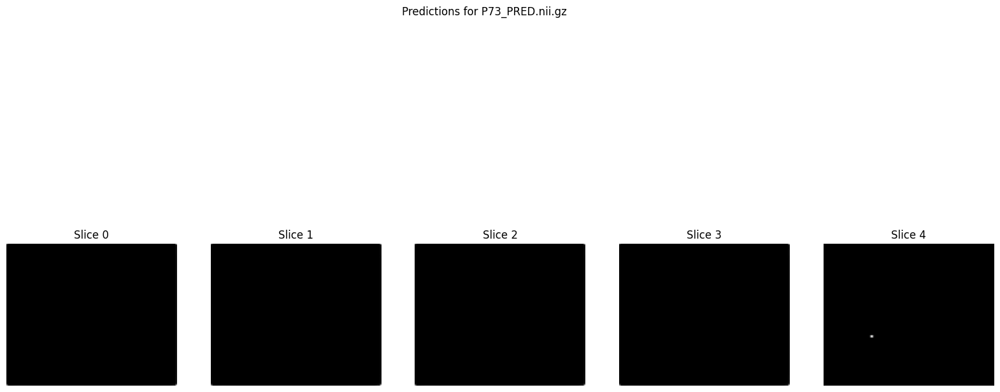

1/1 [==============================] - 0s 69ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSDensenet_true/P74_PRED.nii.gz


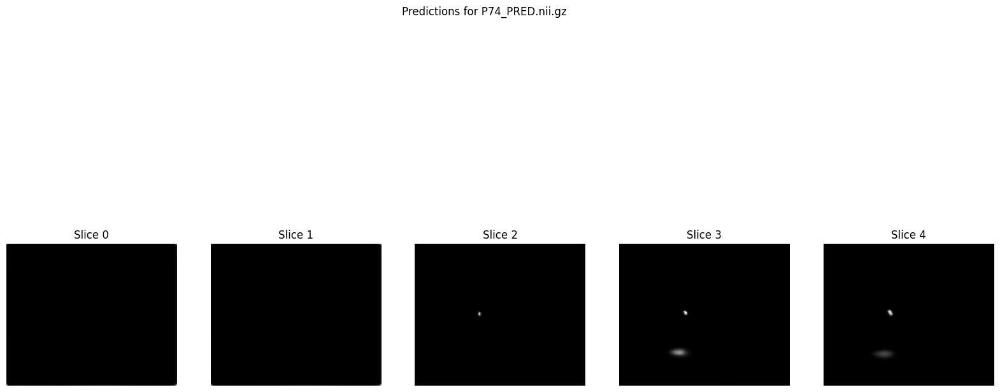

1/1 [==============================] - 0s 72ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSDensenet_true/P75_PRED.nii.gz


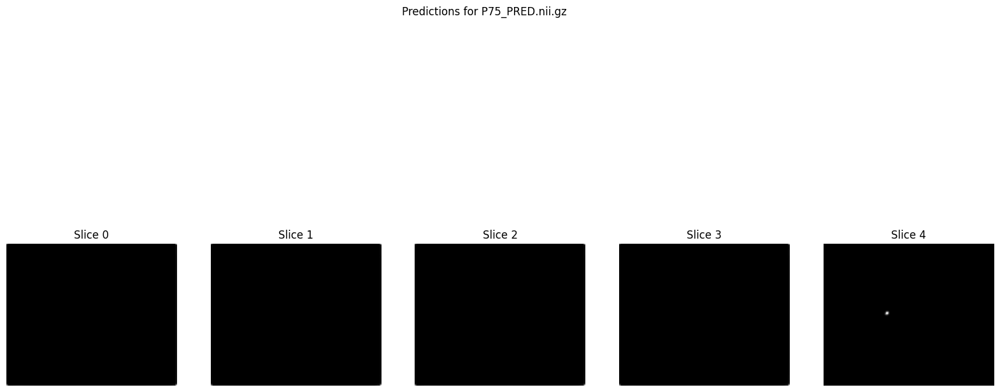

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint_true.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.50202403, 124.01598644])})

# Create the output directory if it doesn't exist
output_dir = './MASKSDensenet_true'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**Class wieghts [0.5, 10.0]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint_0510.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_0510.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.0981 - dice_coefficient: 0.0418
Epoch 1: val_loss improved from inf to 0.13709, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_0510.h5
312/312 [==============================] - 255s 778ms/step - loss: 0.0981 - dice_coefficient: 0.0418 - val_loss: 0.1371 - val_dice_coefficient: 0.0487
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0540 - dice_coefficient: 0.1324
Epoch 2: val_loss improved from 0.13709 to 0.07131, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_0510.h5
312/312 [==============================] - 240s 769ms/step - loss: 0.0540 - dice_coefficient: 0.1324 - val_loss: 0.0713 - val_dice_coefficient: 0.1568
Epoch 3/100
312/312 [==============================] - ETA: 0s -

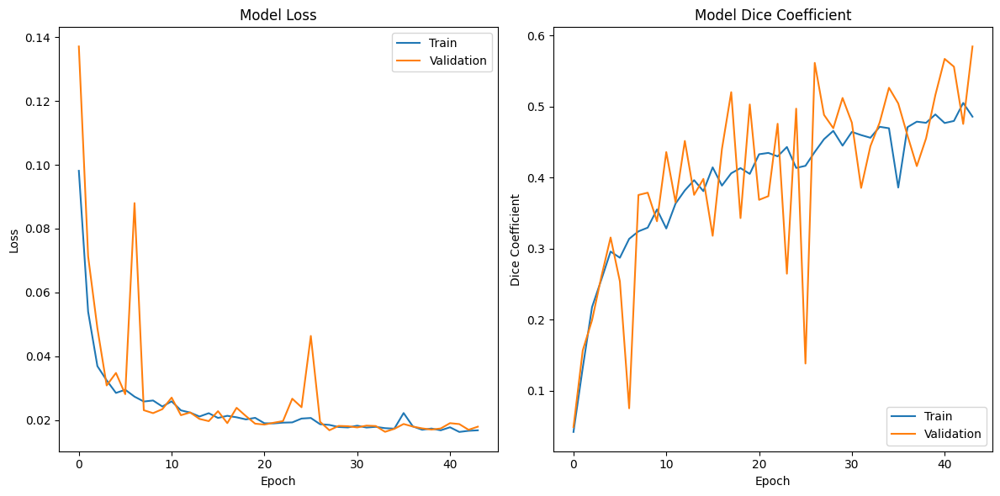

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

**TESTING**

1/1 [==============================] - 0s 70ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSDensenet_0510/P69_PRED.nii.gz


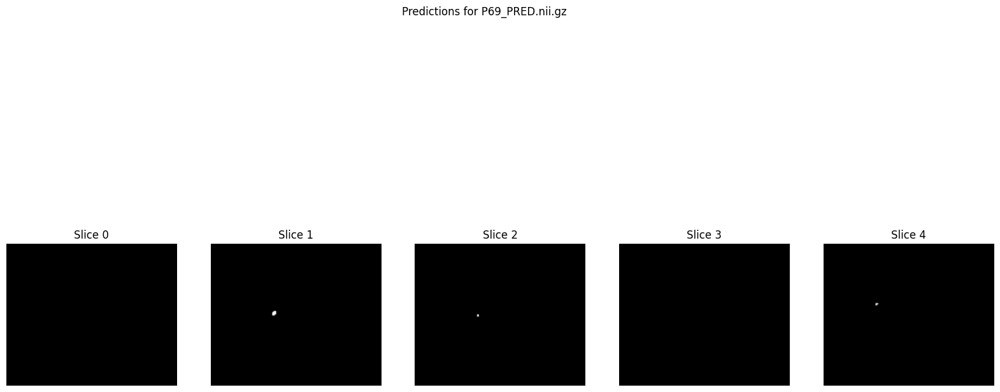

1/1 [==============================] - 0s 68ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSDensenet_0510/P54_PRED.nii.gz


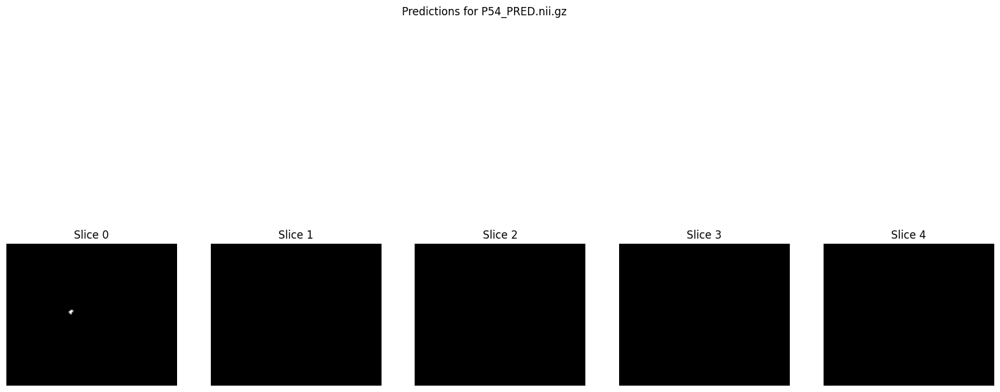

1/1 [==============================] - 0s 68ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSDensenet_0510/P55_PRED.nii.gz


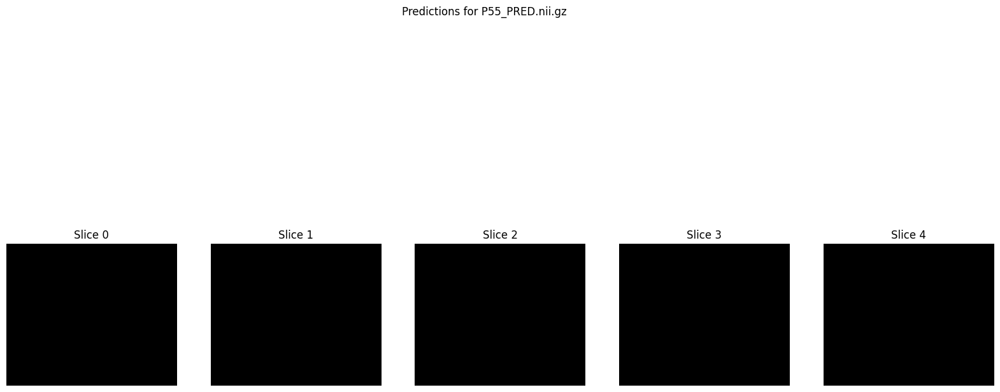

1/1 [==============================] - 0s 72ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSDensenet_0510/P56_PRED.nii.gz


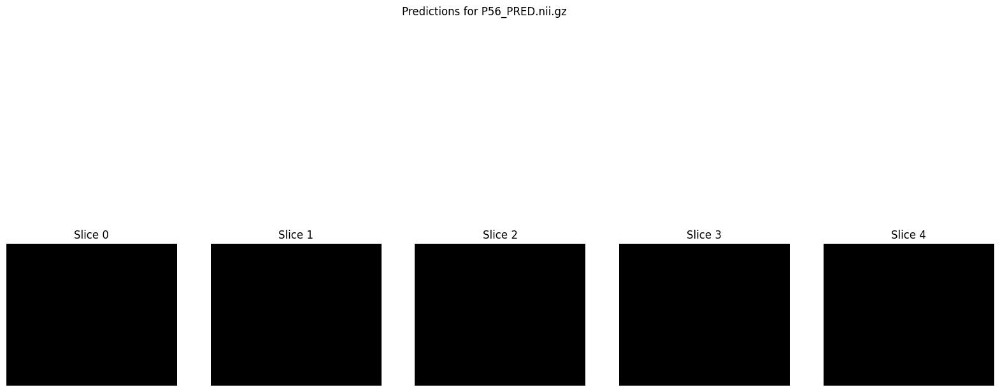

1/1 [==============================] - 0s 70ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSDensenet_0510/P57_PRED.nii.gz


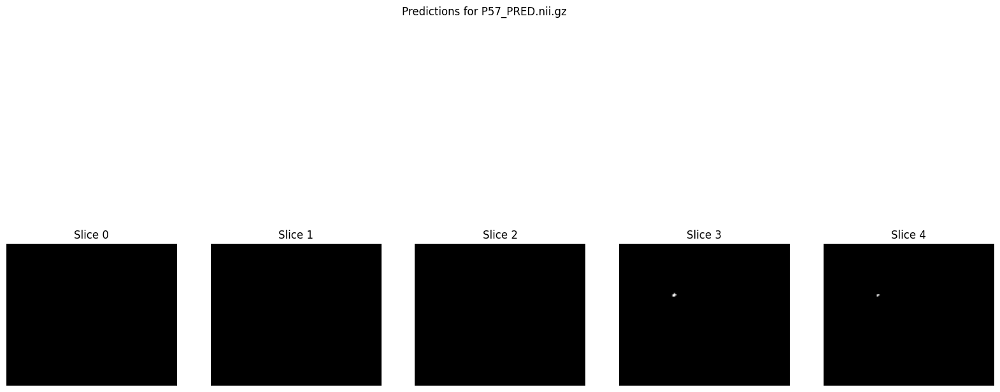

1/1 [==============================] - 0s 69ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSDensenet_0510/P58_PRED.nii.gz


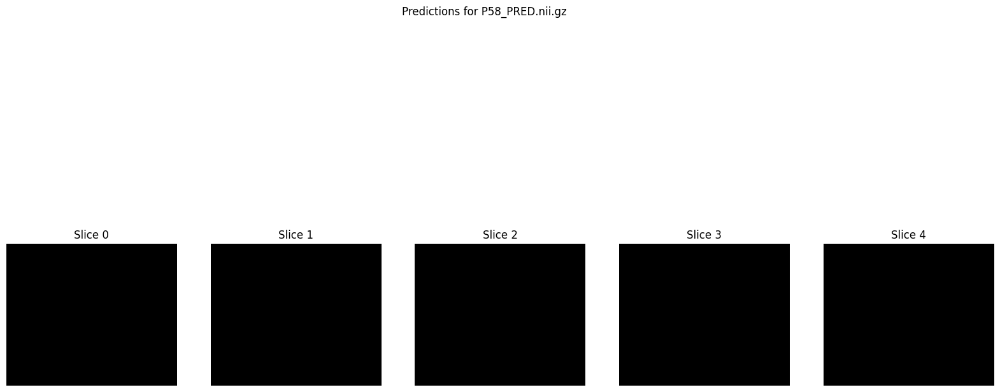

1/1 [==============================] - 0s 67ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSDensenet_0510/P59_PRED.nii.gz


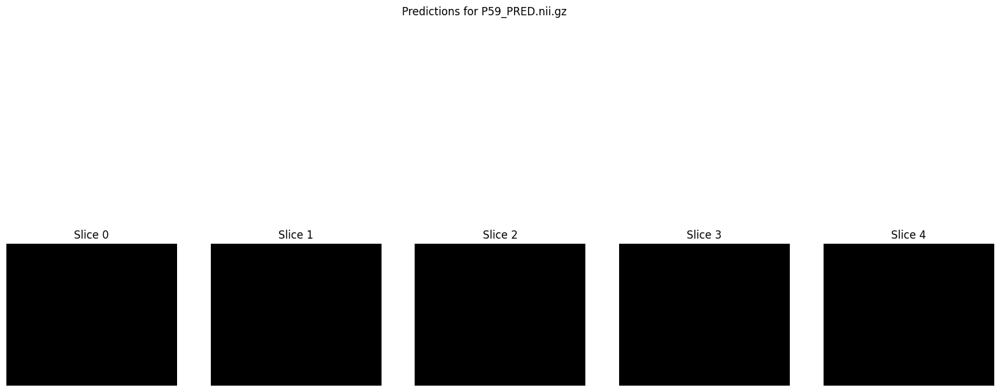

1/1 [==============================] - 0s 69ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSDensenet_0510/P60_PRED.nii.gz


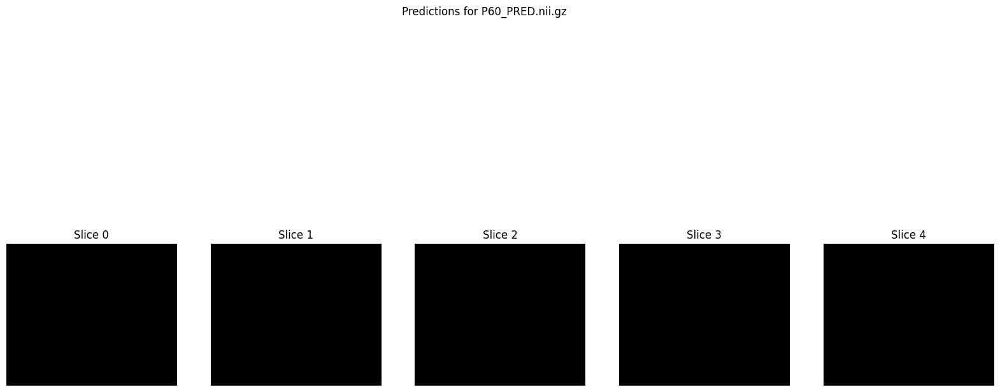

1/1 [==============================] - 0s 68ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSDensenet_0510/P61_PRED.nii.gz


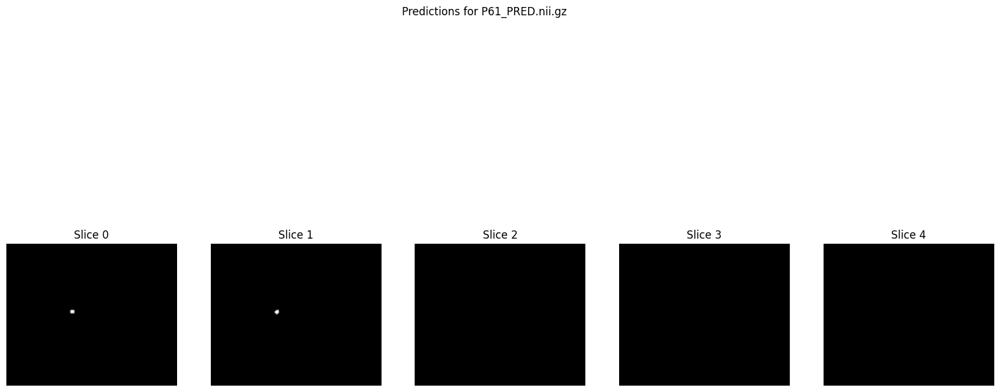

1/1 [==============================] - 0s 66ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSDensenet_0510/P62_PRED.nii.gz


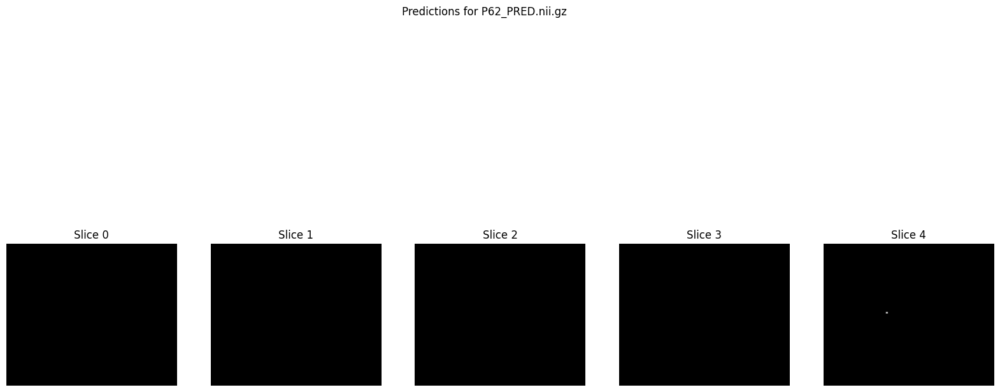

1/1 [==============================] - 0s 72ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSDensenet_0510/P63_PRED.nii.gz


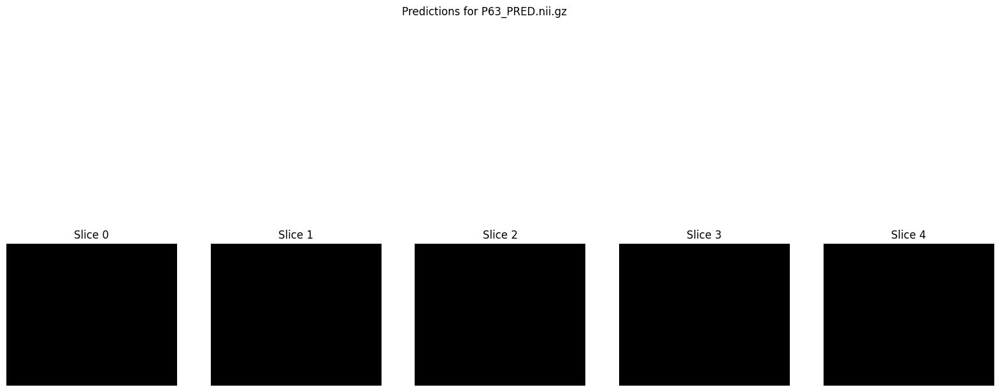

1/1 [==============================] - 0s 64ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSDensenet_0510/P64_PRED.nii.gz


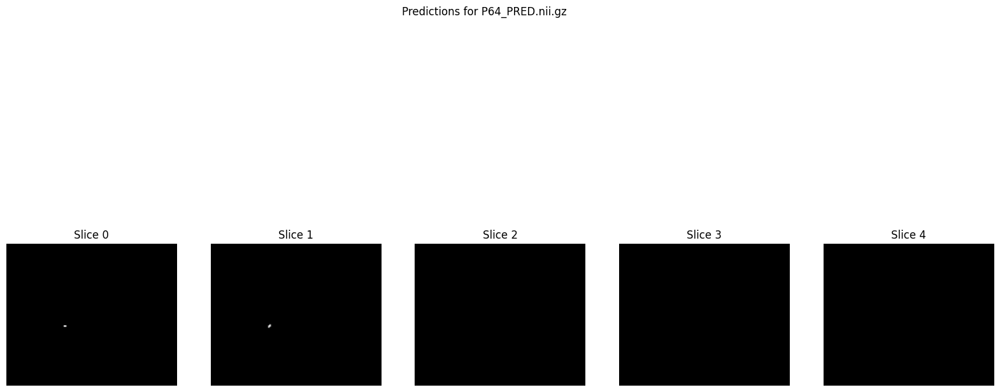

1/1 [==============================] - 0s 78ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSDensenet_0510/P65_PRED.nii.gz


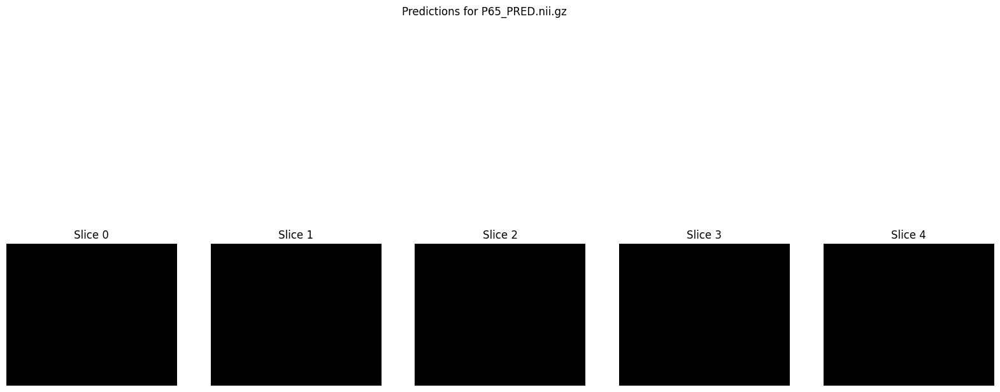

1/1 [==============================] - 0s 67ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSDensenet_0510/P66_PRED.nii.gz


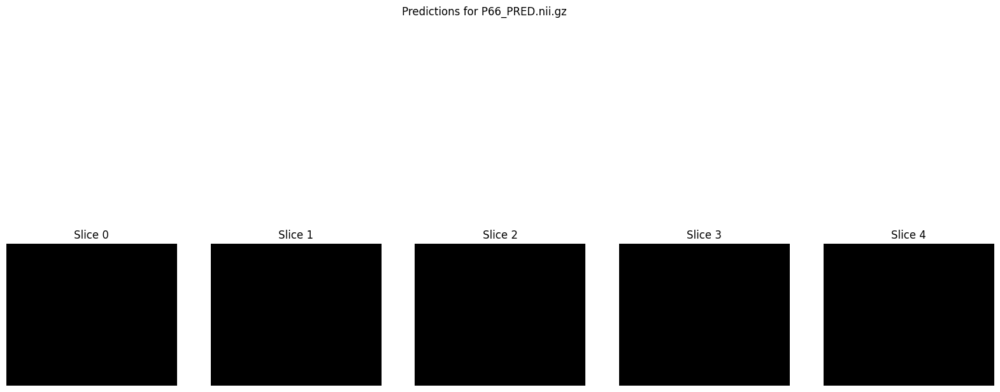

1/1 [==============================] - 0s 72ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSDensenet_0510/P67_PRED.nii.gz


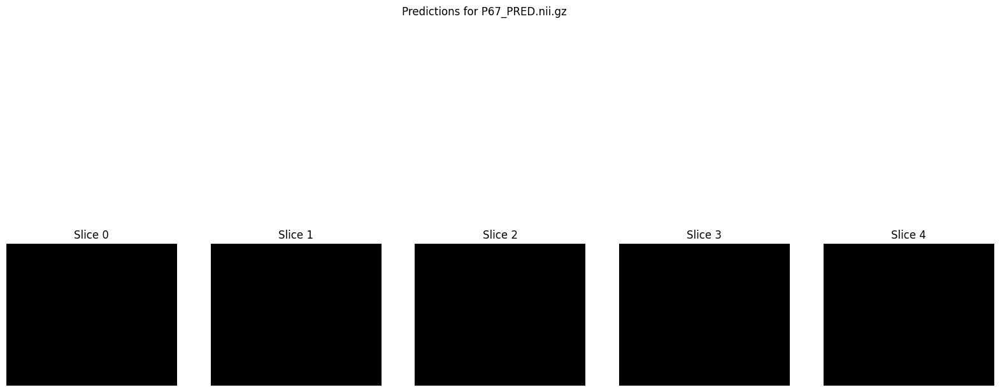

1/1 [==============================] - 0s 71ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSDensenet_0510/P68_PRED.nii.gz


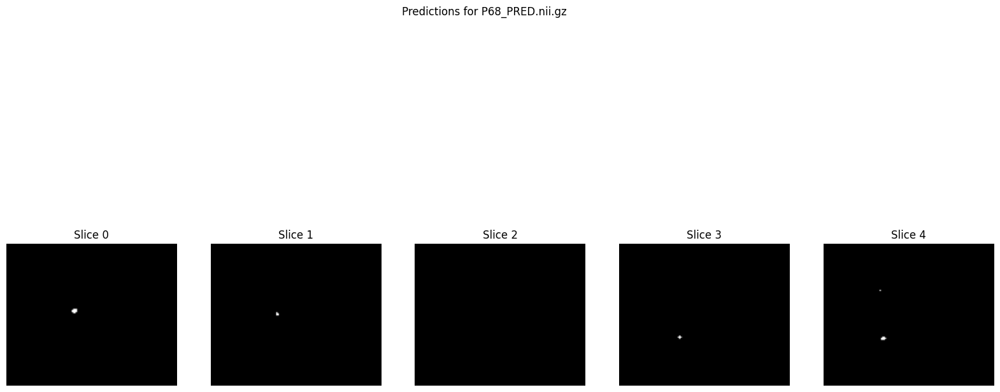

1/1 [==============================] - 0s 69ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSDensenet_0510/P70_PRED.nii.gz


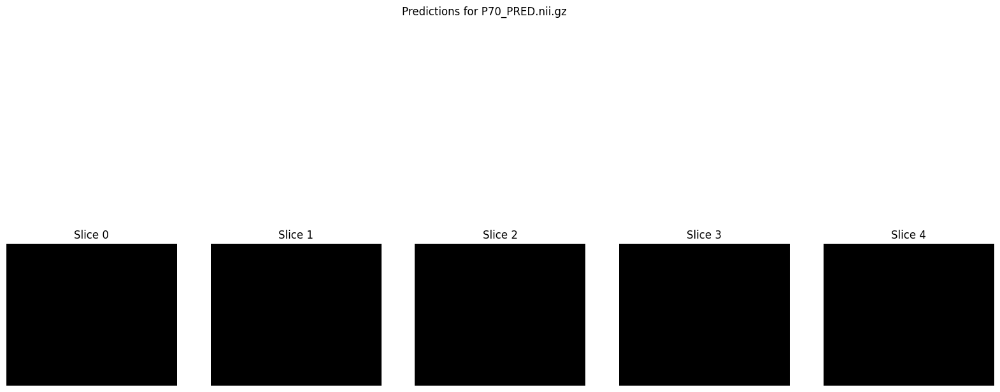

1/1 [==============================] - 0s 66ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSDensenet_0510/P71_PRED.nii.gz


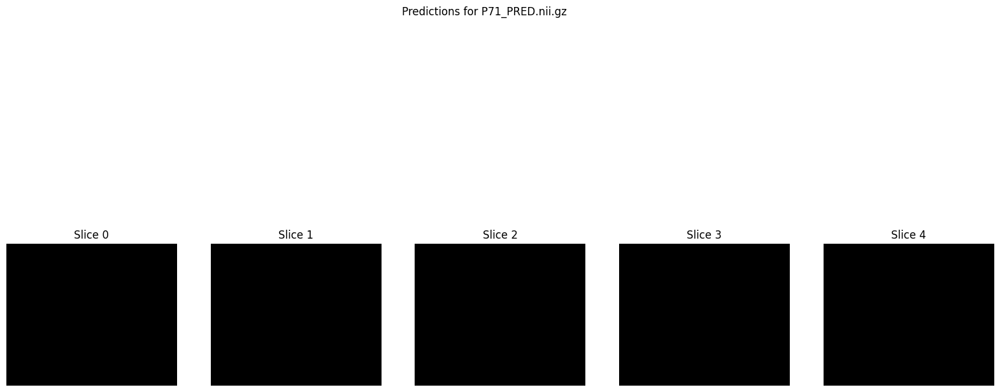

1/1 [==============================] - 0s 70ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSDensenet_0510/P72_PRED.nii.gz


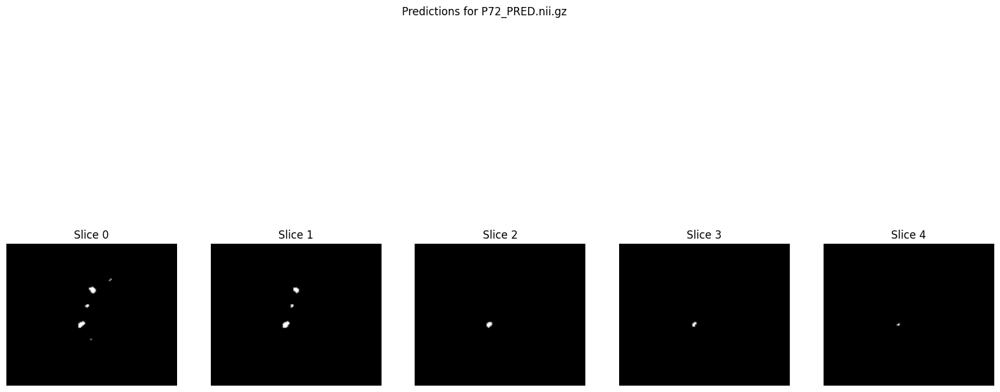

1/1 [==============================] - 0s 68ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSDensenet_0510/P73_PRED.nii.gz


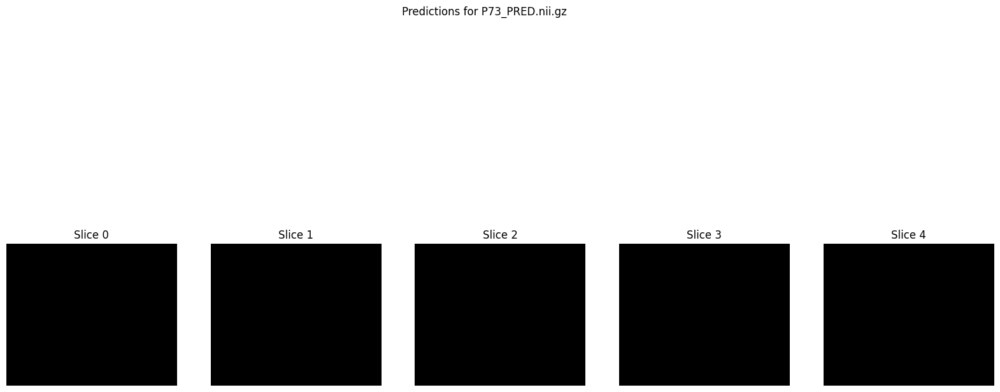

1/1 [==============================] - 0s 66ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSDensenet_0510/P74_PRED.nii.gz


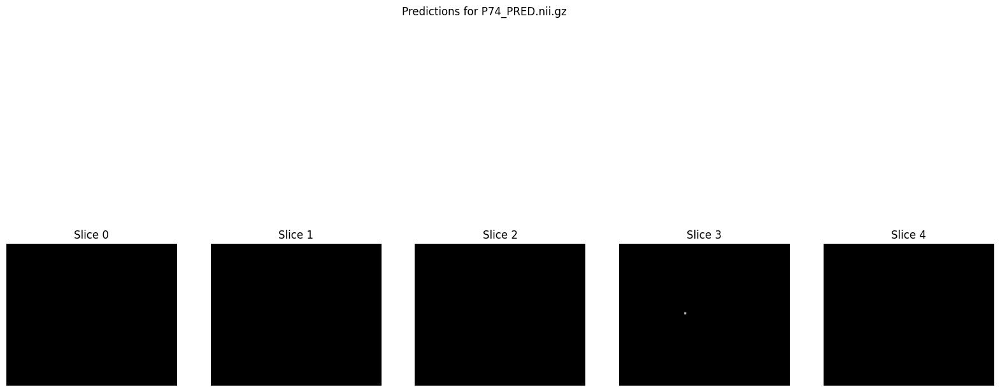

1/1 [==============================] - 0s 78ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSDensenet_0510/P75_PRED.nii.gz


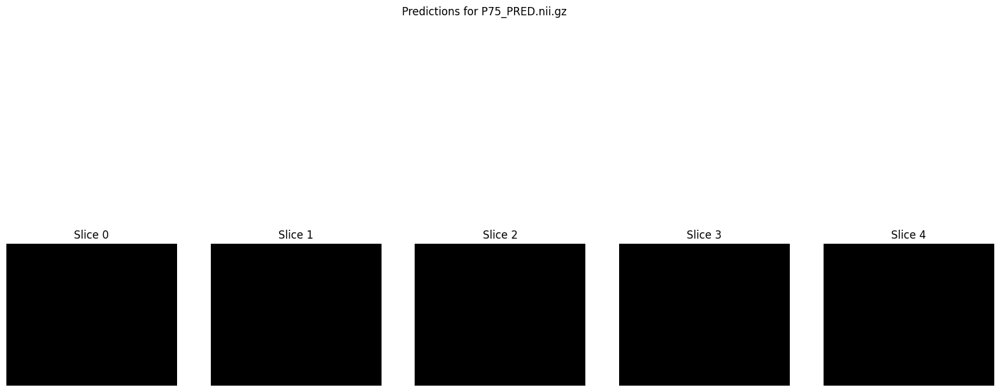

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint_0510.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.5, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSDensenet_0510'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.6

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

1/1 [==============================] - 0s 71ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSDensenet_110_05/P69_PRED.nii.gz


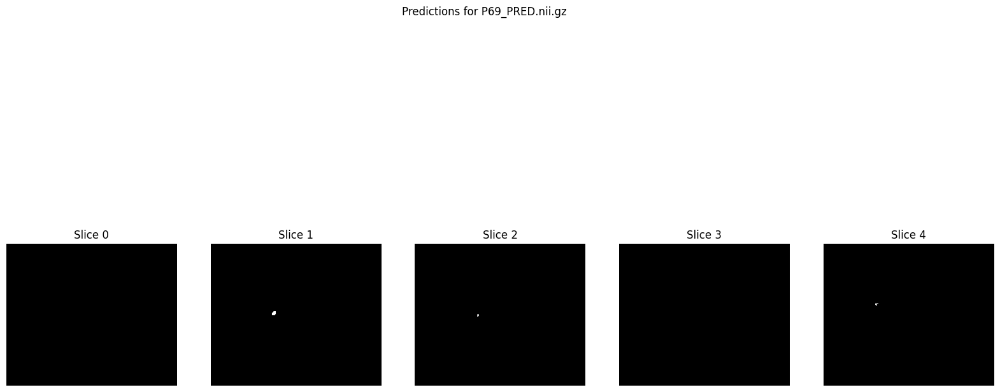

1/1 [==============================] - 0s 70ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSDensenet_110_05/P54_PRED.nii.gz


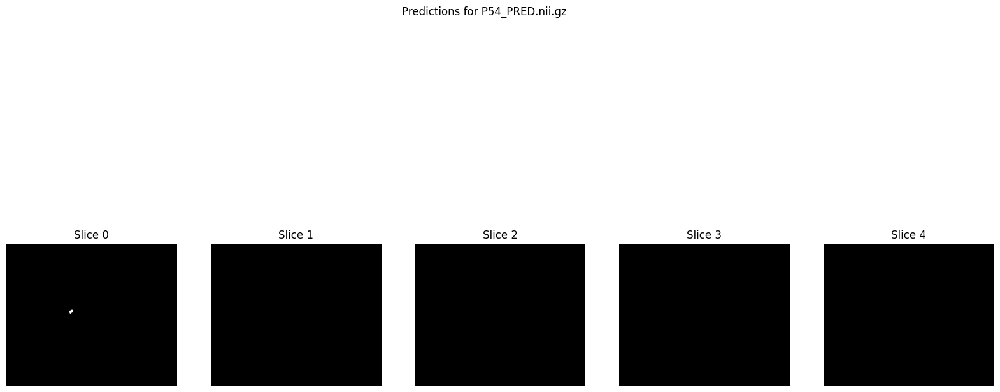

1/1 [==============================] - 0s 68ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSDensenet_110_05/P55_PRED.nii.gz


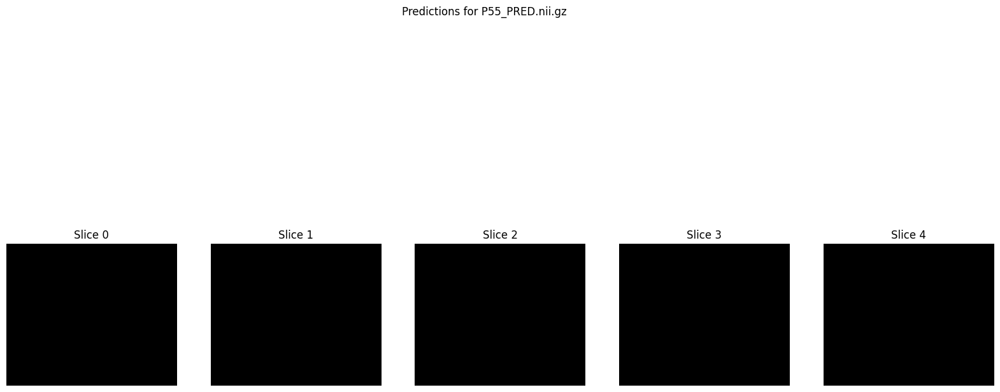

1/1 [==============================] - 0s 73ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSDensenet_110_05/P56_PRED.nii.gz


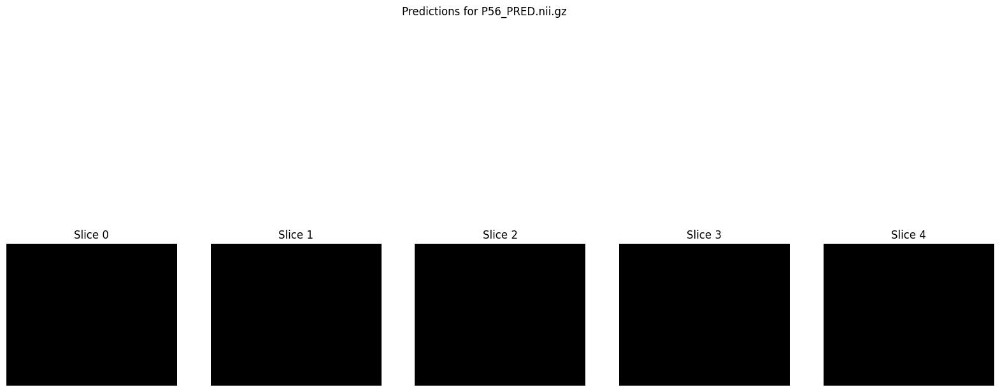

1/1 [==============================] - 0s 70ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSDensenet_110_05/P57_PRED.nii.gz


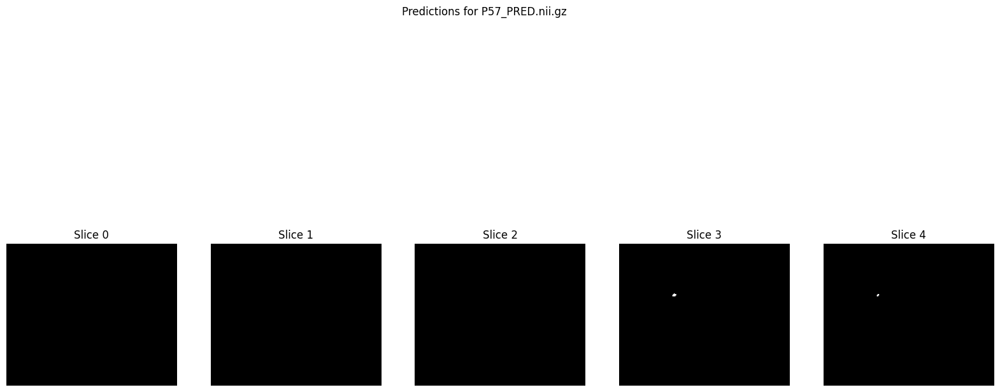

1/1 [==============================] - 0s 69ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSDensenet_110_05/P58_PRED.nii.gz


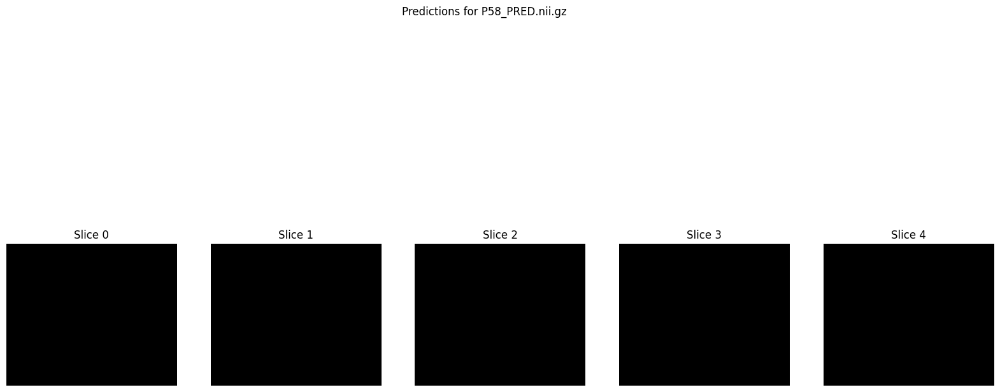

1/1 [==============================] - 0s 73ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSDensenet_110_05/P59_PRED.nii.gz


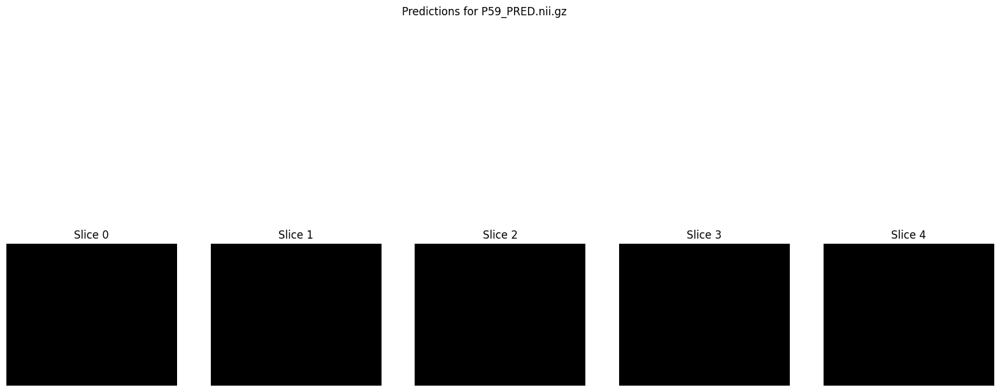

1/1 [==============================] - 0s 74ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSDensenet_110_05/P60_PRED.nii.gz


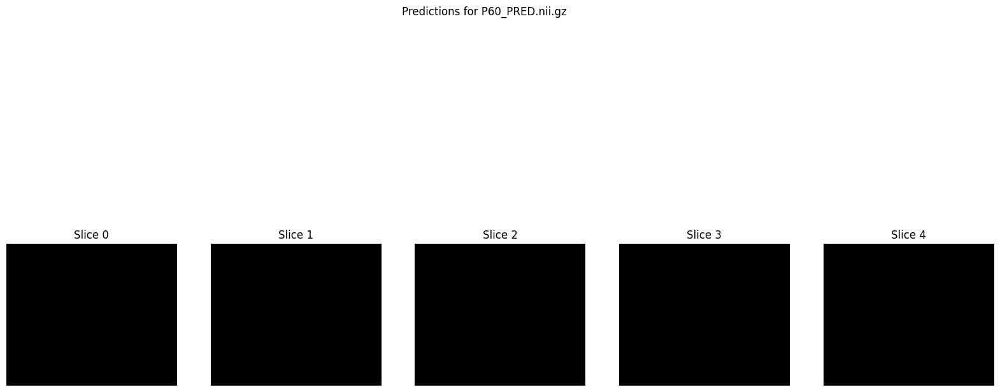

1/1 [==============================] - 0s 68ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSDensenet_110_05/P61_PRED.nii.gz


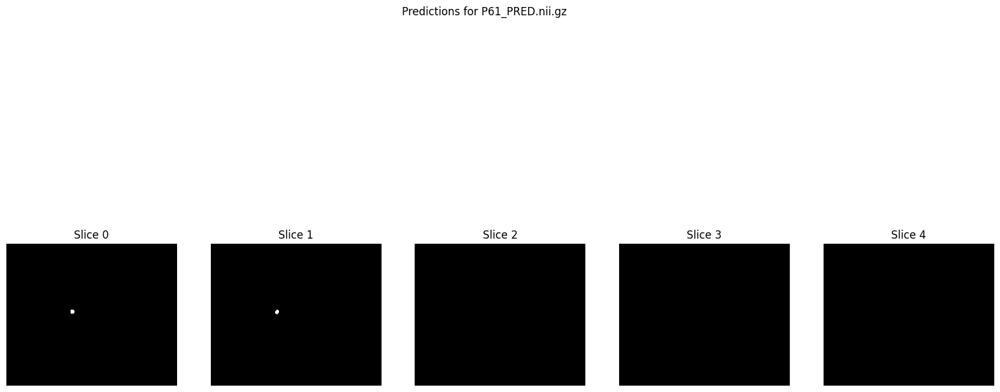

1/1 [==============================] - 0s 67ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSDensenet_110_05/P62_PRED.nii.gz


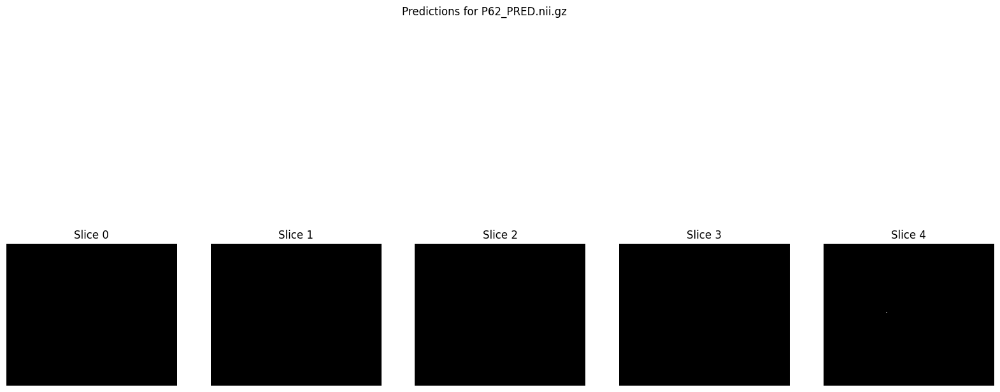

1/1 [==============================] - 0s 72ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSDensenet_110_05/P63_PRED.nii.gz


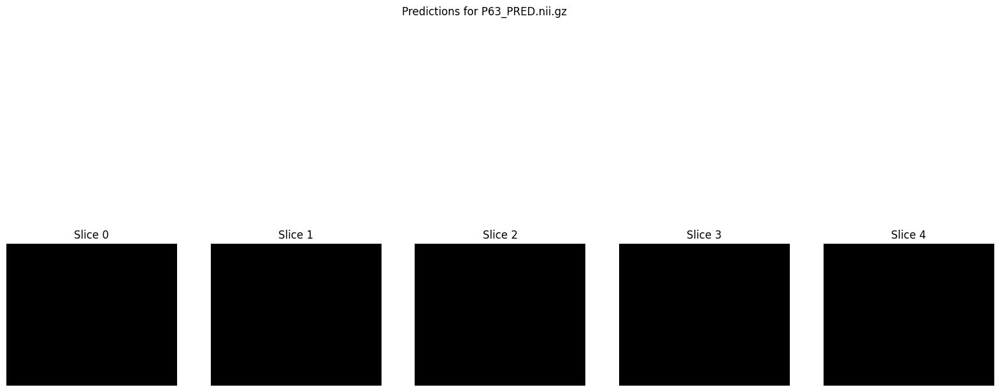

1/1 [==============================] - 0s 73ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSDensenet_110_05/P64_PRED.nii.gz


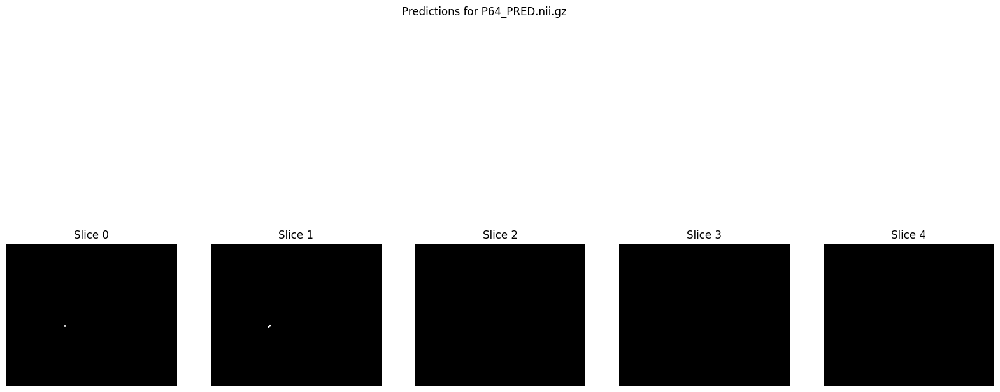

1/1 [==============================] - 0s 71ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSDensenet_110_05/P65_PRED.nii.gz


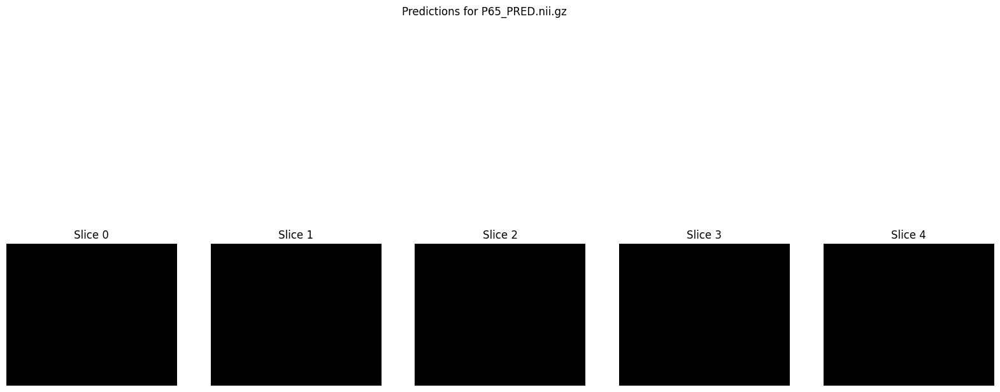

1/1 [==============================] - 0s 70ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSDensenet_110_05/P66_PRED.nii.gz


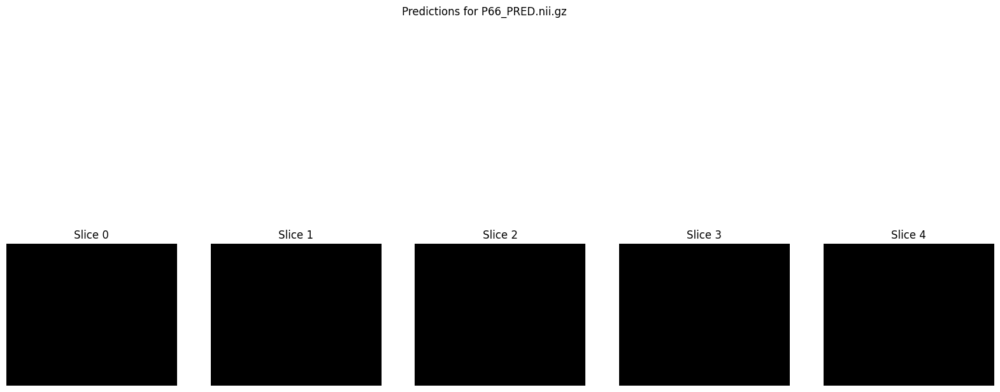

1/1 [==============================] - 0s 72ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSDensenet_110_05/P67_PRED.nii.gz


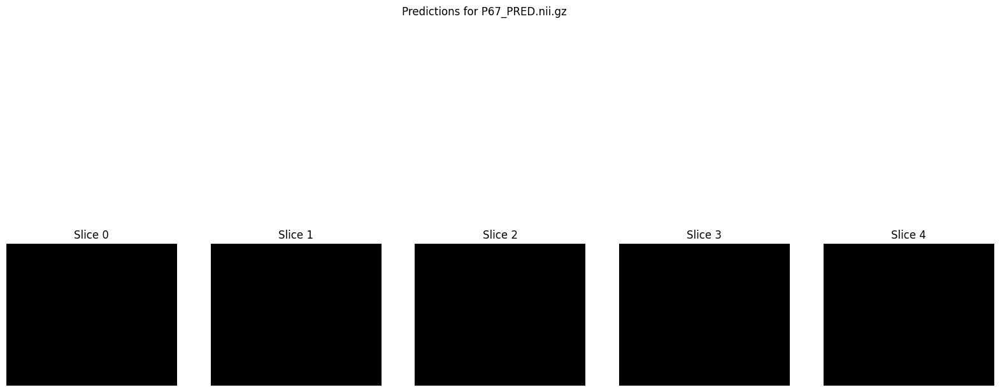

1/1 [==============================] - 0s 78ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSDensenet_110_05/P68_PRED.nii.gz


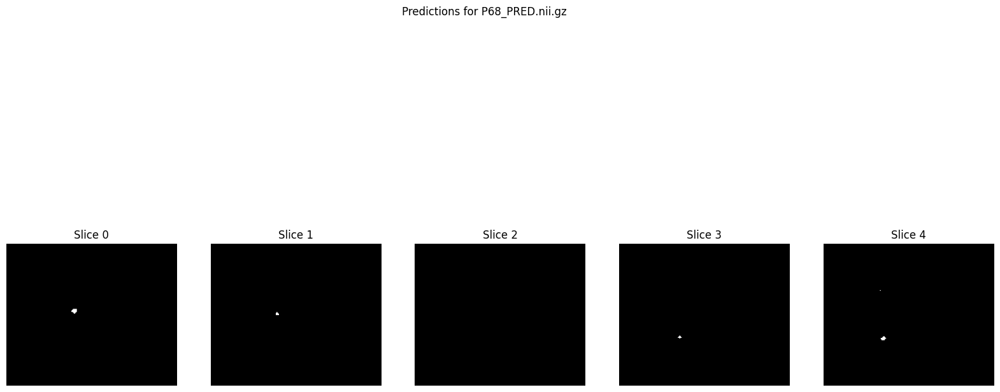

1/1 [==============================] - 0s 70ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSDensenet_110_05/P70_PRED.nii.gz


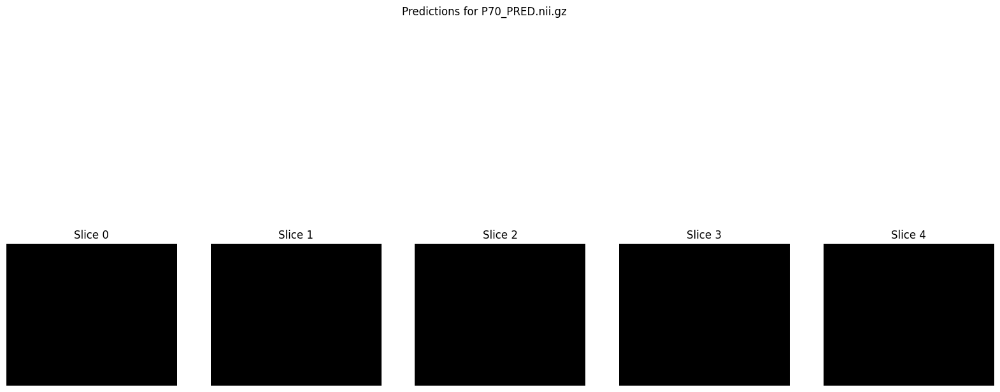

1/1 [==============================] - 0s 71ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSDensenet_110_05/P71_PRED.nii.gz


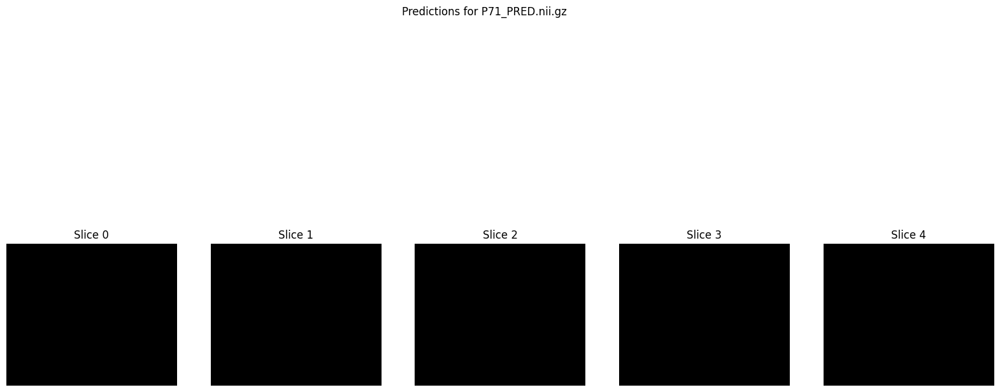

1/1 [==============================] - 0s 73ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSDensenet_110_05/P72_PRED.nii.gz


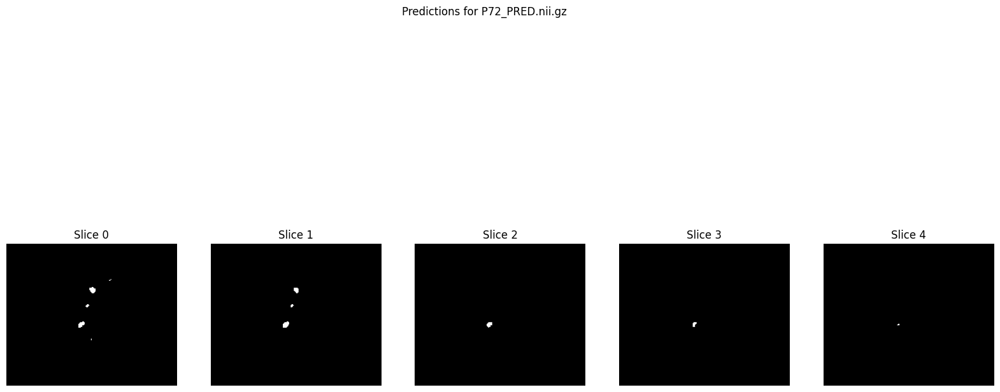

1/1 [==============================] - 0s 74ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSDensenet_110_05/P73_PRED.nii.gz


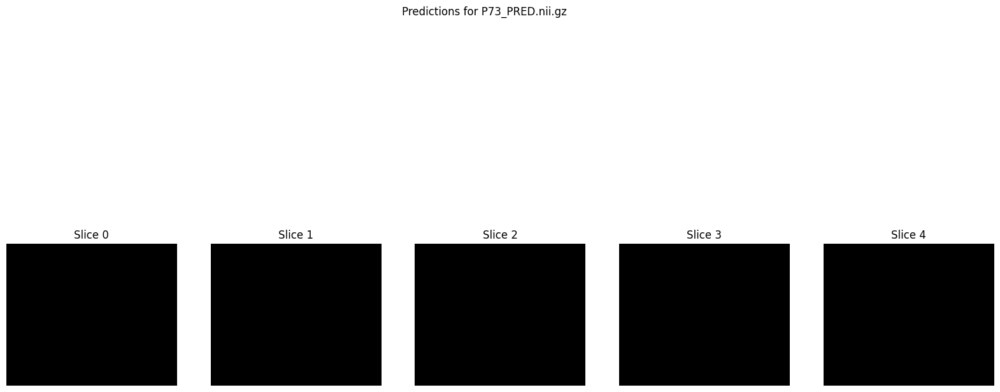

1/1 [==============================] - 0s 70ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSDensenet_110_05/P74_PRED.nii.gz


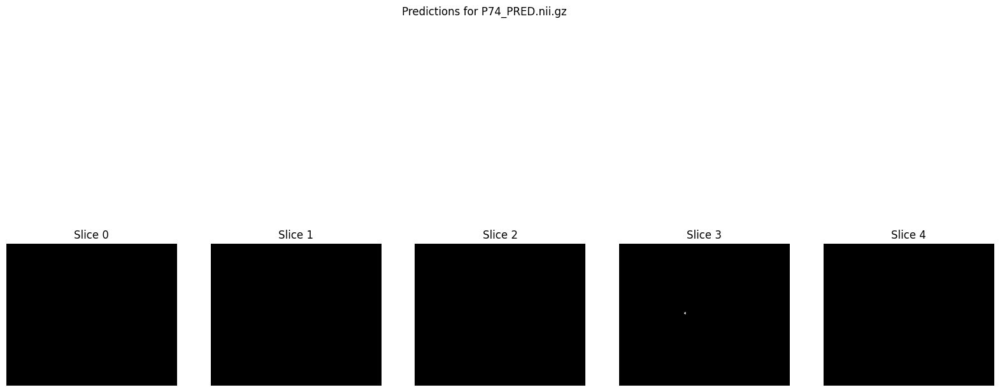

1/1 [==============================] - 0s 69ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSDensenet_110_05/P75_PRED.nii.gz


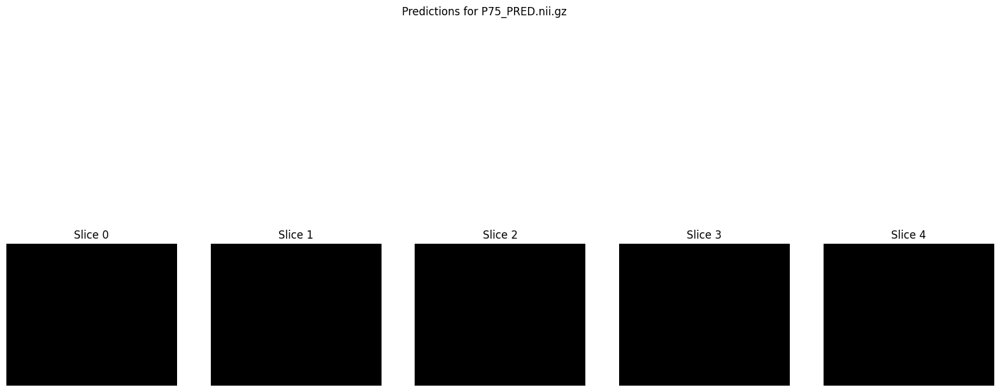

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpoint_0510.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.5, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSDensenet_110_05'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Ensure predictions are binary
    prediction = (prediction > 0.5).astype(np.float32)  # Apply a second threshold to make sure it's binary

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()


**Class wieghts [1.0, 10.0]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpoint_110.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_110.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.1729 - dice_coefficient: 0.0327
Epoch 1: val_loss improved from inf to 0.23494, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_110.h5
312/312 [==============================] - 252s 768ms/step - loss: 0.1729 - dice_coefficient: 0.0327 - val_loss: 0.2349 - val_dice_coefficient: 0.0210
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0685 - dice_coefficient: 0.1516
Epoch 2: val_loss improved from 0.23494 to 0.05934, saving model to /content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_110.h5
312/312 [==============================] - 239s 766ms/step - loss: 0.0685 - dice_coefficient: 0.1516 - val_loss: 0.0593 - val_dice_coefficient: 0.1441
Epoch 3/100
312/312 [==============================] - ETA: 0s - lo

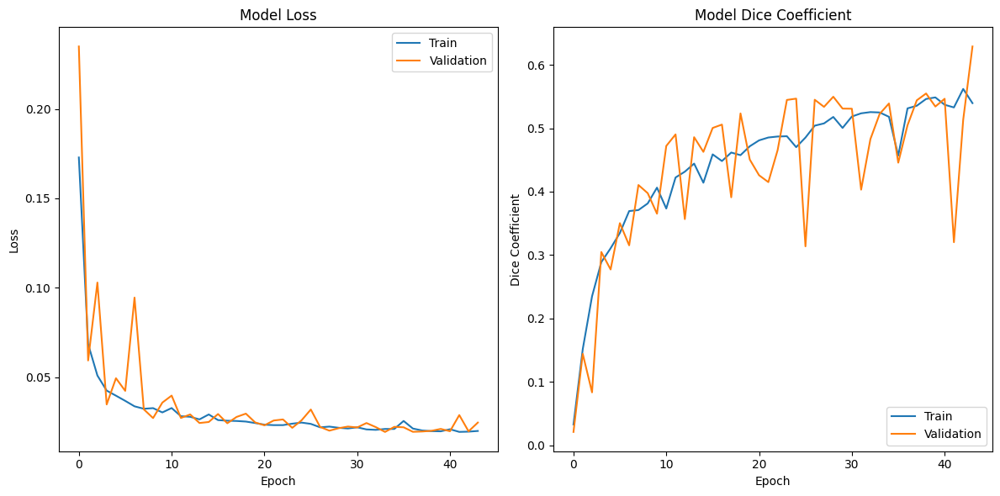

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

**TESTING**

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = '/content/drive/MyDrive/2D3Dunet_checkpointDensenet/2D3Dunet_checkpoint_110.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = '/content/drive/MyDrive/MASKSDensenet_110'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**Resnet34**

In [ ]:
BACKBONE = 'resnet34'
model = Unet(BACKBONE, input_shape=(128, 128, 2), encoder_weights=None, encoder_freeze=False, classes=1, activation='sigmoid', decoder_block_type='transpose')
# Add dropout layer
dropout = Dropout(0.5)(model.output)
# Compile the model
model.compile('Adam', loss=weighted_binary_crossentropy(class_weights), metrics=[dice_coefficient])

In [ ]:
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=False, dpi=64)

In [ ]:
tf.keras.utils.plot_model(model, to_file='model_plot.png', show_shapes=True, expand_nested=True, dpi=300)

dot: graph is too large for cairo-renderer bitmaps. Scaling by 0.499558 to fit



In [ ]:
# Open an image file
with Image.open('model_plot.png') as img:
    # Rotate the image
    img = img.rotate(90, expand=True)  # Rotate 90 degrees to change from vertical to horizontal

    # Save the image with higher resolution
    img.save('model_plot.png')

**Class weights [0.50202403, 124.01598644]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_true.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_true.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.3912 - dice_coefficient: 0.0297
Epoch 1: val_loss improved from inf to 0.37839, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_true.h5
312/312 [==============================] - 191s 597ms/step - loss: 0.3912 - dice_coefficient: 0.0297 - val_loss: 0.3784 - val_dice_coefficient: 0.0212
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.2590 - dice_coefficient: 0.0644
Epoch 2: val_loss improved from 0.37839 to 0.25962, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_true.h5
312/312 [==============================] - 190s 610ms/step - loss: 0.2590 - dice_coefficient: 0.0644 - val_loss: 0.2596 - val_dice_coefficient: 0.0568
Epoch 3/100
312/312 [==============================] - ETA: 0s -

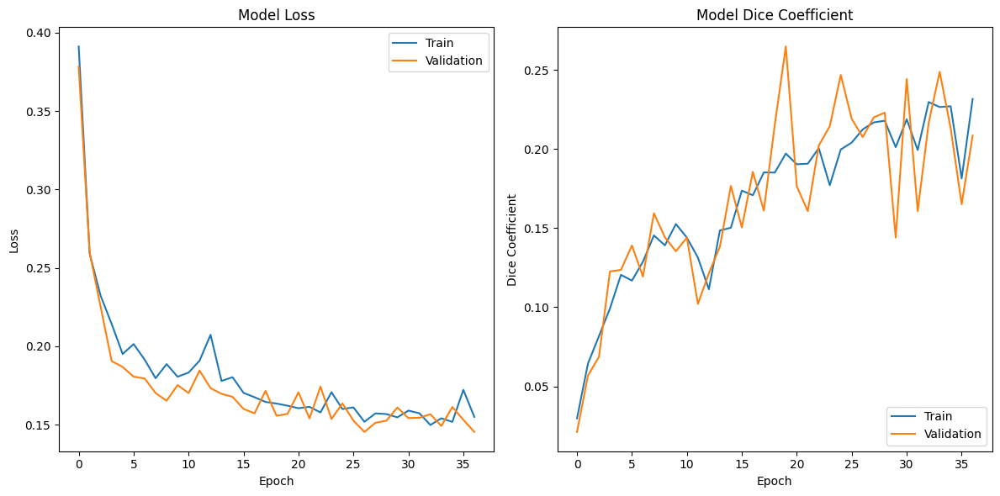

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

**TESTING**

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_true.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.50202403, 124.01598644])})

# Create the output directory if it doesn't exist
output_dir = './MASKSResnet34_true'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**Class weights [0.5, 10.0]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_0510.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  warnings.warn(


No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_0510.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.0864 - dice_coefficient: 0.0631
Epoch 1: val_loss improved from inf to 0.10675, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_0510.h5
312/312 [==============================] - 191s 596ms/step - loss: 0.0864 - dice_coefficient: 0.0631 - val_loss: 0.1068 - val_dice_coefficient: 0.0447
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0407 - dice_coefficient: 0.1924
Epoch 2: val_loss improved from 0.10675 to 0.03919, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_0510.h5
312/312 [==============================] - 197s 634ms/step - loss: 0.0407 - dice_coefficient: 0.1924 - val_loss: 0.0392 - val_dice_coefficient: 0.1589
Epoch 3/100
312/312 [==============================] - ETA: 0s -

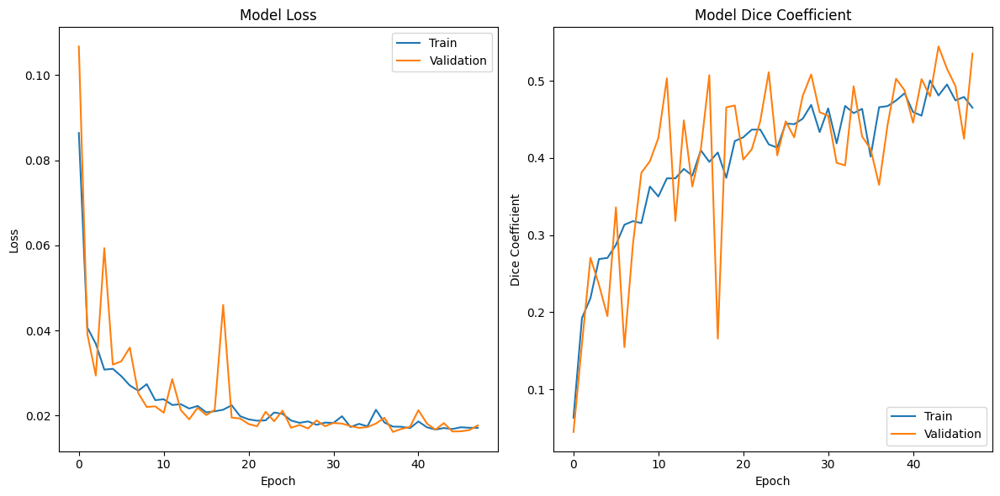

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

**TESTING**

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_0510.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([0.5, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSResnet34_0510'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

**Class weights [1.0, 10.0]**

In [ ]:
# Define ImageDataGenerator for augmentation
data_gen_args = dict(
    rotation_range=10,
    width_shift_range=0.1,
    height_shift_range=0.1,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

image_datagen = ImageDataGenerator(**data_gen_args)
mask_datagen = ImageDataGenerator(**data_gen_args)

# Fit the generators to the data
seed = 1
image_datagen.fit(train_inputs, augment=True, seed=seed)
mask_datagen.fit(train_masks, augment=True, seed=seed)

# Create generators
train_image_generator = image_datagen.flow(train_inputs, batch_size=16, seed=seed)
train_mask_generator = mask_datagen.flow(train_masks, batch_size=16, seed=seed)
train_generator = zip(train_image_generator, train_mask_generator)

val_image_generator = image_datagen.flow(val_inputs, batch_size=16, seed=seed)
val_mask_generator = mask_datagen.flow(val_masks, batch_size=16, seed=seed)
val_generator = zip(val_image_generator, val_mask_generator)

# Define callbacks
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5'
callbacks = [
    ModelCheckpoint(filepath=checkpoint_filepath, save_best_only=True, monitor='val_loss', mode='min', verbose=1),
    EarlyStopping(monitor='val_loss', patience=10, verbose=1, mode='min', restore_best_weights=True)
]

# Load the weights from the checkpoint if it exists
if os.path.exists(checkpoint_filepath):
    print(f"Loading weights from checkpoint: {checkpoint_filepath}")
    model.load_weights(checkpoint_filepath)
else:
    print(f"No checkpoint found at {checkpoint_filepath}, starting training from scratch")

# Train the model
history = model.fit(train_generator, steps_per_epoch=len(train_inputs) // 16, epochs=100,
                    validation_data=val_generator, validation_steps=len(val_inputs) // 16,
                    callbacks=callbacks)

# Checkpoint saving debug
if os.path.exists(checkpoint_filepath):
    print(f"Checkpoint saved at: {checkpoint_filepath}")
else:
    print(f"No checkpoint saved at: {checkpoint_filepath}")

/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:2094: UserWarning: Expected input to be images (as Numpy array) following the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3 or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (5000, 128, 128, 2) (2 channels).
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/keras/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (1000, 128, 128, 2) (2 channels).
  

No checkpoint found at /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5, starting training from scratch
Epoch 1/100
312/312 [==============================] - ETA: 0s - loss: 0.1804 - dice_coefficient: 0.0294
Epoch 1: val_loss improved from inf to 0.17006, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5
312/312 [==============================] - 195s 609ms/step - loss: 0.1804 - dice_coefficient: 0.0294 - val_loss: 0.1701 - val_dice_coefficient: 0.0308
Epoch 2/100
312/312 [==============================] - ETA: 0s - loss: 0.0653 - dice_coefficient: 0.1610
Epoch 2: val_loss improved from 0.17006 to 0.07628, saving model to /content/drive/MyDrive/2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5
312/312 [==============================] - 192s 616ms/step - loss: 0.0653 - dice_coefficient: 0.1610 - val_loss: 0.0763 - val_dice_coefficient: 0.1218
Epoch 3/100
312/312 [==============================] - ETA: 0s - lo

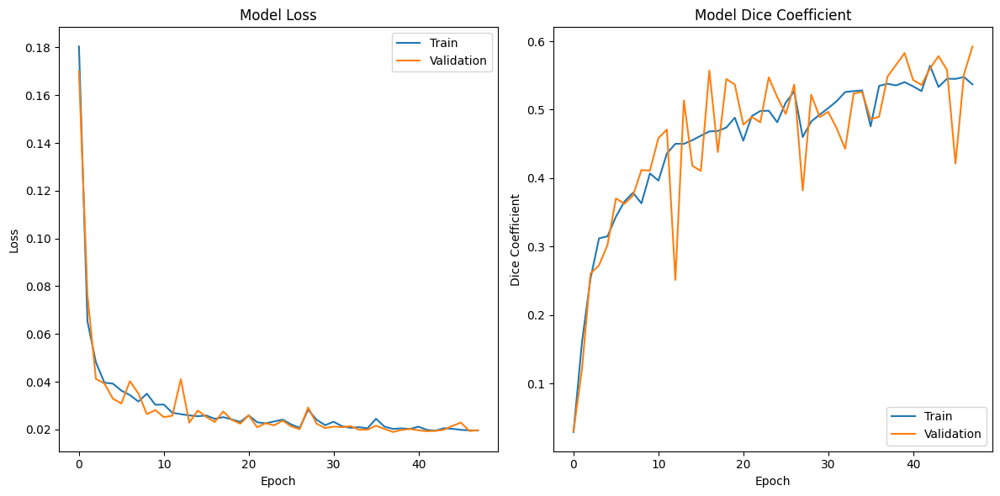

In [ ]:
def plot_training_history(history):
    # Plot training & validation loss values
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model Loss')
    plt.ylabel('Loss')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='upper right')

    # Plot training & validation Dice coefficient values
    plt.subplot(1, 2, 2)
    plt.plot(history.history['dice_coefficient'])
    plt.plot(history.history['val_dice_coefficient'])
    plt.title('Model Dice Coefficient')
    plt.ylabel('Dice Coefficient')
    plt.xlabel('Epoch')
    plt.legend(['Train', 'Validation'], loc='lower right')

    plt.tight_layout()
    plt.show()

# Plot training history
plot_training_history(history)

**TESTING**

1/1 [==============================] - 0s 55ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSResnet34_110/P69_PRED.nii.gz


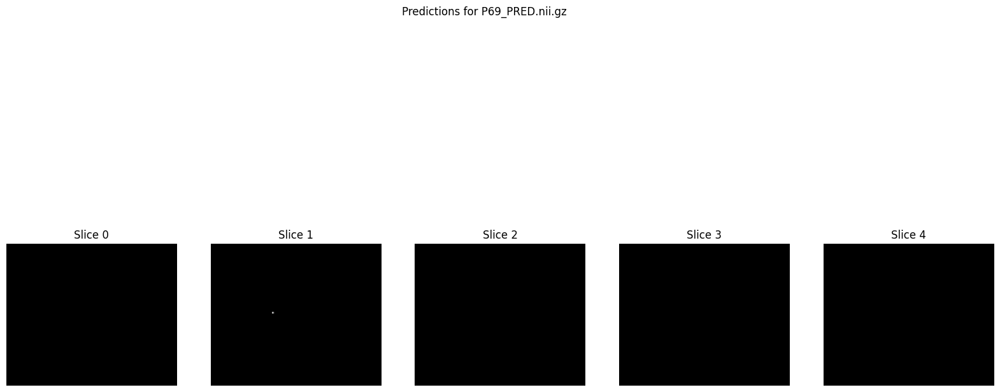

1/1 [==============================] - 0s 56ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSResnet34_110/P54_PRED.nii.gz


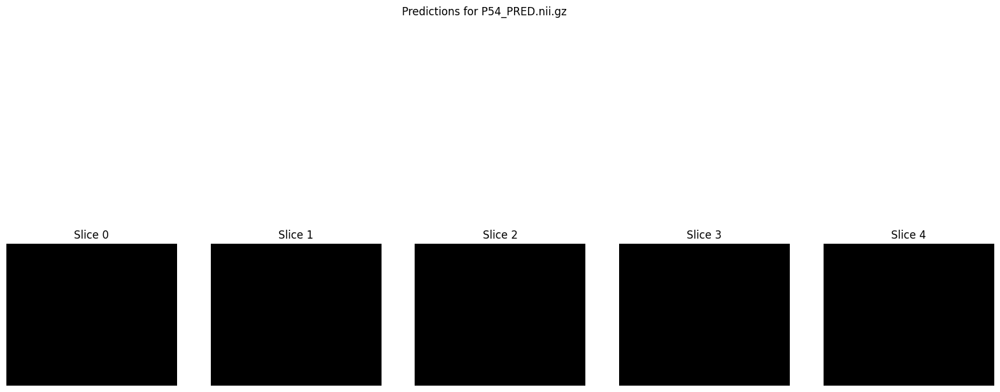

1/1 [==============================] - 0s 59ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSResnet34_110/P55_PRED.nii.gz


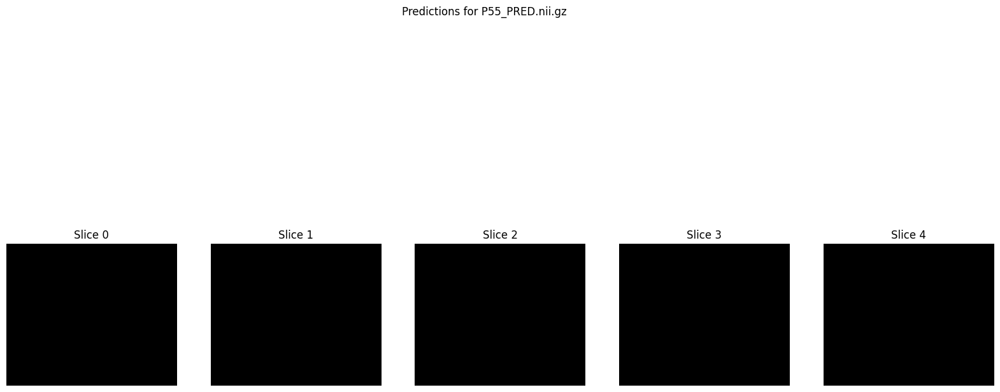

1/1 [==============================] - 0s 54ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSResnet34_110/P56_PRED.nii.gz


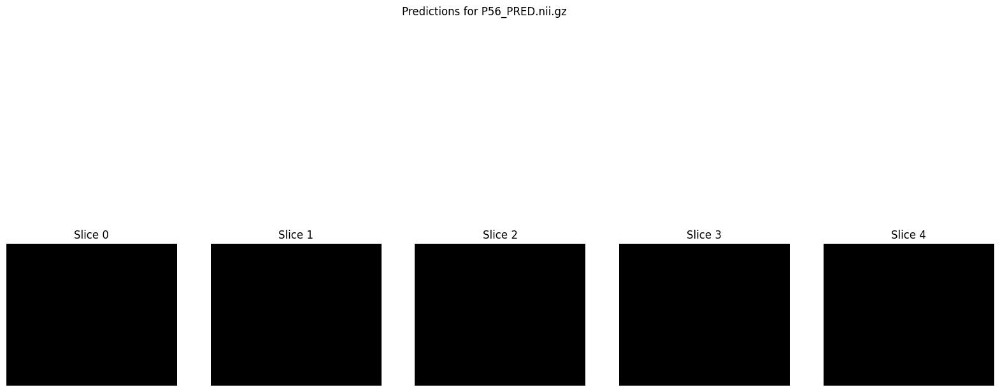

1/1 [==============================] - 0s 51ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSResnet34_110/P57_PRED.nii.gz


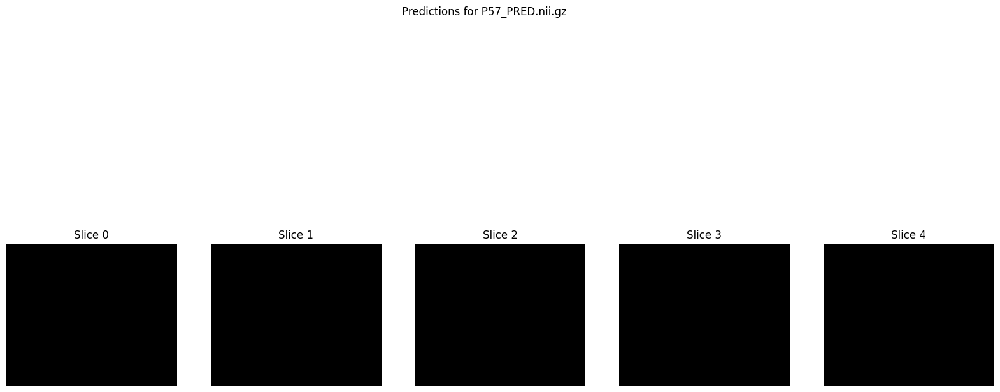

1/1 [==============================] - 0s 56ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSResnet34_110/P58_PRED.nii.gz


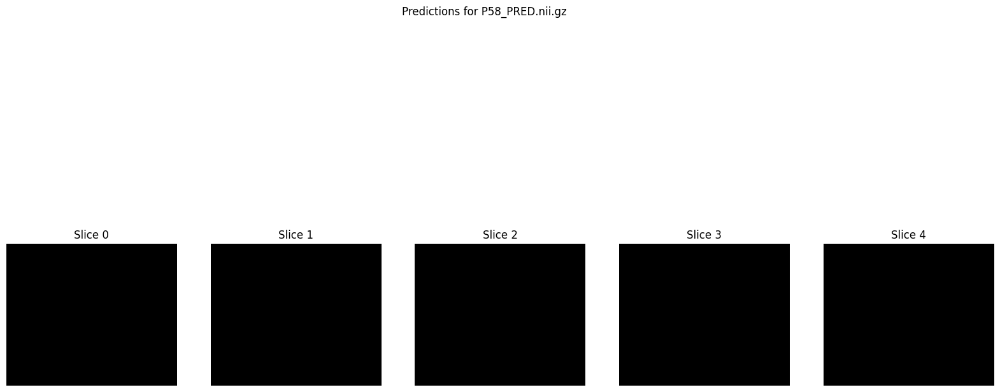

1/1 [==============================] - 0s 64ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSResnet34_110/P59_PRED.nii.gz


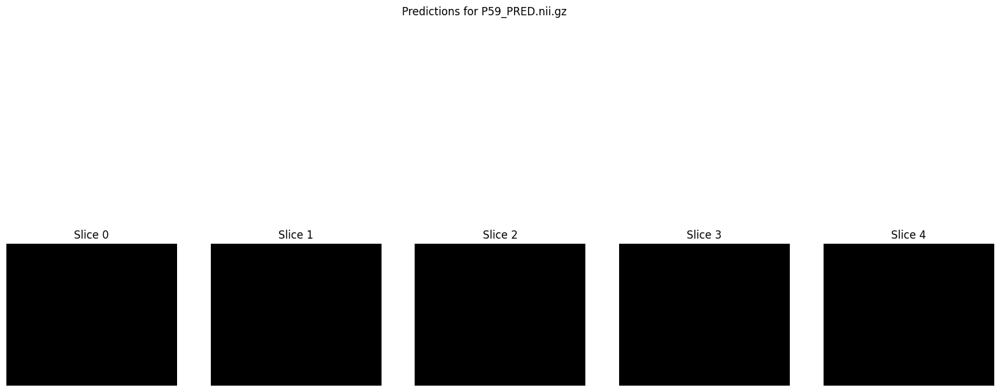

1/1 [==============================] - 0s 56ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSResnet34_110/P60_PRED.nii.gz


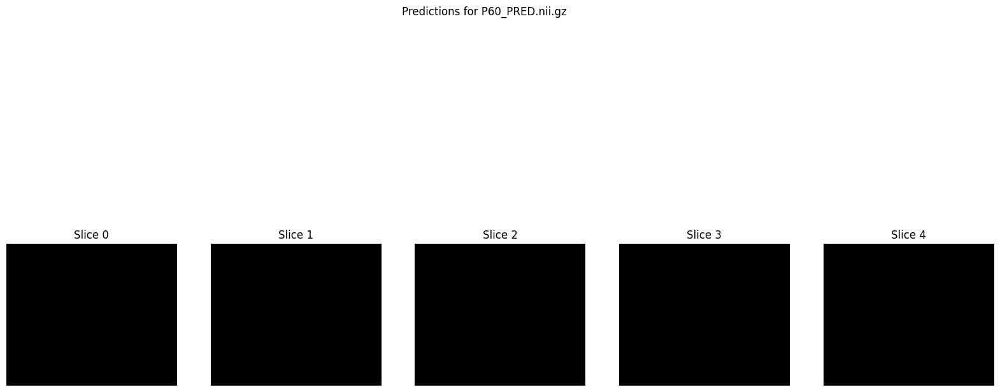

1/1 [==============================] - 0s 54ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSResnet34_110/P61_PRED.nii.gz


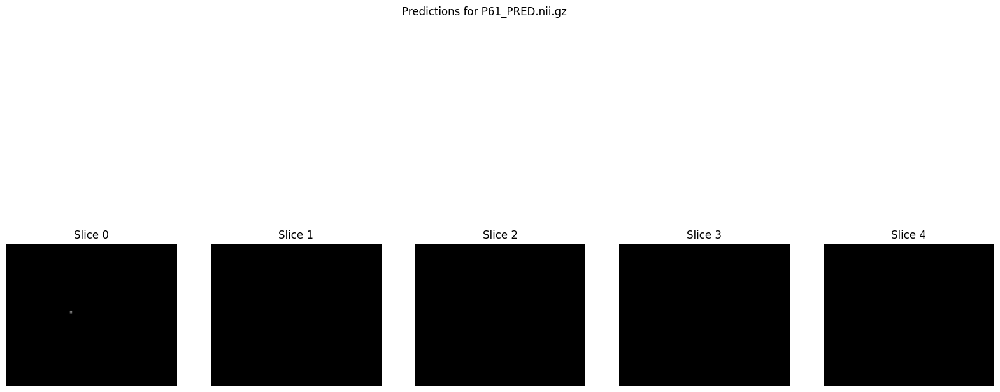

1/1 [==============================] - 0s 50ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSResnet34_110/P62_PRED.nii.gz


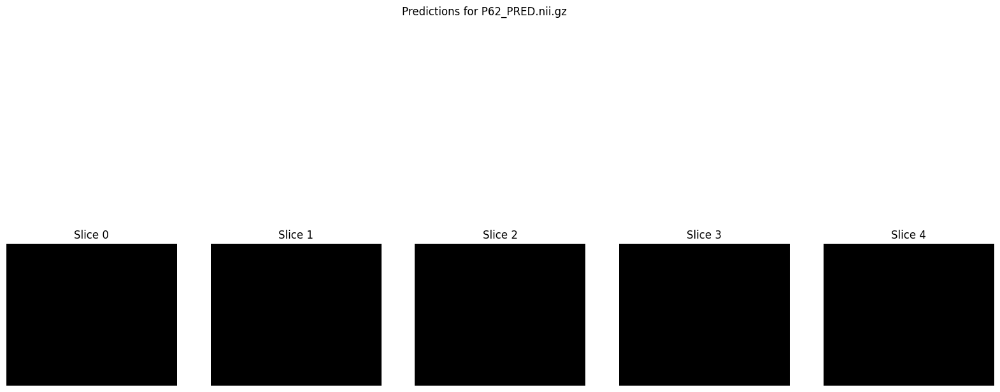

1/1 [==============================] - 0s 62ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSResnet34_110/P63_PRED.nii.gz


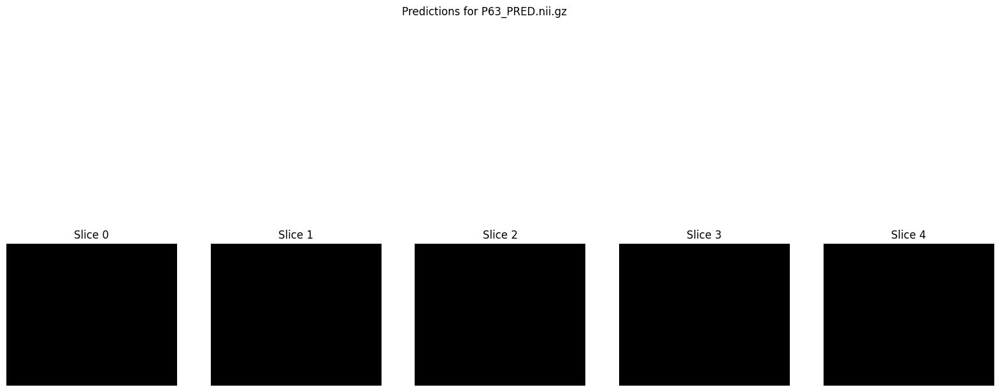

1/1 [==============================] - 0s 63ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSResnet34_110/P64_PRED.nii.gz


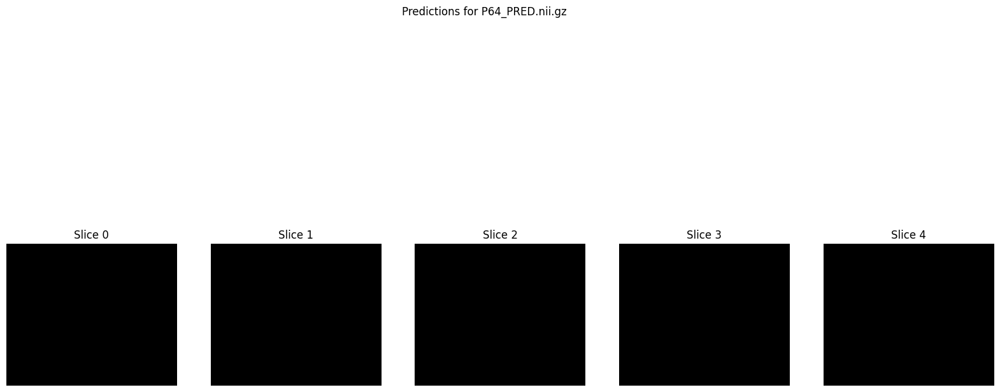

1/1 [==============================] - 0s 55ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSResnet34_110/P65_PRED.nii.gz


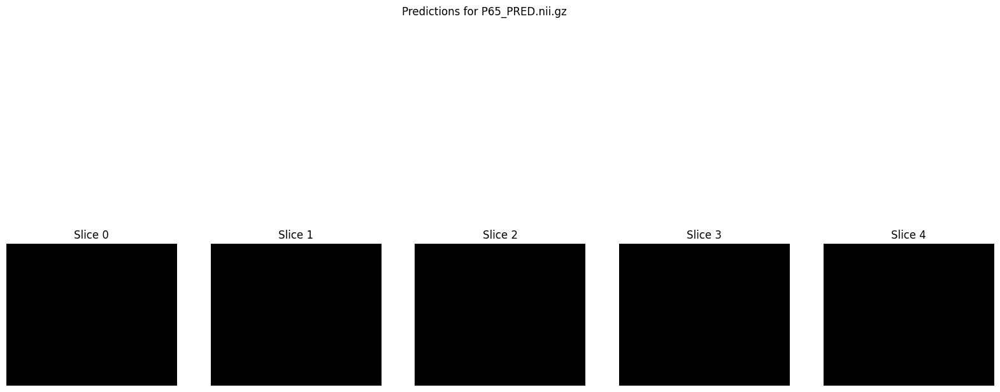

1/1 [==============================] - 0s 56ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSResnet34_110/P66_PRED.nii.gz


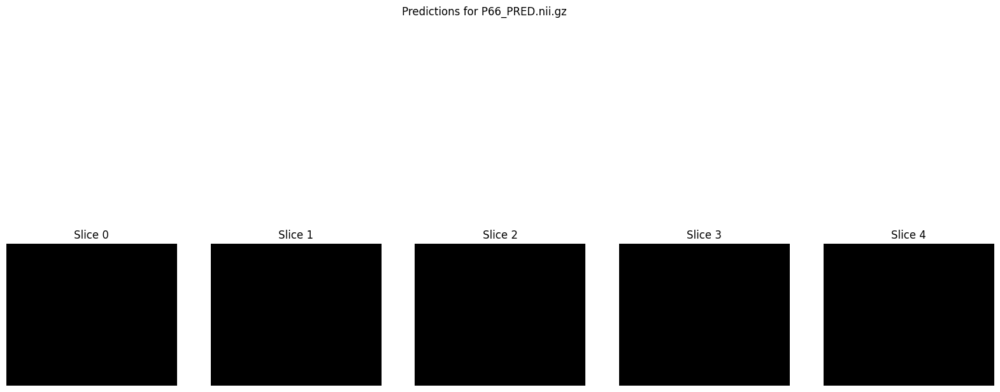

1/1 [==============================] - 0s 64ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSResnet34_110/P67_PRED.nii.gz


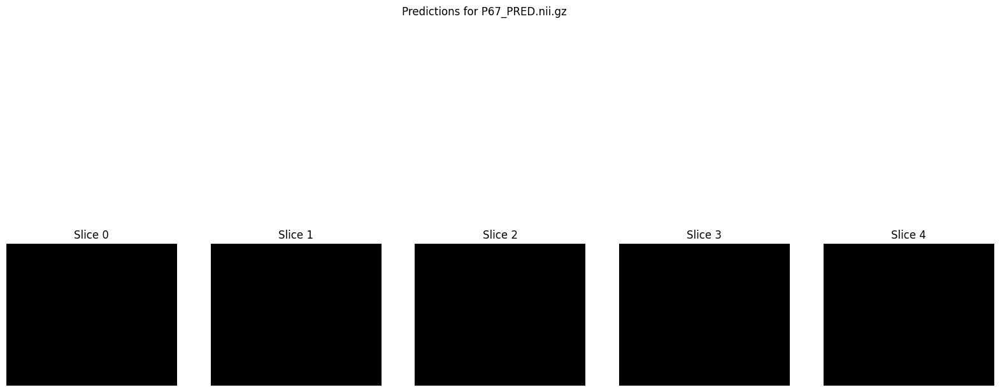

1/1 [==============================] - 0s 55ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSResnet34_110/P68_PRED.nii.gz


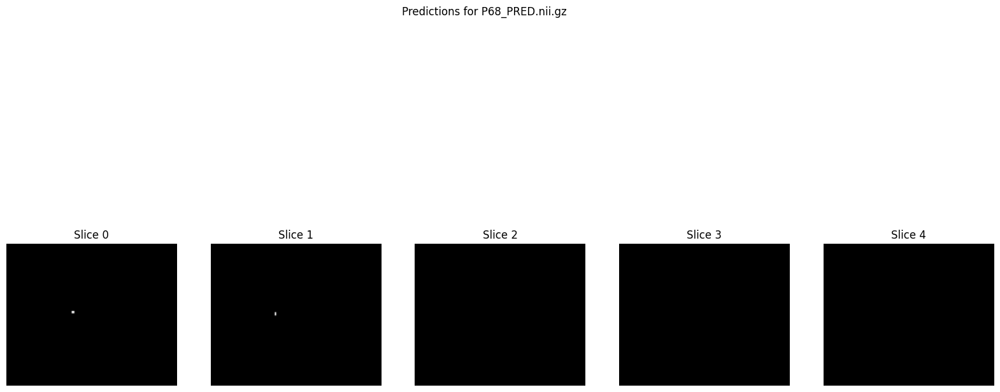

1/1 [==============================] - 0s 55ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSResnet34_110/P70_PRED.nii.gz


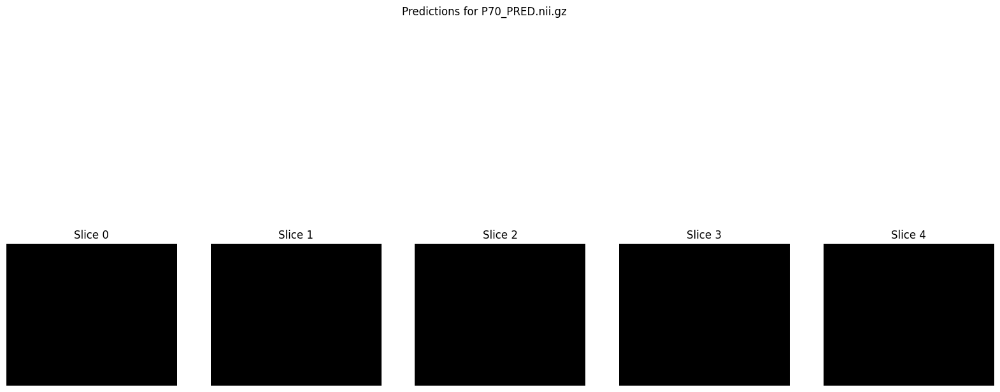

1/1 [==============================] - 0s 53ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSResnet34_110/P71_PRED.nii.gz


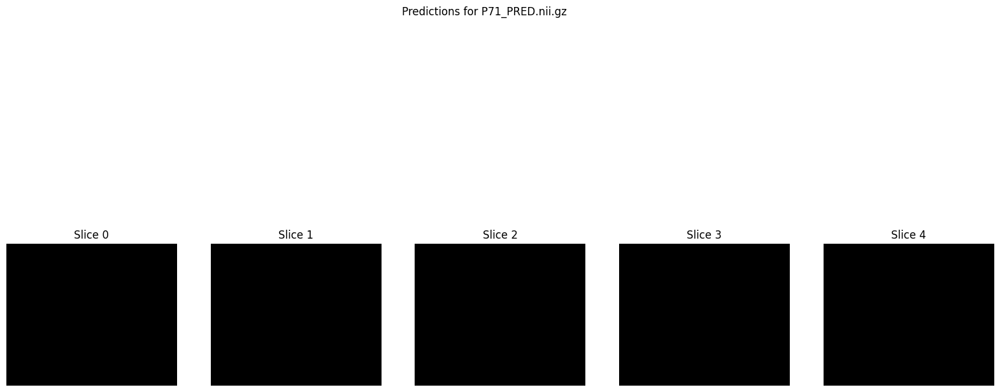

1/1 [==============================] - 0s 63ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSResnet34_110/P72_PRED.nii.gz


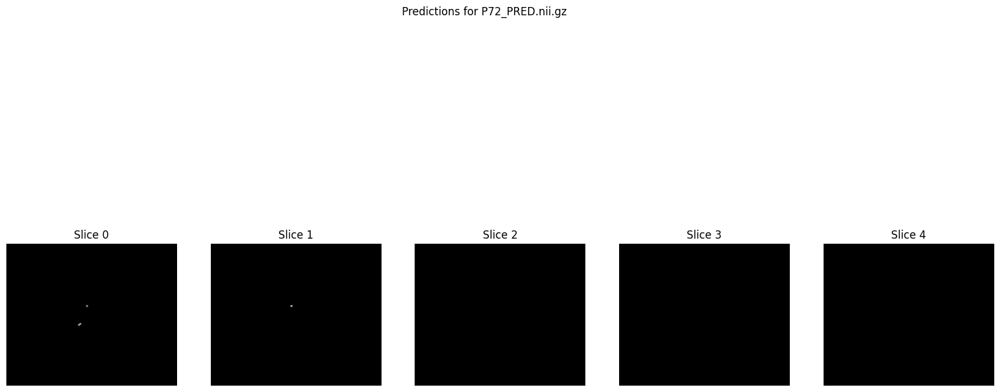

1/1 [==============================] - 0s 57ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSResnet34_110/P73_PRED.nii.gz


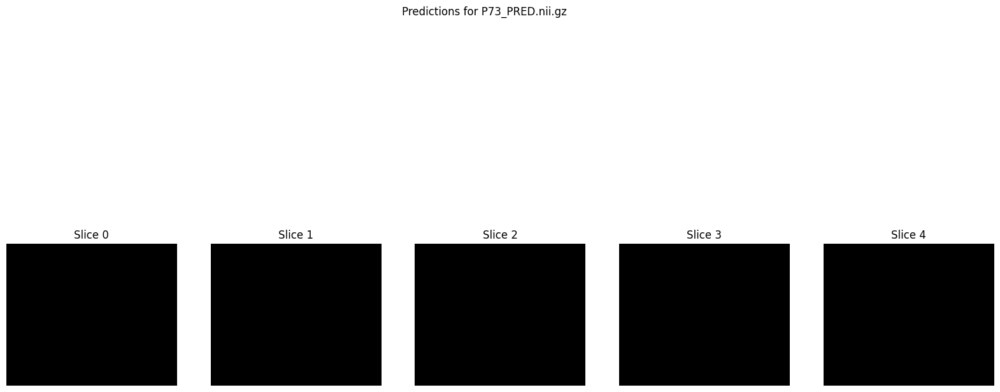

1/1 [==============================] - 0s 53ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSResnet34_110/P74_PRED.nii.gz


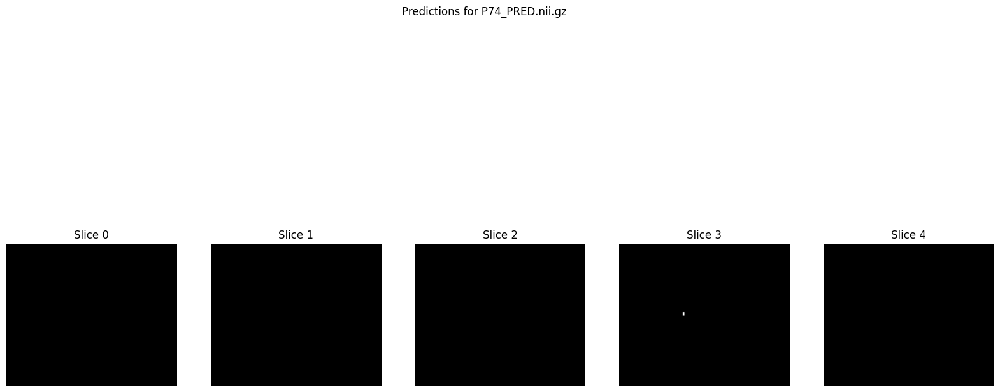

1/1 [==============================] - 0s 57ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSResnet34_110/P75_PRED.nii.gz


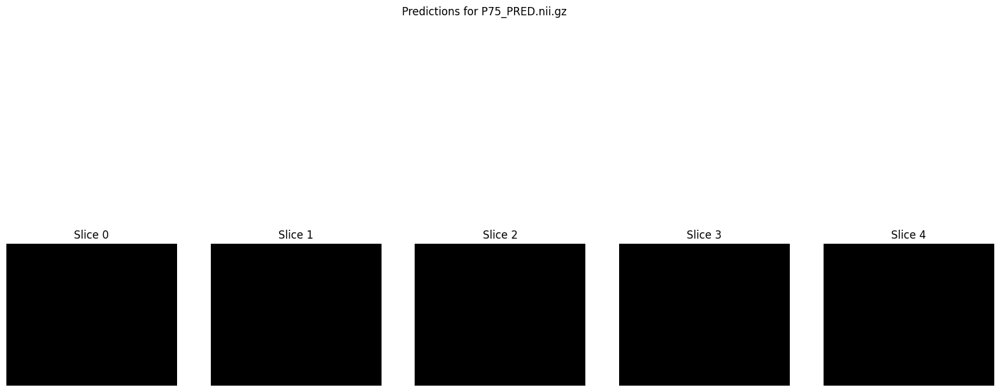

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSResnet34_110'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

# Define threshold for acceptance
threshold = 0.8

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()

0.5

1/1 [==============================] - 0s 55ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSResnet34_110_05/P69_PRED.nii.gz


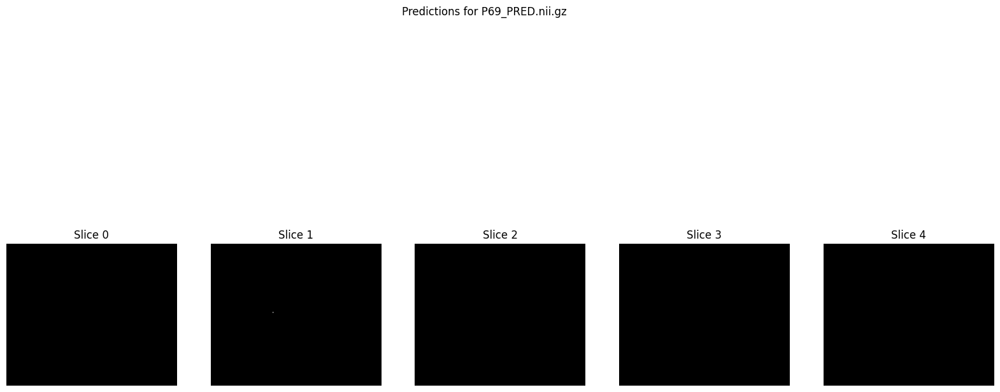

1/1 [==============================] - 0s 57ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSResnet34_110_05/P54_PRED.nii.gz


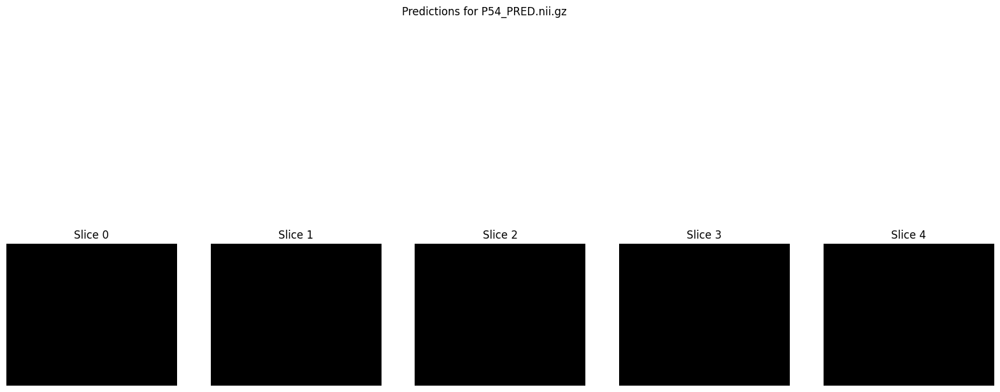

1/1 [==============================] - 0s 57ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSResnet34_110_05/P55_PRED.nii.gz


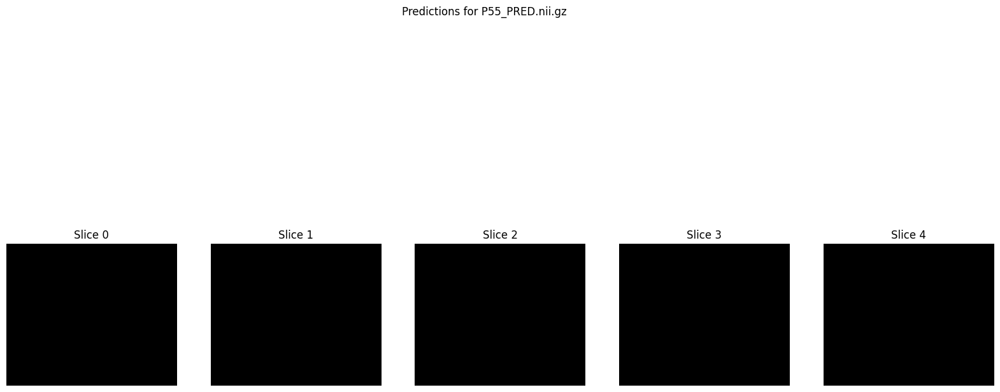

1/1 [==============================] - 0s 55ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSResnet34_110_05/P56_PRED.nii.gz


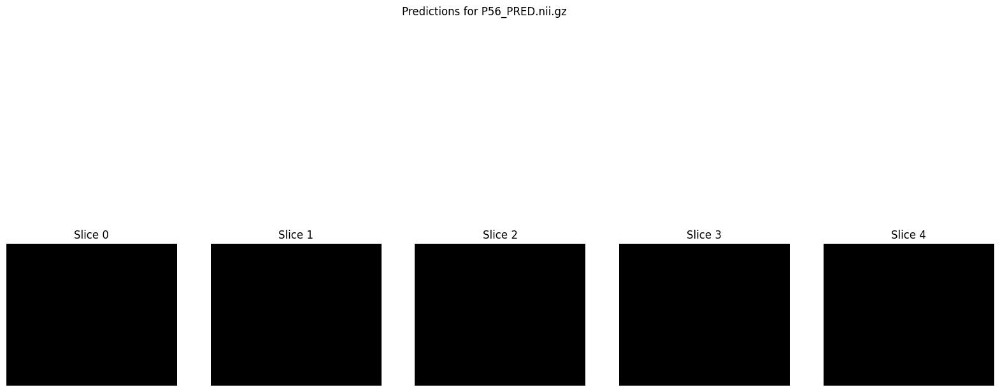

1/1 [==============================] - 0s 58ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSResnet34_110_05/P57_PRED.nii.gz


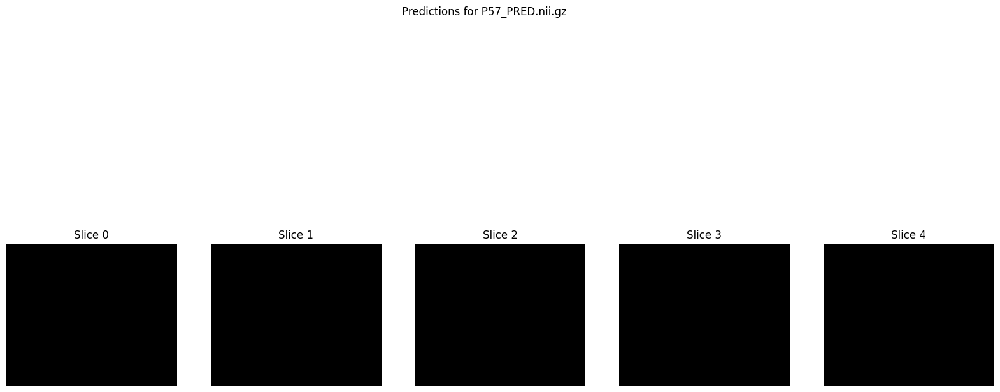

1/1 [==============================] - 0s 53ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSResnet34_110_05/P58_PRED.nii.gz


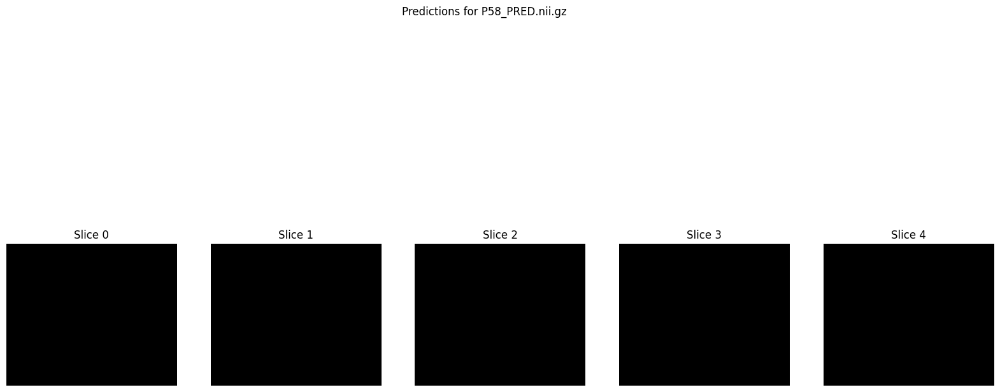

1/1 [==============================] - 0s 56ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSResnet34_110_05/P59_PRED.nii.gz


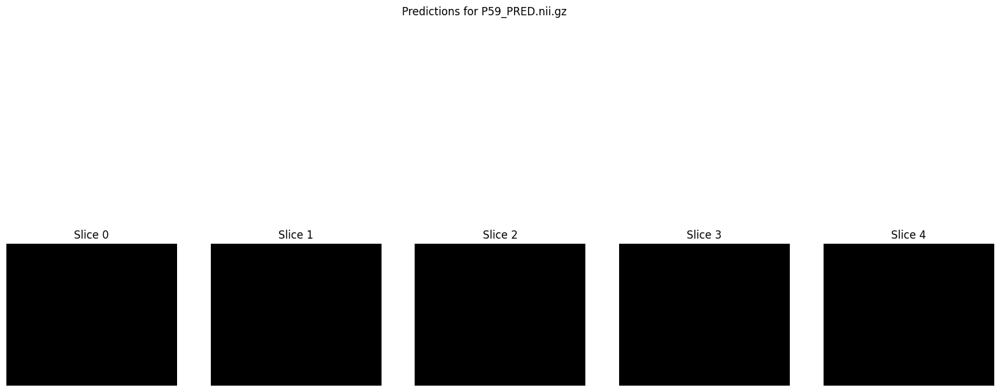

1/1 [==============================] - 0s 56ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSResnet34_110_05/P60_PRED.nii.gz


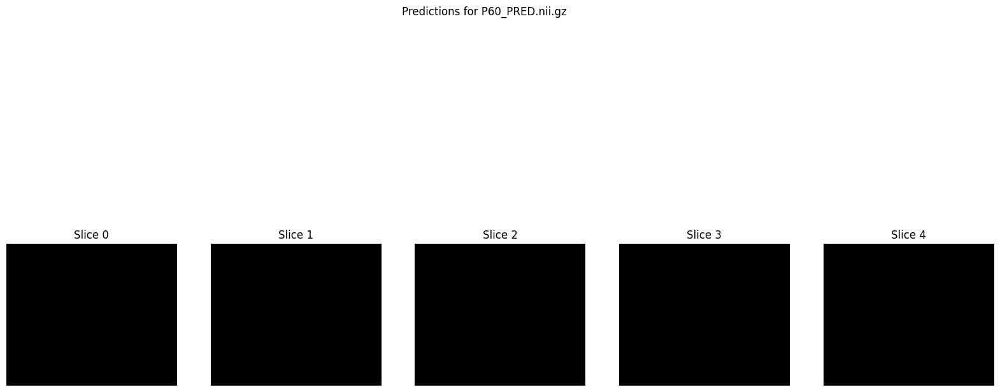

1/1 [==============================] - 0s 61ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSResnet34_110_05/P61_PRED.nii.gz


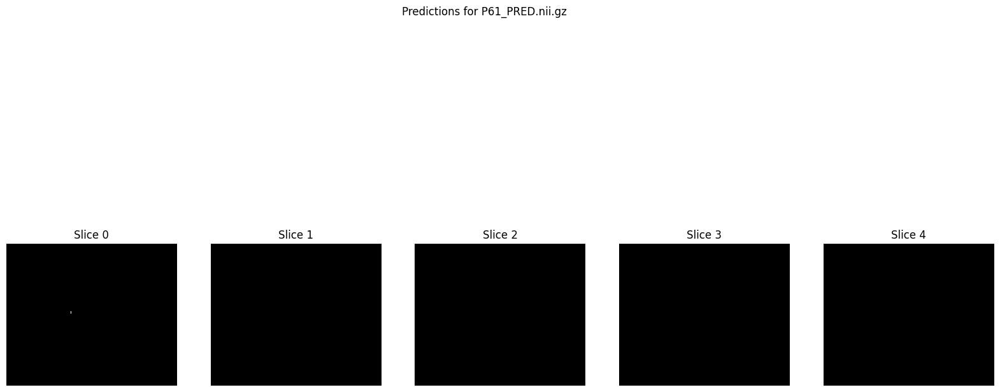

1/1 [==============================] - 0s 55ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSResnet34_110_05/P62_PRED.nii.gz


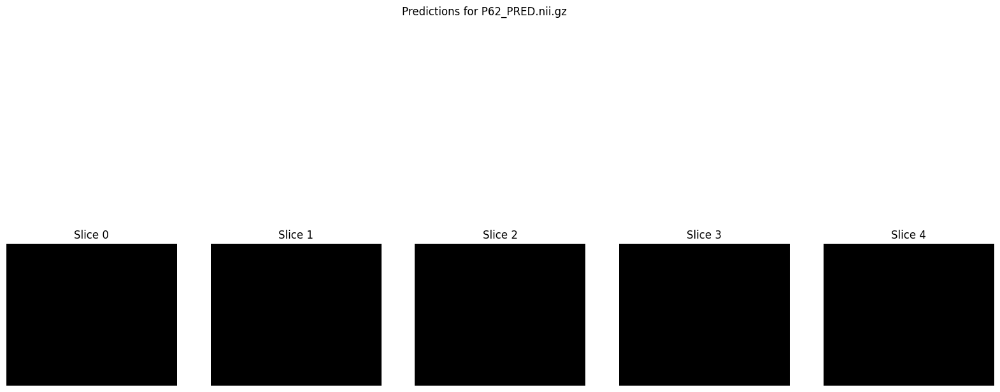

1/1 [==============================] - 0s 58ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSResnet34_110_05/P63_PRED.nii.gz


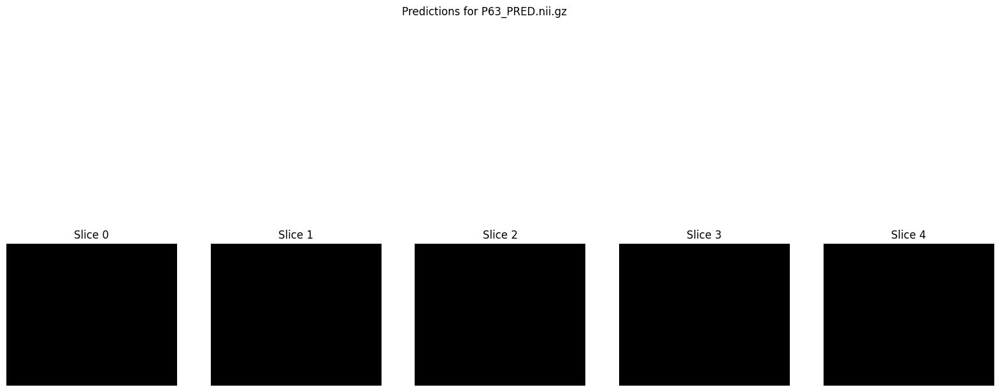

1/1 [==============================] - 0s 55ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSResnet34_110_05/P64_PRED.nii.gz


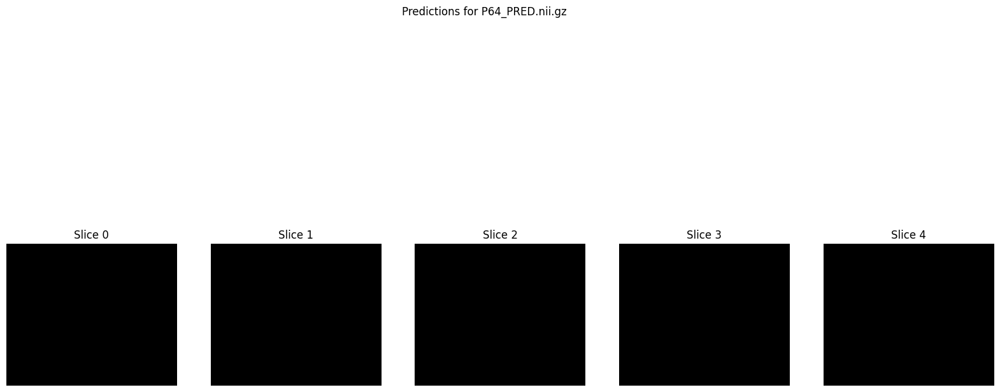

1/1 [==============================] - 0s 57ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSResnet34_110_05/P65_PRED.nii.gz


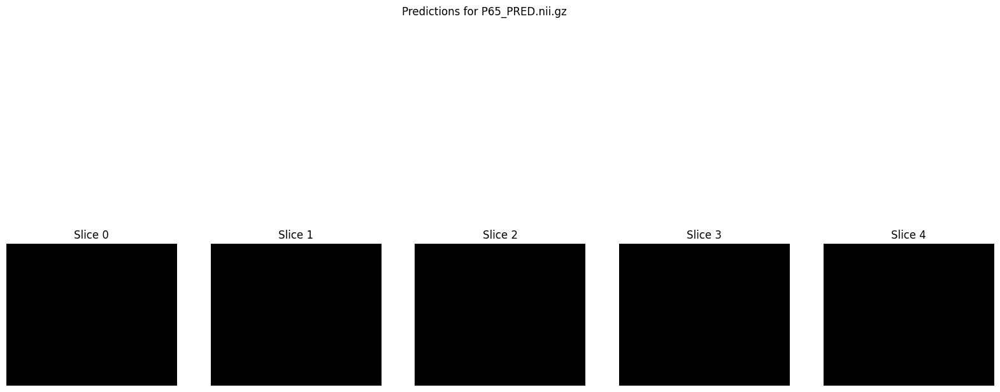

1/1 [==============================] - 0s 55ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSResnet34_110_05/P66_PRED.nii.gz


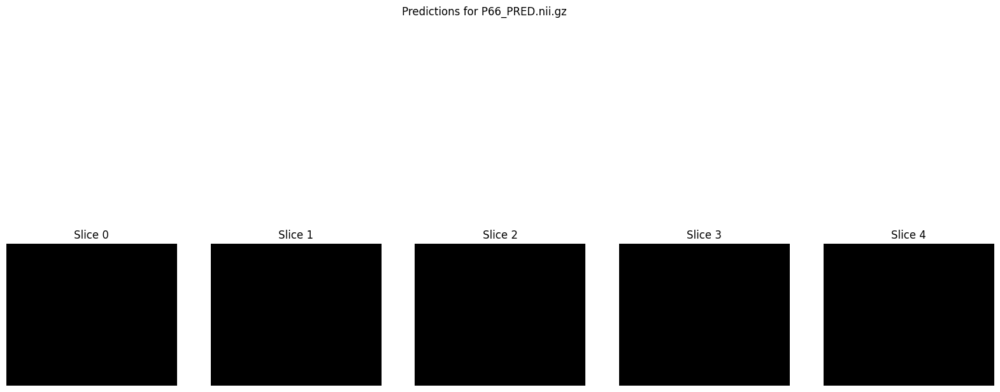

1/1 [==============================] - 0s 56ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSResnet34_110_05/P67_PRED.nii.gz


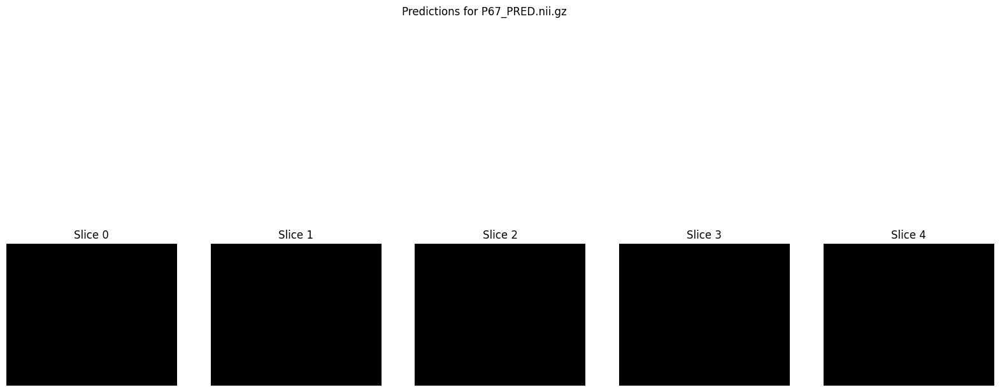

1/1 [==============================] - 0s 58ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSResnet34_110_05/P68_PRED.nii.gz


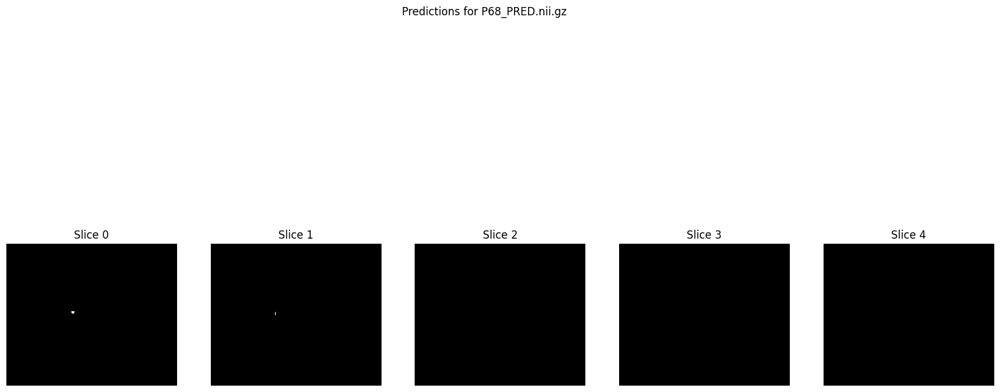

1/1 [==============================] - 0s 56ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSResnet34_110_05/P70_PRED.nii.gz


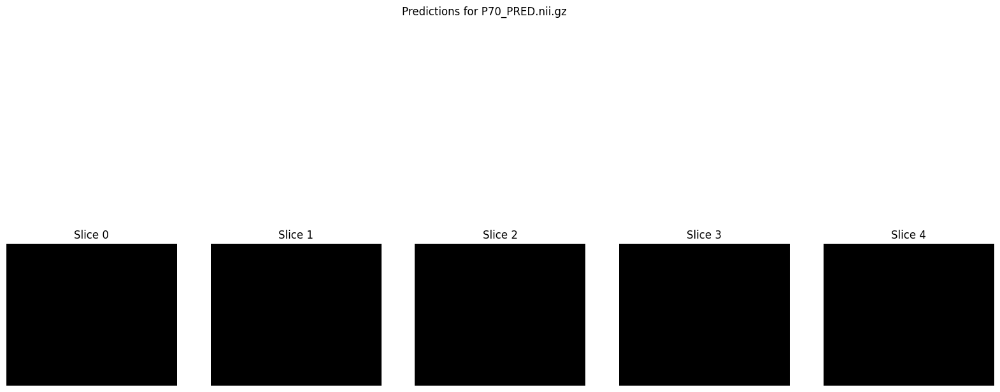

1/1 [==============================] - 0s 56ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSResnet34_110_05/P71_PRED.nii.gz


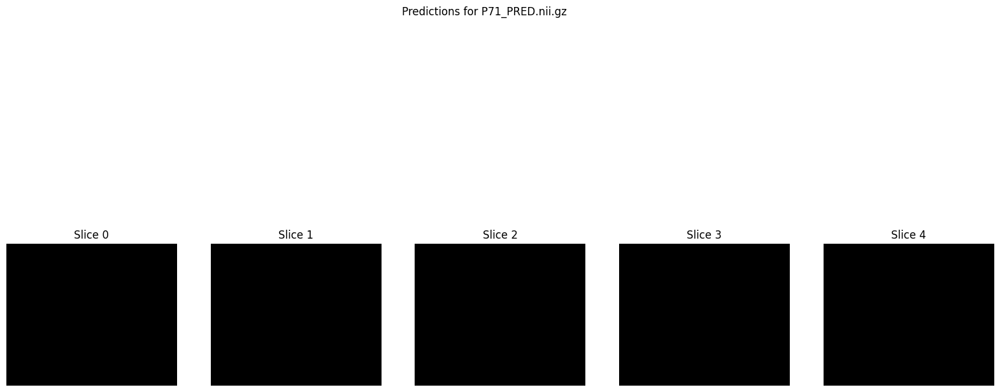

1/1 [==============================] - 0s 57ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSResnet34_110_05/P72_PRED.nii.gz


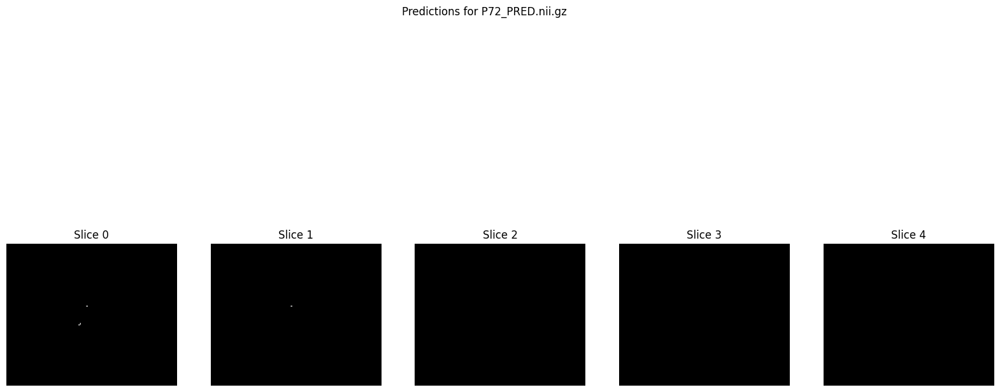

1/1 [==============================] - 0s 58ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSResnet34_110_05/P73_PRED.nii.gz


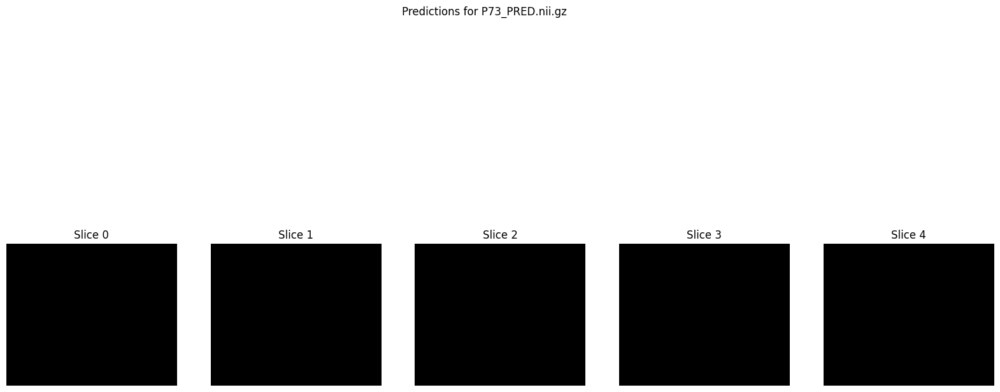

1/1 [==============================] - 0s 57ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSResnet34_110_05/P74_PRED.nii.gz


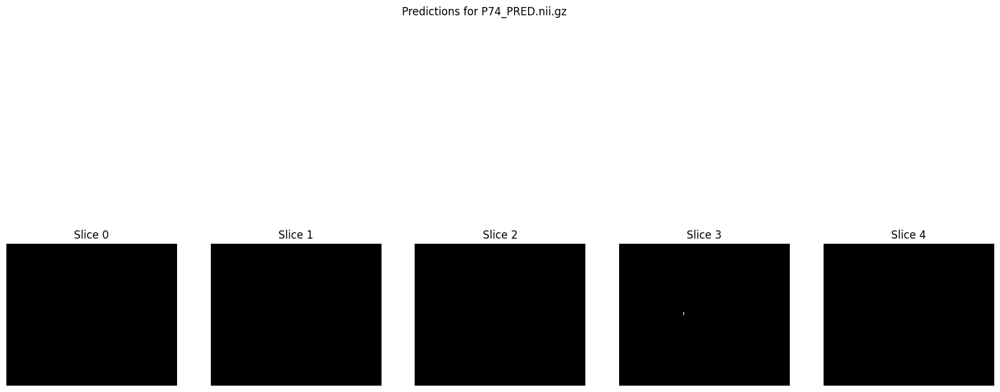

1/1 [==============================] - 0s 54ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSResnet34_110_05/P75_PRED.nii.gz


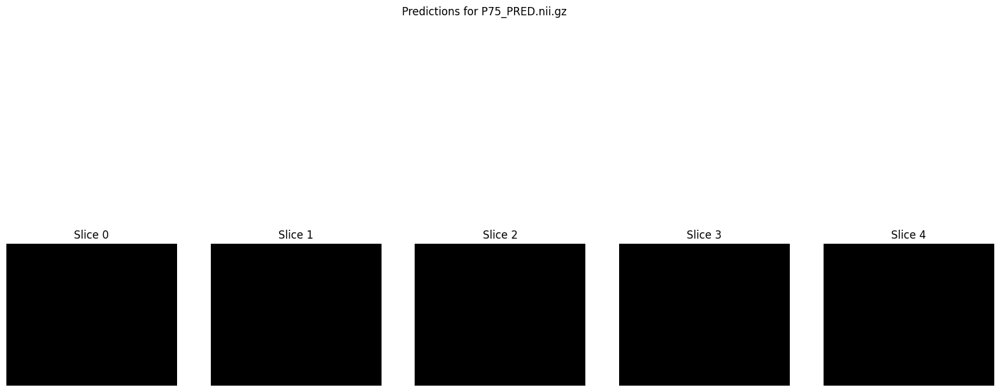

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSResnet34_110_05'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

def predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice = (pred_slice > threshold).astype(np.float32)  # Apply the threshold
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Ensure predictions are binary
    prediction = (prediction > 0.5).astype(np.float32)  # Apply a second threshold to make sure it's binary

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save prediction as NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir, threshold=0.5)  # Start with threshold 0.5

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()


1/1 [==============================] - 0s 70ms/step
Saved prediction for P69 to /content/drive/MyDrive/MASKSResnet34_110/P69_PRED.nii.gz


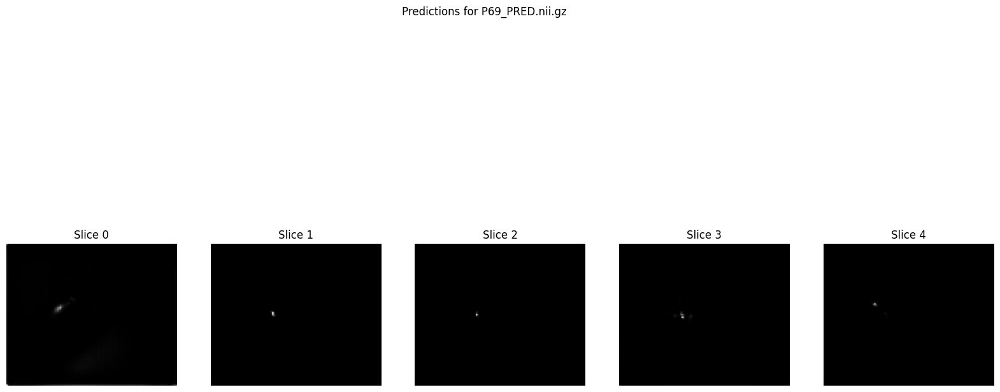

1/1 [==============================] - 0s 81ms/step
Saved prediction for P54 to /content/drive/MyDrive/MASKSResnet34_110/P54_PRED.nii.gz


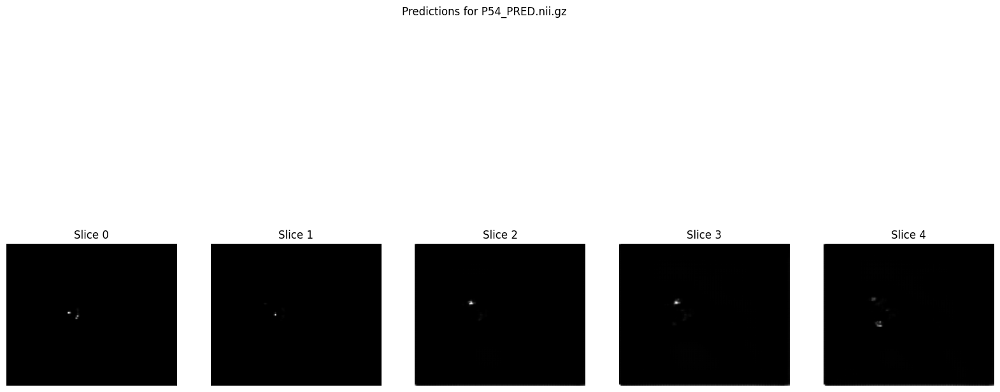

1/1 [==============================] - 0s 76ms/step
Saved prediction for P55 to /content/drive/MyDrive/MASKSResnet34_110/P55_PRED.nii.gz


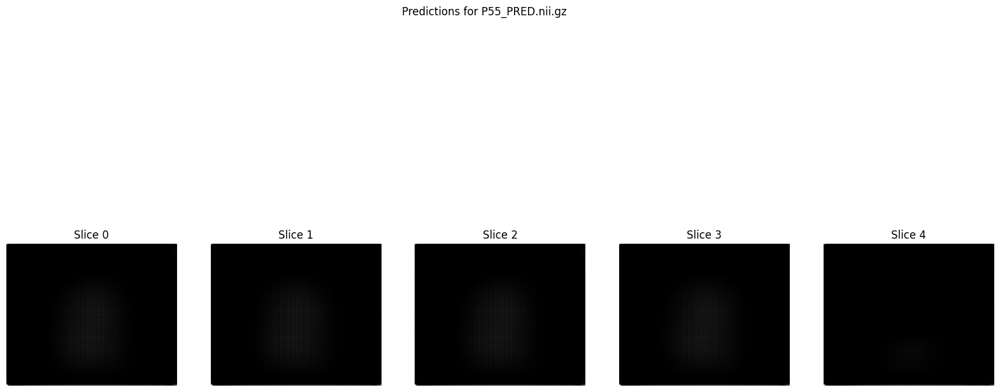

1/1 [==============================] - 0s 71ms/step
Saved prediction for P56 to /content/drive/MyDrive/MASKSResnet34_110/P56_PRED.nii.gz


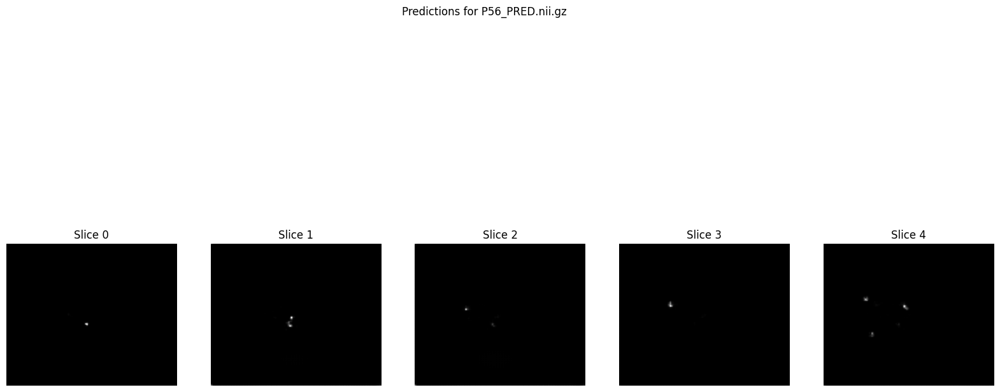

1/1 [==============================] - 0s 74ms/step
Saved prediction for P57 to /content/drive/MyDrive/MASKSResnet34_110/P57_PRED.nii.gz


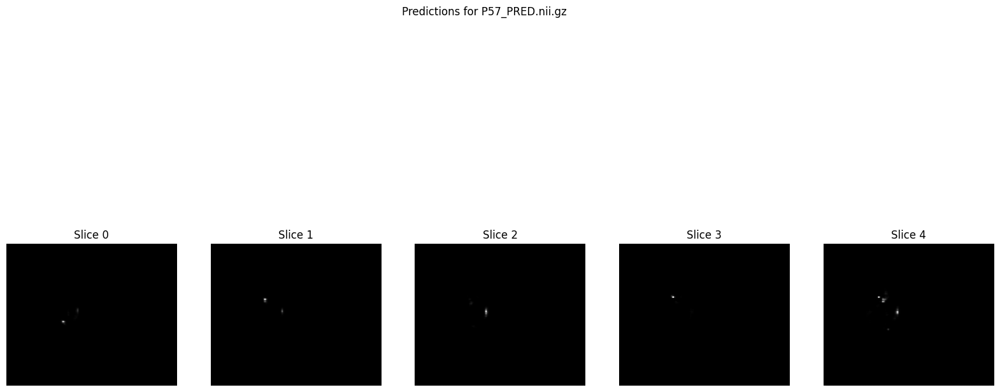

1/1 [==============================] - 0s 71ms/step
Saved prediction for P58 to /content/drive/MyDrive/MASKSResnet34_110/P58_PRED.nii.gz


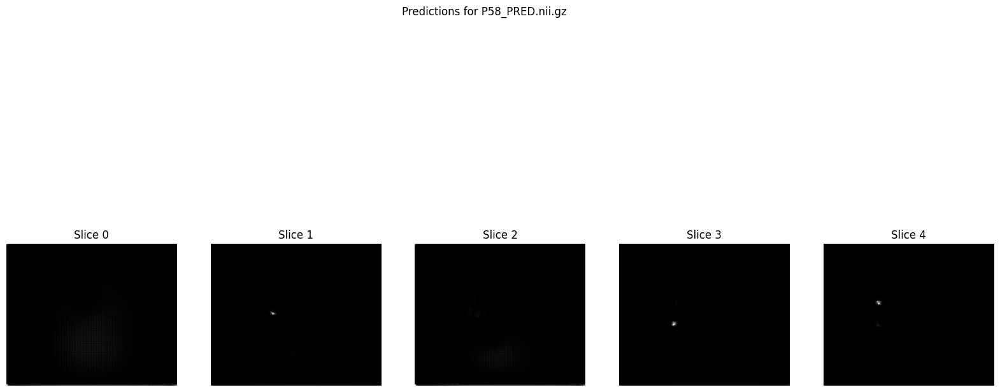

1/1 [==============================] - 0s 71ms/step
Saved prediction for P59 to /content/drive/MyDrive/MASKSResnet34_110/P59_PRED.nii.gz


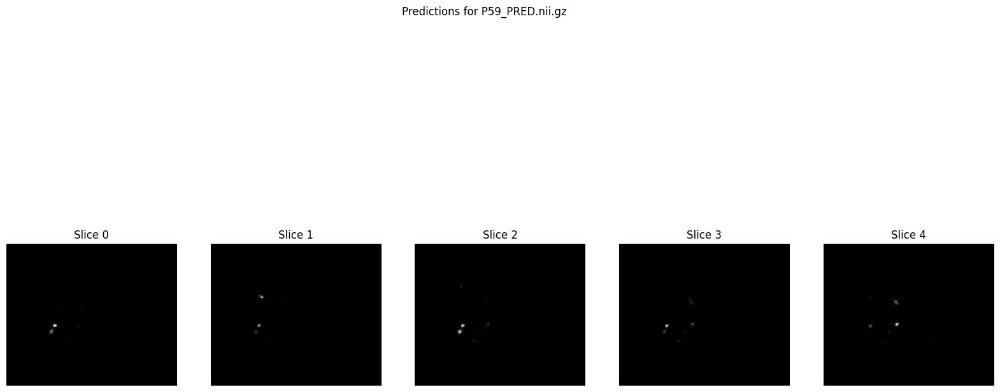

1/1 [==============================] - 0s 69ms/step
Saved prediction for P60 to /content/drive/MyDrive/MASKSResnet34_110/P60_PRED.nii.gz


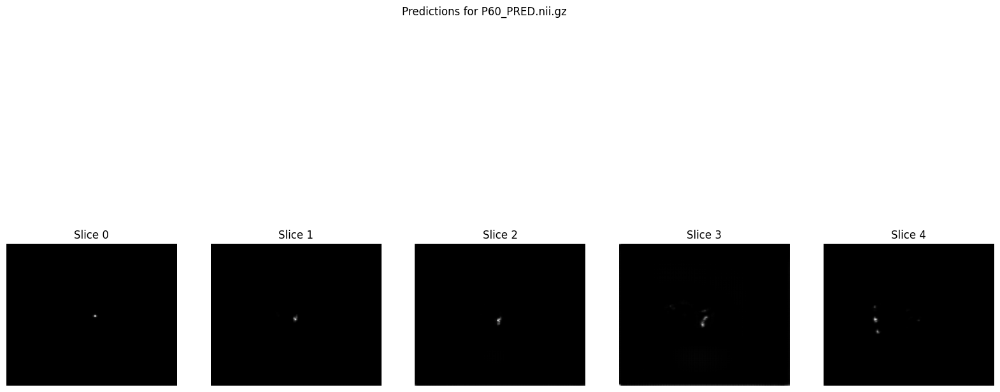

1/1 [==============================] - 0s 78ms/step
Saved prediction for P61 to /content/drive/MyDrive/MASKSResnet34_110/P61_PRED.nii.gz


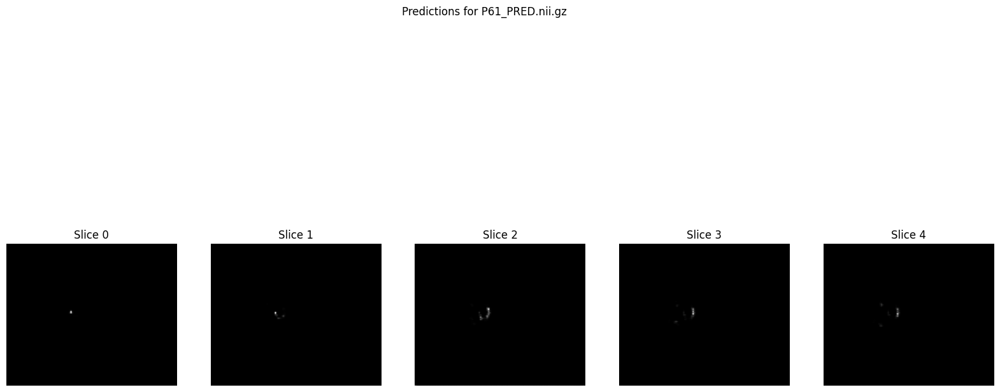

1/1 [==============================] - 0s 69ms/step
Saved prediction for P62 to /content/drive/MyDrive/MASKSResnet34_110/P62_PRED.nii.gz


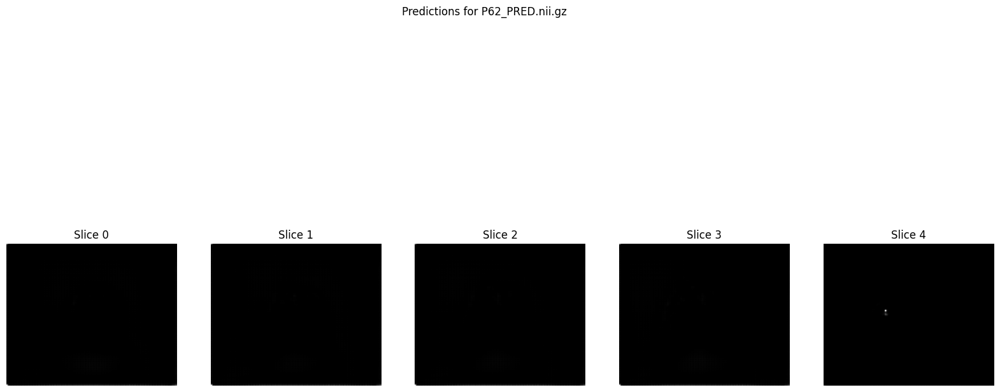

1/1 [==============================] - 0s 72ms/step
Saved prediction for P63 to /content/drive/MyDrive/MASKSResnet34_110/P63_PRED.nii.gz


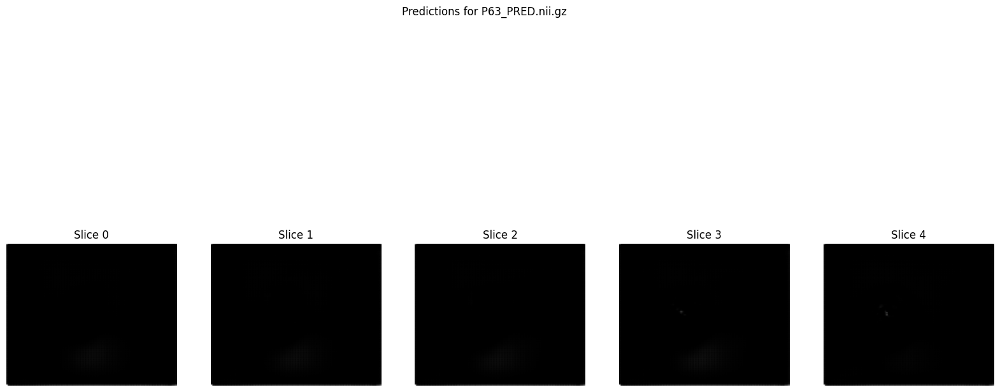

1/1 [==============================] - 0s 69ms/step
Saved prediction for P64 to /content/drive/MyDrive/MASKSResnet34_110/P64_PRED.nii.gz


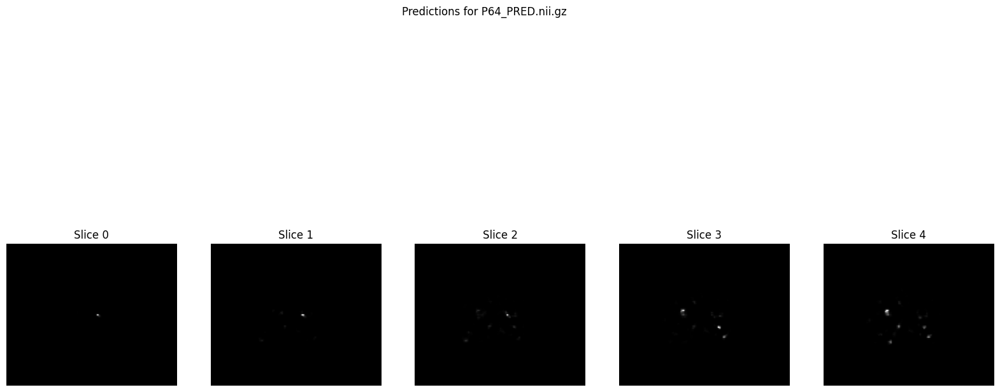

1/1 [==============================] - 0s 72ms/step
Saved prediction for P65 to /content/drive/MyDrive/MASKSResnet34_110/P65_PRED.nii.gz


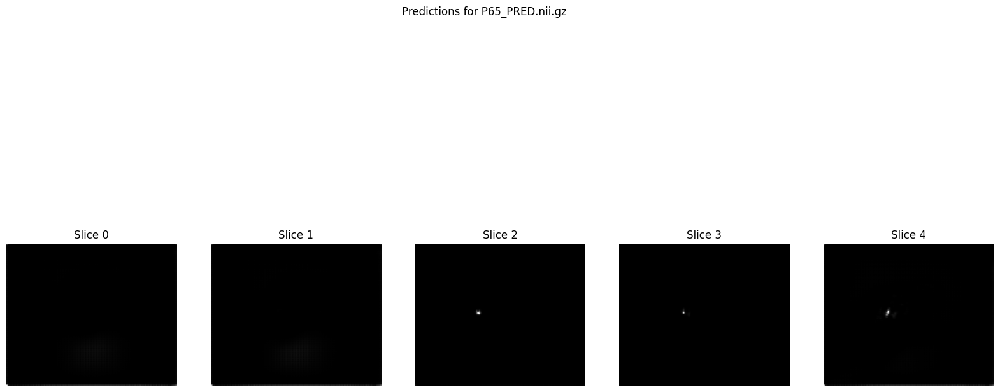

1/1 [==============================] - 0s 69ms/step
Saved prediction for P66 to /content/drive/MyDrive/MASKSResnet34_110/P66_PRED.nii.gz


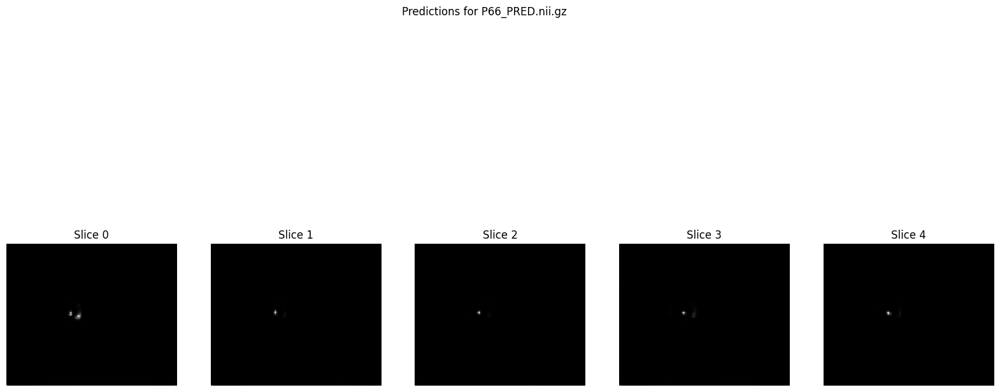

1/1 [==============================] - 0s 69ms/step
Saved prediction for P67 to /content/drive/MyDrive/MASKSResnet34_110/P67_PRED.nii.gz


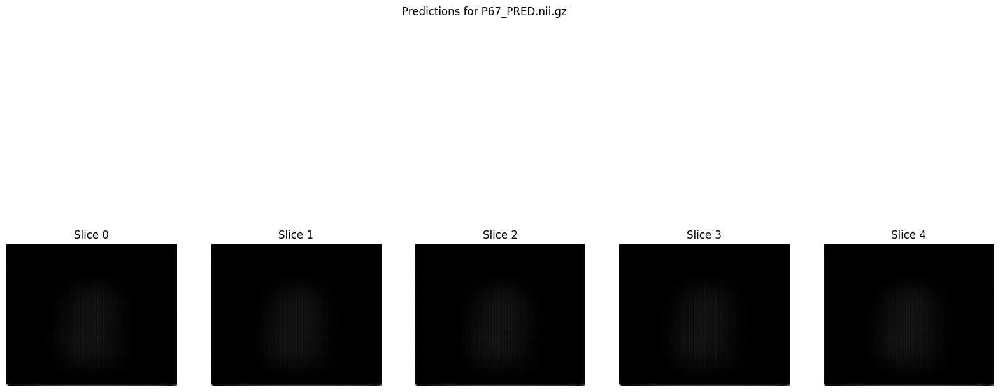

1/1 [==============================] - 0s 78ms/step
Saved prediction for P68 to /content/drive/MyDrive/MASKSResnet34_110/P68_PRED.nii.gz


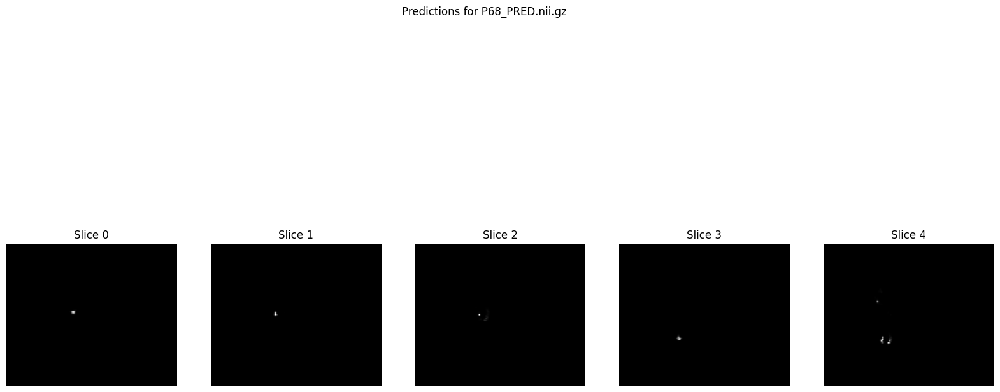

1/1 [==============================] - 0s 68ms/step
Saved prediction for P70 to /content/drive/MyDrive/MASKSResnet34_110/P70_PRED.nii.gz


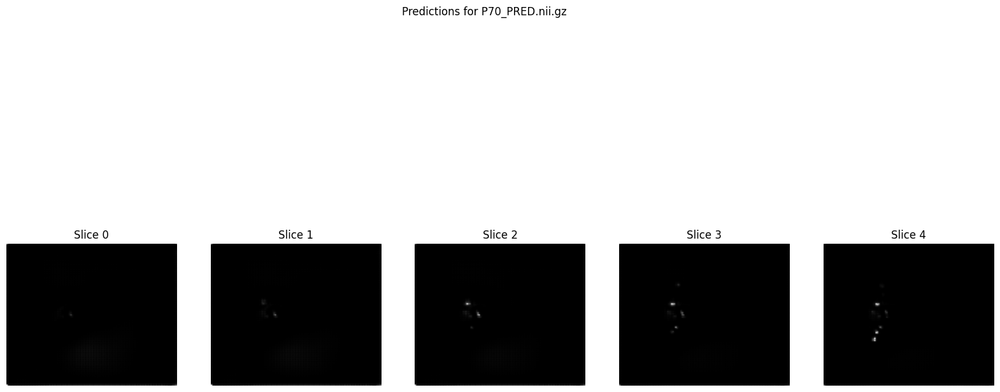

1/1 [==============================] - 0s 72ms/step
Saved prediction for P71 to /content/drive/MyDrive/MASKSResnet34_110/P71_PRED.nii.gz


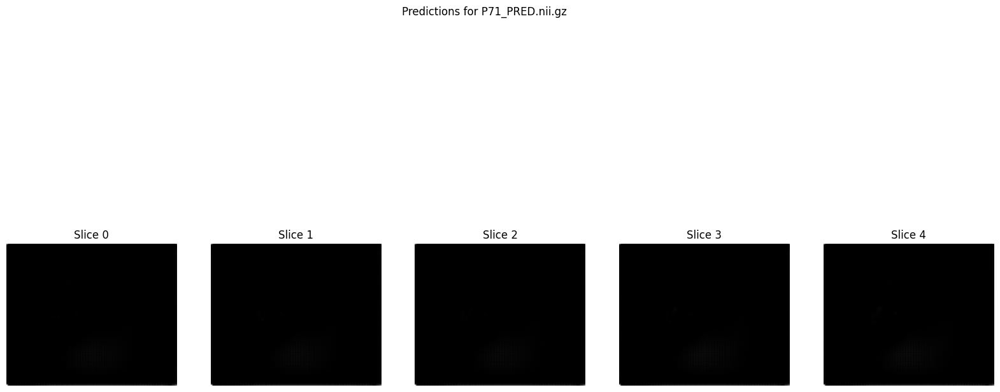

1/1 [==============================] - 0s 76ms/step
Saved prediction for P72 to /content/drive/MyDrive/MASKSResnet34_110/P72_PRED.nii.gz


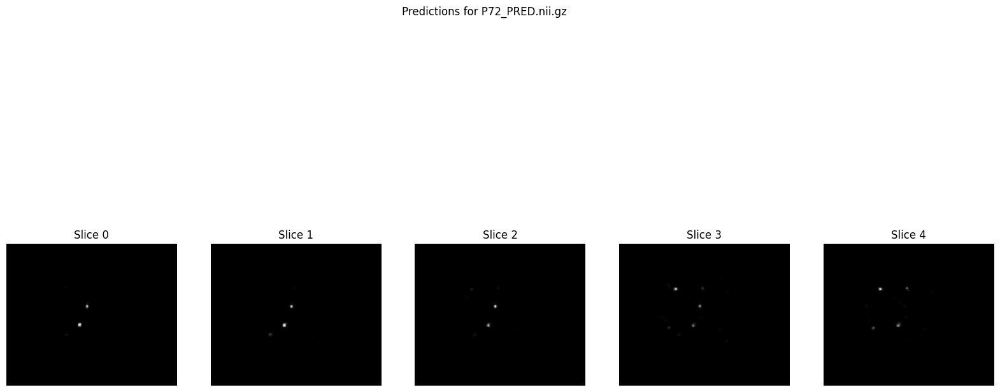

1/1 [==============================] - 0s 75ms/step
Saved prediction for P73 to /content/drive/MyDrive/MASKSResnet34_110/P73_PRED.nii.gz


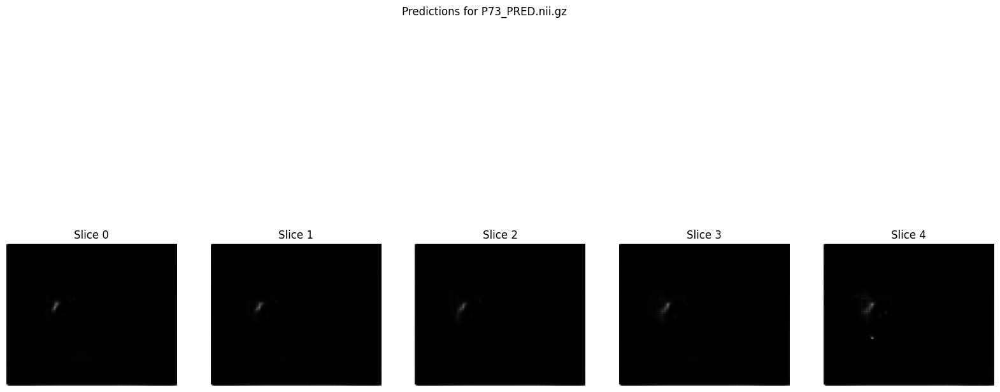

1/1 [==============================] - 0s 71ms/step
Saved prediction for P74 to /content/drive/MyDrive/MASKSResnet34_110/P74_PRED.nii.gz


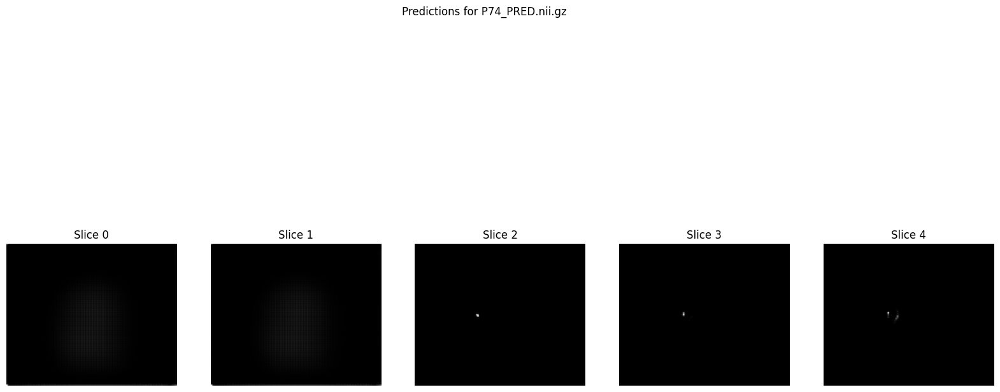

1/1 [==============================] - 0s 74ms/step
Saved prediction for P75 to /content/drive/MyDrive/MASKSResnet34_110/P75_PRED.nii.gz


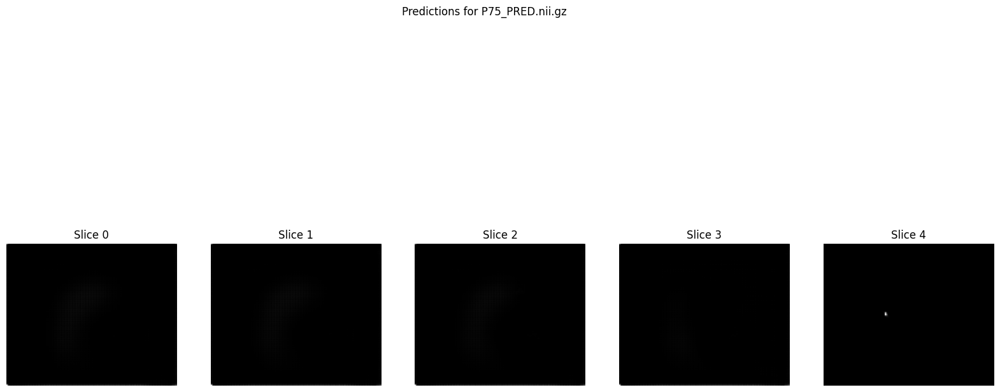

In [ ]:
# Load the model with the saved checkpoint
checkpoint_filepath = './2D3Dunet_checkpointResnet34/2D3Dunet_checkpoint_110.h5'
model = load_model(checkpoint_filepath, custom_objects={'dice_coefficient': dice_coefficient, 'loss': weighted_binary_crossentropy([1.0, 10.0])})

# Create the output directory if it doesn't exist
output_dir = './MASKSResnet34_110'
if not os.path.exists(output_dir):
    os.makedirs(output_dir)

def load_nifti_image(file_path):
    return nib.load(file_path).get_fdata()

def preprocess_input(t2_image, flair_image, target_size=(128, 128)):
    # Resize images
    t2_image_resized = resize(t2_image, target_size, mode='reflect', anti_aliasing=True)
    flair_image_resized = resize(flair_image, target_size, mode='reflect', anti_aliasing=True)
    # Stack channels
    combined_image = np.stack((t2_image_resized, flair_image_resized), axis=-1)
    # Normalize
    max_val = np.max(combined_image)
    if max_val != 0:
        combined_image = combined_image / max_val
    else:
        print("Warning: Maximum value of combined_image is zero. Skipping division.")

    # Handle potential NaN or infinity values
    combined_image = np.nan_to_num(combined_image, nan=0.0, posinf=1.0, neginf=0.0)

    return combined_image

def predict_and_save(patient_id, t2_path, flair_path, output_dir, original_shape=(182, 218, 182)):
    t2_image = load_nifti_image(t2_path)
    flair_image = load_nifti_image(flair_path)

    assert t2_image.shape == flair_image.shape == original_shape, f"Input images must be of shape {original_shape}"

    # Predict for each axial slice
    prediction = np.zeros_like(t2_image)
    for i in range(t2_image.shape[2]):
        t2_slice = t2_image[:, :, i]
        flair_slice = flair_image[:, :, i]
        combined_slice = preprocess_input(t2_slice, flair_slice)
        combined_slice = np.expand_dims(combined_slice, axis=0)  # Add batch dimension
        pred_slice = model.predict(combined_slice)
        pred_slice_resized = resize(pred_slice.squeeze(), t2_slice.shape, mode='reflect', anti_aliasing=True)
        prediction[:, :, i] = pred_slice_resized

    # Handle potential NaNs and infinite values in the prediction
    if np.any(np.isnan(prediction)) or np.any(np.isinf(prediction)):
        print(f"Found NaNs or Infs in prediction for {patient_id}. Replacing with zeros.")
        prediction = np.nan_to_num(prediction, nan=0.0, posinf=0.0, neginf=0.0)

    # Save the prediction as a NIFTI file
    pred_nifti = nib.Nifti1Image(prediction, affine=np.eye(4))
    output_path = os.path.join(output_dir, f'{patient_id}_PRED.nii.gz')
    nib.save(pred_nifti, output_path)
    print(f'Saved prediction for {patient_id} to {output_path}')

    return prediction

# Define test data paths and output directory
test_data = [
    ('P69', './test/P69/P69_T2.nii.gz', './test/P69/P69_FLAIR.nii.gz'),
    ('P54', './test/P54/P54_T2.nii.gz', './test/P54/P54_FLAIR.nii.gz'),
    ('P55', './test/P55/P55_T2.nii.gz', './test/P55/P55_FLAIR.nii.gz'),
    ('P56', './test/P56/P56_T2.nii.gz', './test/P56/P56_FLAIR.nii.gz'),
    ('P57', './test/P57/P57_T2.nii.gz', './test/P57/P57_FLAIR.nii.gz'),
    ('P58', './test/P58/P58_T2.nii.gz', './test/P58/P58_FLAIR.nii.gz'),
    ('P59', './test/P59/P59_T2.nii.gz', './test/P59/P59_FLAIR.nii.gz'),
    ('P60', './test/P60/P60_T2.nii.gz', './test/P60/P60_FLAIR.nii.gz'),
    ('P61', './test/P61/P61_T2.nii.gz', './test/P61/P61_FLAIR.nii.gz'),
    ('P62', './test/P62/P62_T2.nii.gz', './test/P62/P62_FLAIR.nii.gz'),
    ('P63', './test/P63/P63_T2.nii.gz', './test/P63/P63_FLAIR.nii.gz'),
    ('P64', './test/P64/P64_T2.nii.gz', './test/P64/P64_FLAIR.nii.gz'),
    ('P65', './test/P65/P65_T2.nii.gz', './test/P65/P65_FLAIR.nii.gz'),
    ('P66', './test/P66/P66_T2.nii.gz', './test/P66/P66_FLAIR.nii.gz'),
    ('P67', './test/P67/P67_T2.nii.gz', './test/P67/P67_FLAIR.nii.gz'),
    ('P68', './test/P68/P68_T2.nii.gz', './test/P68/P68_FLAIR.nii.gz'),
    ('P70', './test/P70/P70_T2.nii.gz', './test/P70/P70_FLAIR.nii.gz'),
    ('P71', './test/P71/P71_T2.nii.gz', './test/P71/P71_FLAIR.nii.gz'),
    ('P72', './test/P72/P72_T2.nii.gz', './test/P72/P72_FLAIR.nii.gz'),
    ('P73', './test/P73/P73_T2.nii.gz', './test/P73/P73_FLAIR.nii.gz'),
    ('P74', './test/P74/P74_T2.nii.gz', './test/P74/P74_FLAIR.nii.gz'),
    ('P75', './test/P75/P75_T2.nii.gz', './test/P75/P75_FLAIR.nii.gz')
]

# Perform predictions and plot results
for patient_id, t2_path, flair_path in test_data:
    prediction = predict_and_save(patient_id, t2_path, flair_path, output_dir)

    # Plot a few slices to inspect the predictions
    plt.figure(figsize=(20, 10))
    plt.suptitle(f'Predictions for {patient_id}_PRED.nii.gz')
    for i in range(5):
        plt.subplot(1, 5, i + 1)
        plt.imshow(prediction[:, :, i], cmap='gray')
        plt.title(f'Slice {i}')
        plt.axis('off')
    plt.show()


In [ ]:
# Load the predicted .nii.gz file
pred_file_path = './MASKSResnet34_110/P69_PRED.nii.gz'
pred_nii = nib.load(pred_file_path)

pred_data = pred_nii.get_fdata()

print(f"Shape of the predicted data: {pred_data.shape}")

Shape of the predicted data: (182, 218, 182)


In [ ]:
%cd ./DICE_EVAL

/content/drive/MyDrive/DICE_EVAL


In [ ]:
!python evaluate.py --dir_groundtruth /DICE_EVAL/test_MASK_GT --dir_prediction /DICE_EVAL/test_MASK_PRED

MEAN DICE: 0.6524359785540644
